# 데이터 로드 및 전처리

## Data 불러오기

In [ ]:
from google.colab import drive
import zipfile
import os

# 구글 드라이브를 마운트합니다.
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# zip 파일 경로
zip_file_path = '/content/drive/MyDrive/BUU-LSPINE_400.zip'

# 압축을 풀 폴더 경로
extract_folder = '/content/spine_data_400'

# 압축 파일 열기 및 추출
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extract_folder)

In [ ]:
# 추출된 BUU-LSPINE_400 폴더로 들어가기
buu_folder = os.path.join(extract_folder, 'BUU-LSPINE_400')

# BUU-LSPINE_400 폴더 안의 파일 및 폴더 확인
extracted_files = os.listdir(buu_folder)
print(f"BUU-LSPINE_400 폴더 안의 파일 및 폴더: {extracted_files}")

BUU-LSPINE_400 폴더 안의 파일 및 폴더: ['LA', 'BUU-LSPINE_400_report.xlsx', 'AP']


In [ ]:
import glob
from PIL import Image
import pandas as pd

# AP 폴더 경로와 LA 폴더 경로 설정
ap_folder = os.path.join(buu_folder, 'AP')
la_folder = os.path.join(buu_folder, 'LA')

# AP 폴더 안의 이미지 파일 경로만 가져오기 (예: jpg, png 파일)
ap_images = glob.glob(os.path.join(ap_folder, '*.jpg')) + glob.glob(os.path.join(ap_folder, '*.png'))
la_images = glob.glob(os.path.join(la_folder, '*.jpg')) + glob.glob(os.path.join(la_folder, '*.png'))

print(f"AP 이미지 개수: {len(ap_images)}")
print(f"LA 이미지 개수: {len(la_images)}")

AP 이미지 개수: 400
LA 이미지 개수: 400


In [ ]:
!pip install openpyxl

In [ ]:
excel_file_path = os.path.join(buu_folder, 'BUU-LSPINE_400_report.xlsx')

# 'pos_AP_BUU-LSPINE_400' 불러오기
ap_sheet = 'pos_AP_BUU-LSPINE_400'
ap_df = pd.read_excel(excel_file_path, sheet_name=ap_sheet)

# 데이터 확인
print(f"Sheet '{ap_sheet}'의 데이터:")
print(ap_df.head())  # 처음 5개 행을 확인

Sheet 'pos_AP_BUU-LSPINE_400'의 데이터:
   Column1      filename gender  age type     L1a_1c    L1a_1r    L1a_2c  \
0        0  0001-F-037Y0      F   37   AP   876.2222  167.0618  1111.472   
1        1  0003-F-013Y0      F   13   AP   995.1376  915.0048  1188.762   
2        2  0004-F-010Y0      F   10   AP  1030.5450  262.7610  1235.536   
3        3  0005-F-025Y0      F   25   AP  1065.6940  352.9687  1266.615   
4        4  0006-F-031Y0      F   31   AP   856.3824  263.6143  1077.760   

     L1a_2r     L1b_1c  ...     L5a_2r    L5b_1c     L5b_1r    L5b_2c  \
0  168.7665   865.9939  ...   980.1932  766.5613  1163.9790  1129.421   
1  877.8941  1013.2270  ...  1628.5880  982.8820  1770.2740  1266.552   
2  255.3068  1026.2910  ...   869.5652  915.9337   951.9692  1168.380   
3  324.4597  1079.2700  ...  1043.5540  886.8709  1190.9260  1166.336   
4  224.2906   878.2288  ...   926.3470  880.4554  1018.9140  1158.821   

      L5b_2r  L1b_d  L2b_d  L3b_d  L4b_d  L5b_d  
0  1157.6960      

## 시각화

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

ima_path = '/content/spine_data_400/BUU-LSPINE_400/AP/0001-F-037Y0.jpg'
c_path = '/content/spine_data_400/BUU-LSPINE_400/AP/0001-F-037Y0.csv'

# 이미지 불러오기
image = Image.open(ima_path)

# CSV 파일에서 좌표 데이터 불러오기
# 해당 파일은 탭('\t')으로 구분된 데이터라고 가정
df1 = pd.read_csv(c_path, sep=',', header=None)
print(df1.head())

          0         1         2         3  4
0  876.2222  167.0618  1111.472  168.7665  0
1  865.9939  313.6671  1119.996  313.6671  0
2  870.8508  344.4474  1116.587  351.1707  0
3  847.6437  498.0999  1119.997  511.2078  0
4  842.3262  553.4754  1108.814  557.2025  0


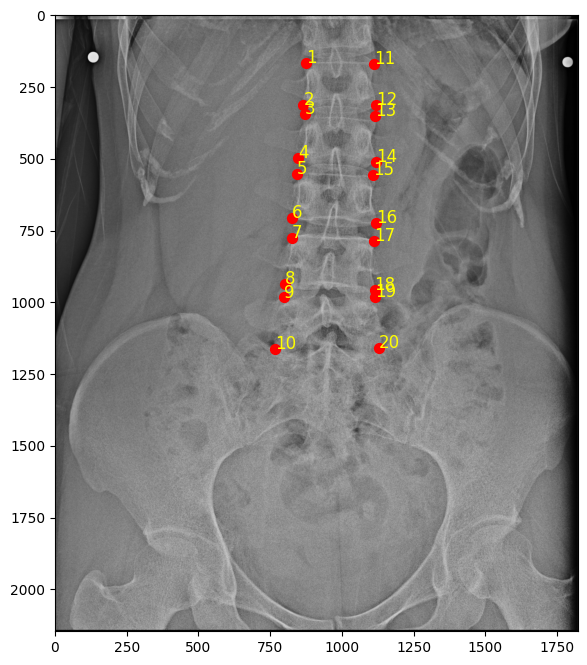

In [ ]:
# 첫 번째와 두 번째 열은 (A, B) 좌표, 세 번째와 네 번째 열은 (C, D) 좌표
x_coords = list(df1[0]) + list(df1[2])  # (A 좌표들 + C 좌표들)
y_coords = list(df1[1]) + list(df1[3])  # (B 좌표들 + D 좌표들)

# 이미지 시각화
plt.figure(figsize=(8, 8))
plt.imshow(image)

# 이미지 위에 좌표 찍기 (빨간색 점으로 시각화)
plt.scatter(x_coords, y_coords, c='red', s=50)  # s는 점 크기, c는 색상

# 좌표 확인을 위해 번호 표시
for i, (x, y) in enumerate(zip(x_coords, y_coords)):
    plt.text(x, y, str(i+1), color="yellow", fontsize=12)

# 시각화 결과 출력
plt.show()

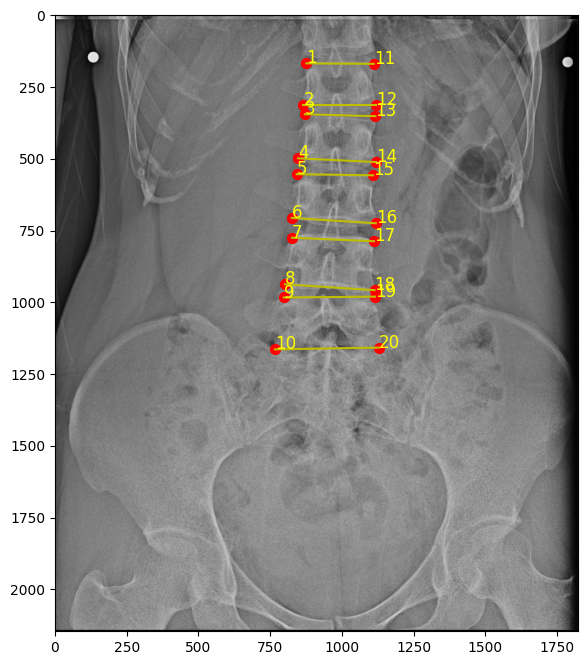

In [ ]:
# 이미지 시각화
plt.figure(figsize=(8, 8))
plt.imshow(image)

# 좌표를 번호로 표시
for i, (x, y) in enumerate(zip(x_coords, y_coords)):
    plt.text(x, y, str(i+1), color="yellow", fontsize=12)

for i in range(10):  # 앞의 10개의 좌표를 1-11, 2-12 형식으로 연결
    plt.plot([x_coords[i], x_coords[i+10]], [y_coords[i], y_coords[i+10]], 'y-')  # 'y-'는 노란색 선

# 이미지 위에 좌표 찍기 (빨간색 점으로 시각화)
plt.scatter(x_coords, y_coords, c='red', s=50)  # s는 점 크기, c는 색상

# 시각화 결과 출력
plt.show()

질병이 있는 환자의 사진으로 시각화 진행

In [ ]:
import matplotlib.pyplot as plt

image_path = '/content/spine_data_400/BUU-LSPINE_400/AP/0277-F-050Y0.jpg'
csv_path = '/content/spine_data_400/BUU-LSPINE_400/AP/0277-F-050Y0.csv'

# 이미지 불러오기
image = Image.open(image_path)

# CSV 파일에서 좌표 데이터 불러오기
# 해당 파일은 탭('\t')으로 구분된 데이터라고 가정
df = pd.read_csv(csv_path, sep=',', header=None)
print(df.head())

          0          1         2         3  4
0  852.0241   475.1850  1145.223  530.3322  0
1  795.9578   652.5751  1124.084  716.9135  0
2  782.1710   770.2225  1112.135  731.6194  0
3  795.0387   963.2377  1137.870  919.1199  0
4  845.5903  1050.5540  1181.069  935.6641  0


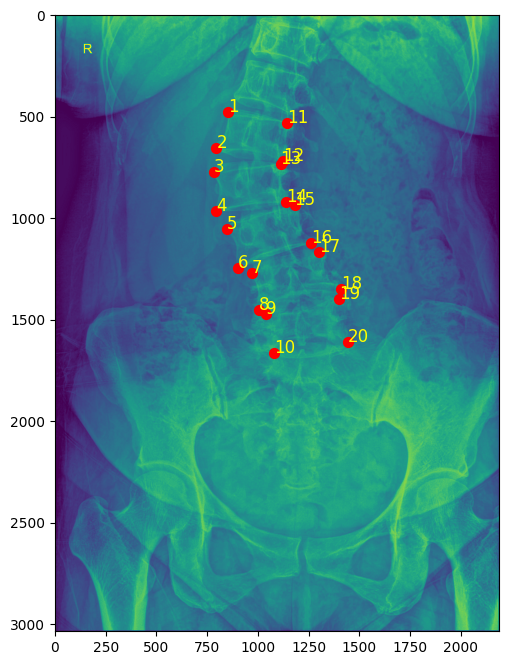

In [ ]:
# 첫 번째와 두 번째 열은 (A, B) 좌표, 세 번째와 네 번째 열은 (C, D) 좌표
x_coords = list(df[0]) + list(df[2])  # (A 좌표들 + C 좌표들)
y_coords = list(df[1]) + list(df[3])  # (B 좌표들 + D 좌표들)

# 이미지 시각화
plt.figure(figsize=(8, 8))
plt.imshow(image)

# 이미지 위에 좌표 찍기 (빨간색 점으로 시각화)
plt.scatter(x_coords, y_coords, c='red', s=50)  # s는 점 크기, c는 색상

# 좌표 확인을 위해 번호 표시
for i, (x, y) in enumerate(zip(x_coords, y_coords)):
    plt.text(x, y, str(i+1), color="yellow", fontsize=12)

# 시각화 결과 출력
plt.show()

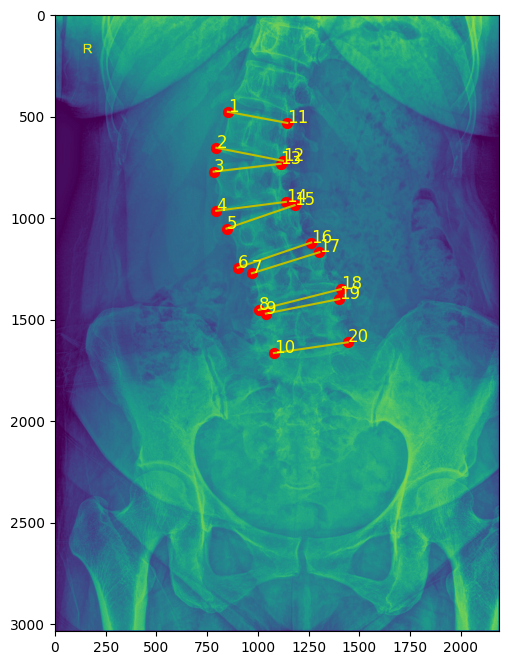

In [ ]:
# 이미지 시각화
plt.figure(figsize=(8, 8))
plt.imshow(image)

# 좌표를 번호로 표시
for i, (x, y) in enumerate(zip(x_coords, y_coords)):
    plt.text(x, y, str(i+1), color="yellow", fontsize=12)

for i in range(10):  # 앞의 10개의 좌표를 1-11, 2-12 형식으로 연결
    plt.plot([x_coords[i], x_coords[i+10]], [y_coords[i], y_coords[i+10]], 'y-')  # 'y-'는 노란색 선

# 이미지 위에 좌표 찍기 (빨간색 점으로 시각화)
plt.scatter(x_coords, y_coords, c='red', s=50)  # s는 점 크기, c는 색상

# 시각화 결과 출력
plt.show()

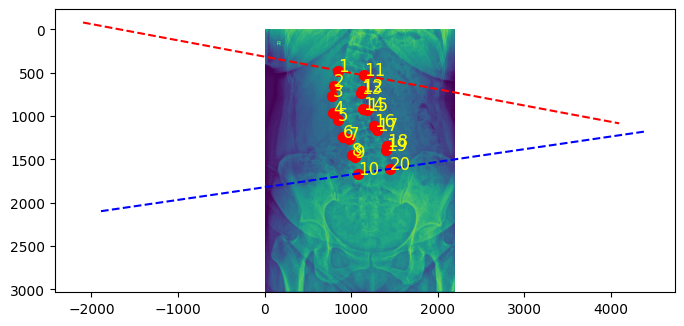

In [ ]:
import numpy as np
# 직선 연장 함수
def extend_line(x1, y1, x2, y2, length=3000):
    # 직선의 기울기 계산
    slope = (y2 - y1) / (x2 - x1)
    # 직선 연장
    new_x1 = x1 - length / np.sqrt(1 + slope**2)
    new_y1 = y1 - slope * (x1 - new_x1)
    new_x2 = x2 + length / np.sqrt(1 + slope**2)
    new_y2 = y2 + slope * (new_x2 - x2)
    return new_x1, new_y1, new_x2, new_y2

# 이미지 시각화
plt.figure(figsize=(8, 8))
plt.imshow(image)

# 좌표를 번호로 표시
for i, (x, y) in enumerate(zip(x_coords, y_coords)):
    plt.text(x, y, str(i+1), color="yellow", fontsize=12)

# 직선 연장 및 그리기
# 1-11 연결 (좌표는 0번째와 10번째)
x1_ext, y1_ext, x2_ext, y2_ext = extend_line(x_coords[0], y_coords[0], x_coords[10], y_coords[10])
plt.plot([x1_ext, x2_ext], [y1_ext, y2_ext], 'r--')  # 빨간색 점선으로 직선 연장

# 10-20 연결 (좌표는 9번째와 19번째)
x3_ext, y3_ext, x4_ext, y4_ext = extend_line(x_coords[9], y_coords[9], x_coords[19], y_coords[19])
plt.plot([x3_ext, x4_ext], [y3_ext, y4_ext], 'b--')  # 파란색 점선으로 직선 연장

# 좌표 찍기
plt.scatter(x_coords, y_coords, c='red', s=50)

# 시각화 결과 출력
plt.show()

In [ ]:
# 기울기 계산 함수
def calculate_slope(x1, y1, x2, y2):
    return (y2 - y1) / (x2 - x1)

# 직선 1 (1번과 11번)
slope1 = calculate_slope(x_coords[0], y_coords[0], x_coords[10], y_coords[10])

# 직선 2 (10번과 20번)
slope2 = calculate_slope(x_coords[9], y_coords[9], x_coords[19], y_coords[19])

# 두 직선 사이의 각도 계산
angle_radians = np.arctan(abs((slope1 - slope2) / (1 + slope1 * slope2)))
angle_degrees = np.degrees(angle_radians)

print(f"두 직선 사이의 각도: {angle_degrees:.2f}도")

두 직선 사이의 각도: 18.98도


In [ ]:
# 직선 1 (1번과 11번)
slope1 = calculate_slope(x_coords[0], y_coords[0], x_coords[10], y_coords[10])

# 직선 2 (5번과 15번)
slope2 = calculate_slope(x_coords[4], y_coords[4], x_coords[14], y_coords[14])

# 두 직선 사이의 각도 계산
angle_radians = np.arctan(abs((slope1 - slope2) / (1 + slope1 * slope2)))
angle_degrees = np.degrees(angle_radians)

print(f"두 직선 사이의 각도: {angle_degrees:.2f}도")

두 직선 사이의 각도: 29.56도


In [ ]:
# 모든 직선에 대해 수평선과의 각도를 계산
angles = []
for i in range(10):  # 1-11, 2-12, ... 10-20 형태로 직선을 연결
    slope = calculate_slope(x_coords[i], y_coords[i], x_coords[i + 10], y_coords[i + 10])
    angle_radians = np.arctan(slope)  # 기울기를 기반으로 수평선과의 각도 계산
    angle_degrees = np.degrees(angle_radians)  # 도(degree) 단위로 변환
    angles.append(angle_degrees)
    print(f"{i+1}-{i+11} 직선의 수평선 기준 각도: {angle_degrees:.2f}도")

1-11 직선의 수평선 기준 각도: 10.65도
2-12 직선의 수평선 기준 각도: 11.09도
3-13 직선의 수평선 기준 각도: -6.67도
4-14 직선의 수평선 기준 각도: -7.33도
5-15 직선의 수평선 기준 각도: -18.90도
6-16 직선의 수평선 기준 각도: -18.91도
7-17 직선의 수평선 기준 각도: -17.34도
8-18 직선의 수평선 기준 각도: -14.16도
9-19 직선의 수평선 기준 각도: -11.20도
10-20 직선의 수평선 기준 각도: -8.33도


In [ ]:
# 최대 및 최소 각도 계산
max_angle = max(angles)
min_angle = min(angles)

# 최대와 최소 각도의 차이 계산
angle_difference = max_angle - min_angle

# 결과 출력
print(f"\n최대 각도: {max_angle:.2f}도")
print(f"최소 각도: {min_angle:.2f}도")
print(f"최대 각도와 최소 각도의 차이: {angle_difference:.2f}도")


최대 각도: 11.09도
최소 각도: -18.91도
최대 각도와 최소 각도의 차이: 30.01도


In [ ]:
# 각도 차이 계산 (2개씩 차이 계산)
for i in range(0, 10, 2):
    angle_diff = abs(angles[i] - angles[i+1])
    print(f"요추 {i//2 + 1}번 각도차: {angle_diff:.2f}도")

요추 1번 각도차: 0.44도
요추 2번 각도차: 0.66도
요추 3번 각도차: 0.01도
요추 4번 각도차: 3.18도
요추 5번 각도차: 2.87도


요추마다 최대 각도 계산하면 좋을듯 하다

각 요추마다 각도차이를 계산하면 골절유무를 판단할 수 있지 않을까? - 확장성 논의 필요

## 각도 계산

In [ ]:
# 직선의 기울기 계산 함수
def calculate_slope(x1, y1, x2, y2):
    return (y2 - y1) / (x2 - x1)

# 모든 직선에 대해 수평선과의 각도를 계산하는 함수
def calculate_angles(x_coords, y_coords):
    angles = []
    for i in range(10):  # 1-11, 2-12, ... 10-20 형태로 직선을 연결
        slope = calculate_slope(x_coords[i], y_coords[i], x_coords[i + 10], y_coords[i + 10])
        angle_radians = np.arctan(slope)  # 기울기를 기반으로 수평선과의 각도 계산
        angle_degrees = np.degrees(angle_radians)  # 도(degree) 단위로 변환
        angles.append(angle_degrees)
    return angles

# CSV에서 좌표 데이터를 불러오는 함수
def read_csv_for_coordinates(c_path):
    df1 = pd.read_csv(c_path, sep=',', header=None)
    x_coords = list(df1[0]) + list(df1[2])  # (A 좌표들 + C 좌표들)
    y_coords = list(df1[1]) + list(df1[3])  # (B 좌표들 + D 좌표들)
    return x_coords, y_coords

# 모든 이미지 파일에 대해 각도를 계산하는 함수
def process_images_and_calculate_angles(image_folder, csv_folder):
    result = {}
    for filename in os.listdir(image_folder):
        if filename.endswith(".jpg"):
            img_path = os.path.join(image_folder, filename)
            csv_name = filename.replace('.jpg', '.csv')
            c_path = os.path.join(csv_folder, csv_name)

            if os.path.exists(c_path):  # CSV 파일이 존재할 때만 처리
                x_coords, y_coords = read_csv_for_coordinates(c_path)
                angles = calculate_angles(x_coords, y_coords)
                max_angle = max(angles)
                min_angle = min(angles)
                angle_difference = max_angle - min_angle

                # 결과 저장 (파일 이름: 각도)
                result[filename] = angle_difference
            else:
                print(f"CSV 파일이 존재하지 않습니다: {c_path}")

    return result

# 결과 출력 및 저장
image_folder = '/content/spine_data_400/BUU-LSPINE_400/AP/'  # 이미지 폴더 경로
csv_folder = '/content/spine_data_400/BUU-LSPINE_400/AP/'  # CSV 파일이 있는 폴더 경로

angles_dict = process_images_and_calculate_angles(image_folder, csv_folder)

# 각도 결과 출력
for filename, angle in angles_dict.items():
    print(f"{filename}: {angle:.2f}도")


0500-M-033Y0.jpg: 11.18도
0242-M-066Y0.jpg: 11.79도
0283-M-030Y0.jpg: 5.04도
0460-F-019Y0.jpg: 7.92도
0097-F-040Y0.jpg: 5.63도
0291-M-073Y0.jpg: 4.11도
0465-F-040Y0.jpg: 9.07도
0225-M-086Y0.jpg: 5.75도
0102-F-013Y0.jpg: 44.92도
0186-F-042Y0.jpg: 15.43도
0279-M-043Y0.jpg: 4.37도
0168-M-055Y0.jpg: 3.61도
0322-F-061Y0.jpg: 3.22도
0295-F-074Y0.jpg: 5.83도
0167-F-049Y0.jpg: 5.02도
0143-F-089Y0.jpg: 2.71도
0009-F-038Y0.jpg: 24.59도
0325-M-039Y0.jpg: 5.17도
0445-F-021Y0.jpg: 4.40도
0213-F-086Y0.jpg: 12.84도
0029-M-019Y0.jpg: 7.36도
0177-F-037Y0.jpg: 4.34도
0109-F-042Y0.jpg: 23.90도
0284-F-061Y0.jpg: 17.58도
0067-F-028Y0.jpg: 4.97도
0377-F-045Y0.jpg: 9.10도
0334-F-058Y0.jpg: 8.22도
0431-F-066Y0.jpg: 3.03도
0209-M-072Y0.jpg: 8.59도
0152-F-026Y0.jpg: 3.99도
0273-M-056Y0.jpg: 3.43도
0492-F-051Y0.jpg: 4.65도
0046-F-021Y0.jpg: 23.07도
0104-F-013Y0.jpg: 21.12도
0466-F-046Y0.jpg: 2.77도
0159-M-062Y0.jpg: 33.76도
0316-F-074Y0.jpg: 11.87도
0194-F-077Y0.jpg: 17.95도
0024-F-014Y0.jpg: 3.29도
0471-M-081Y0.jpg: 12.84도
0210-F-079Y0.jpg: 10.01도
0

In [ ]:
# ap_df에 각도 데이터를 추가하는 함수
def add_angles_to_ap_df(ap_df, angles_dict):
    # 각도를 저장할 열을 추가
    ap_df['angle_difference'] = None

    # 파일 이름에 맞춰 각도를 추가
    for index, row in ap_df.iterrows():
        filename = row['filename']  # 각 이미지의 파일명 (확장자 제외)
        filename_with_ext = filename + '.jpg'  # 확장자 추가
        if filename_with_ext in angles_dict:
            ap_df.at[index, 'angle_difference'] = angles_dict[filename_with_ext]

    return ap_df

# 각도를 추가한 ap_df 생성
ap_df_with_angles = add_angles_to_ap_df(ap_df, angles_dict)

# 결과 확인
print(ap_df_with_angles.head())

   Column1      filename gender  age type     L1a_1c    L1a_1r    L1a_2c  \
0        0  0001-F-037Y0      F   37   AP   876.2222  167.0618  1111.472   
1        1  0003-F-013Y0      F   13   AP   995.1376  915.0048  1188.762   
2        2  0004-F-010Y0      F   10   AP  1030.5450  262.7610  1235.536   
3        3  0005-F-025Y0      F   25   AP  1065.6940  352.9687  1266.615   
4        4  0006-F-031Y0      F   31   AP   856.3824  263.6143  1077.760   

     L1a_2r     L1b_1c  ...    L5b_1c     L5b_1r    L5b_2c     L5b_2r  L1b_d  \
0  168.7665   865.9939  ...  766.5613  1163.9790  1129.421  1157.6960      0   
1  877.8941  1013.2270  ...  982.8820  1770.2740  1266.552  1782.8980      0   
2  255.3068  1026.2910  ...  915.9337   951.9692  1168.380   985.3234      0   
3  324.4597  1079.2700  ...  886.8709  1190.9260  1166.336  1207.6370      0   
4  224.2906   878.2288  ...  880.4554  1018.9140  1158.821  1022.5800      0   

   L2b_d  L3b_d  L4b_d  L5b_d  angle_difference  
0      0    

## Data Split

iterstrat 패키지가 정상적으로 설치가 안돼서 대체로 scikit-multilearn 사용함

Image랑 dataset 연결

In [ ]:
!pip install scikit-multilearn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.4/89.4 kB 5.6 MB/s eta 0:00:00


In [ ]:
from skmultilearn.model_selection import iterative_train_test_split
import numpy as np

In [ ]:
# 이미지 경로 설정
ap_image_dir = '/content/spine_data_400/BUU-LSPINE_400/AP/'
ap_image_files = sorted([os.path.join(ap_image_dir, f) for f in os.listdir(ap_image_dir) if f.endswith('.jpg')])
len(ap_image_files)

400

In [ ]:
# Age를 그룹화 (10대, 20대, 30대, ...)
bins = [0, 19, 29, 39, 49, 59, 69, 79, 89, 100]
labels = ['10s', '20s', '30s', '40s', '50s', '60s', '70s', '80s', '90s']
ap_df['age_group'] = pd.cut(ap_df['age'], bins=bins, labels=labels)

# 데이터프레임에 이미지 파일 경로 추가
ap_df['image_path'] = ap_image_files[:len(ap_df)]

print(ap_df.head())

   Column1      filename gender  age type     L1a_1c    L1a_1r    L1a_2c  \
0        0  0001-F-037Y0      F   37   AP   876.2222  167.0618  1111.472   
1        1  0003-F-013Y0      F   13   AP   995.1376  915.0048  1188.762   
2        2  0004-F-010Y0      F   10   AP  1030.5450  262.7610  1235.536   
3        3  0005-F-025Y0      F   25   AP  1065.6940  352.9687  1266.615   
4        4  0006-F-031Y0      F   31   AP   856.3824  263.6143  1077.760   

     L1a_2r     L1b_1c  ...     L5b_1r    L5b_2c     L5b_2r  L1b_d  L2b_d  \
0  168.7665   865.9939  ...  1163.9790  1129.421  1157.6960      0      0   
1  877.8941  1013.2270  ...  1770.2740  1266.552  1782.8980      0      0   
2  255.3068  1026.2910  ...   951.9692  1168.380   985.3234      0      0   
3  324.4597  1079.2700  ...  1190.9260  1166.336  1207.6370      0      0   
4  224.2906   878.2288  ...  1018.9140  1158.821  1022.5800      0      0   

   L3b_d  L4b_d  L5b_d  age_group  \
0      0      0      0        30s   
1     

In [ ]:
# Load the CSV file that contains the split information
split_csv_path = '/content/drive/MyDrive/spine_data_filtered1.csv'  # Update the path if needed
split_info_df = pd.read_csv(split_csv_path)

print(split_info_df.head())

       filename gender  age type age_group  split
0  0001-F-037Y0      F   37   AP       30s   Test
1  0003-F-013Y0      F   13   AP       10s  Train
2  0004-F-010Y0      F   10   AP       10s   Test
3  0005-F-025Y0      F   25   AP       20s  Train
4  0006-F-031Y0      F   31   AP       30s  Train


In [ ]:
import pandas as pd
import os

# Select only 'filename' and 'split' columns from split_info_df
split_info_relevant = split_info_df[['filename', 'split']]

# Merge the relevant split information with ap_df
merged_df = pd.merge(ap_df, split_info_relevant, on='filename', how='left')

# Check the merged DataFrame
print(merged_df.head())

# Now you can filter based on the 'split' column
train_df = merged_df[merged_df['split'] == 'Train']
val_df = merged_df[merged_df['split'] == 'Valid']
test_df = merged_df[merged_df['split'] == 'Test']

# Output the sizes of each split (optional)
print(f"Train set size: {len(train_df)}")
print(f"Validation set size: {len(val_df)}")
print(f"Test set size: {len(test_df)}")


   Column1      filename gender  age type     L1a_1c    L1a_1r    L1a_2c  \
0        0  0001-F-037Y0      F   37   AP   876.2222  167.0618  1111.472   
1        1  0003-F-013Y0      F   13   AP   995.1376  915.0048  1188.762   
2        2  0004-F-010Y0      F   10   AP  1030.5450  262.7610  1235.536   
3        3  0005-F-025Y0      F   25   AP  1065.6940  352.9687  1266.615   
4        4  0006-F-031Y0      F   31   AP   856.3824  263.6143  1077.760   

     L1a_2r     L1b_1c  ...    L5b_2c     L5b_2r  L1b_d  L2b_d  L3b_d  L4b_d  \
0  168.7665   865.9939  ...  1129.421  1157.6960      0      0      0      0   
1  877.8941  1013.2270  ...  1266.552  1782.8980      0      0      0      0   
2  255.3068  1026.2910  ...  1168.380   985.3234      0      0      0      0   
3  324.4597  1079.2700  ...  1166.336  1207.6370      0      0      0      0   
4  224.2906   878.2288  ...  1158.821  1022.5800      0      0      0      0   

   L5b_d  age_group                                         im

# YOLOv8 모델링

## 데이터 디렉토리 구성

In [ ]:
import shutil

# 디렉토리 설정
image_base_dir = "/content/spine_data_400/images"
label_base_dir = "/content/spine_data_400/labels"

# train, val, test 디렉토리 생성
for split in ['train', 'val', 'test']:
    os.makedirs(f"{image_base_dir}/{split}", exist_ok=True)
    os.makedirs(f"{label_base_dir}/{split}", exist_ok=True)

## Bounding Box

In [ ]:
import os
# 라벨을 저장할 경로 설정
label_dir = "/content/spine_data_400/labels"
os.makedirs(label_dir, exist_ok=True)

In [ ]:
from PIL import Image

# YOLO 라벨 변환
for index, row in ap_df.iterrows():

    # 각 이미지마다 실제 이미지 크기 확인
    image_path = row['image_path']
    image = Image.open(image_path)
    image_width, image_height = image.size


    # Bounding Box 계산
    bounding_boxes = []

    # 요추 1 좌표
    x1, y1 = row['L1a_1c'], row['L1a_1r']
    x2, y2 = row['L1a_2c'], row['L1a_2r']
    x3, y3 = row['L1b_1c'], row['L1b_1r']
    x4, y4 = row['L1b_2c'], row['L1b_2r']

    # 바운딩 박스 계산 (1번 요추)
    x_min = min(x1, x2, x3, x4)
    y_min = min(y1, y2, y3, y4)
    x_max = max(x1, x2, x3, x4)
    y_max = max(y1, y2, y3, y4)

    x_center = ((x_min + x_max) / 2) / image_width
    y_center = ((y_min + y_max) / 2) / image_height
    width = (x_max - x_min) / image_width
    height = (y_max - y_min) / image_height

    bounding_boxes.append(f"0 {x_center} {y_center} {width} {height} \n")  # 요추 1번 (class_id = 1)

    # 요추 2 좌표
    x1, y1 = row['L2a_1c'], row['L2a_1r']
    x2, y2 = row['L2a_2c'], row['L2a_2r']
    x3, y3 = row['L2b_1c'], row['L2b_1r']
    x4, y4 = row['L2b_2c'], row['L2b_2r']

    # 바운딩 박스 계산 (2번 요추)
    x_min = min(x1, x2, x3, x4)
    y_min = min(y1, y2, y3, y4)
    x_max = max(x1, x2, x3, x4)
    y_max = max(y1, y2, y3, y4)

    x_center = ((x_min + x_max) / 2) / image_width
    y_center = ((y_min + y_max) / 2) / image_height
    width = (x_max - x_min) / image_width
    height = (y_max - y_min) / image_height

    bounding_boxes.append(f"1 {x_center} {y_center} {width} {height} \n")  # 요추 2번 (class_id = 2)

    # 요추 3 좌표
    x1, y1 = row['L3a_1c'], row['L3a_1r']
    x2, y2 = row['L3a_2c'], row['L3a_2r']
    x3, y3 = row['L3b_1c'], row['L3b_1r']
    x4, y4 = row['L3b_2c'], row['L3b_2r']

    # 바운딩 박스 계산 (3번 요추)
    x_min = min(x1, x2, x3, x4)
    y_min = min(y1, y2, y3, y4)
    x_max = max(x1, x2, x3, x4)
    y_max = max(y1, y2, y3, y4)

    x_center = ((x_min + x_max) / 2) / image_width
    y_center = ((y_min + y_max) / 2) / image_height
    width = (x_max - x_min) / image_width
    height = (y_max - y_min) / image_height

    bounding_boxes.append(f"2 {x_center} {y_center} {width} {height} \n")  # 요추 3번 (class_id = 3)

    # 요추 4 좌표
    x1, y1 = row['L4a_1c'], row['L4a_1r']
    x2, y2 = row['L4a_2c'], row['L4a_2r']
    x3, y3 = row['L4b_1c'], row['L4b_1r']
    x4, y4 = row['L4b_2c'], row['L4b_2r']

    # 바운딩 박스 계산 (4번 요추)
    x_min = min(x1, x2, x3, x4)
    y_min = min(y1, y2, y3, y4)
    x_max = max(x1, x2, x3, x4)
    y_max = max(y1, y2, y3, y4)

    x_center = ((x_min + x_max) / 2) / image_width
    y_center = ((y_min + y_max) / 2) / image_height
    width = (x_max - x_min) / image_width
    height = (y_max - y_min) / image_height

    bounding_boxes.append(f"3 {x_center} {y_center} {width} {height} \n")  # 요추 4번 (class_id = 4)

    # 요추 5 좌표
    x1, y1 = row['L5a_1c'], row['L5a_1r']
    x2, y2 = row['L5a_2c'], row['L5a_2r']
    x3, y3 = row['L5b_1c'], row['L5b_1r']
    x4, y4 = row['L5b_2c'], row['L5b_2r']

    # 바운딩 박스 계산 (5번 요추)
    x_min = min(x1, x2, x3, x4)
    y_min = min(y1, y2, y3, y4)
    x_max = max(x1, x2, x3, x4)
    y_max = max(y1, y2, y3, y4)

    x_center = ((x_min + x_max) / 2) / image_width
    y_center = ((y_min + y_max) / 2) / image_height
    width = (x_max - x_min) / image_width
    height = (y_max - y_min) / image_height

    bounding_boxes.append(f"4 {x_center} {y_center} {width} {height} \n")  # 요추 5번 (class_id = 5)

    # YOLO 형식의 라벨 파일 작성
    label_path = os.path.join(label_dir, f"{row['filename']}.txt")
    with open(label_path, 'w') as f:
        f.writelines(bounding_boxes)

In [ ]:
import os
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw

# 바운딩 박스를 그리는 함수 (정규화된 좌표 -> 실제 이미지 크기 변환)
def draw_bounding_boxes(image_path, bounding_boxes):
    image = Image.open(image_path)
    draw = ImageDraw.Draw(image)
    image_width, image_height = image.size

    for box in bounding_boxes:
        class_id, x_center, y_center, width, height = map(float, box.split()[:5])

        # 정규화된 YOLO 형식 좌표를 실제 이미지 크기로 변환
        x_min = (x_center - width / 2) * image_width
        y_min = (y_center - height / 2) * image_height
        x_max = (x_center + width / 2) * image_width
        y_max = (y_center + height / 2) * image_height
        # 바운딩 박스 그리기
        draw.rectangle([x_min, y_min, x_max, y_max], outline="black", width=5)
        draw.text((x_min, y_min), f"Class {int(class_id)}", fill="black")  # 클래스 ID 표시
    return image

# 한 이미지의 바운딩 박스를 시각화
index_to_visualize = 0  # 원하는 인덱스의 이미지를 선택
row = ap_df.iloc[index_to_visualize]
image_path = row['image_path']

# YOLO 형식의 라벨 파일 읽기
label_path = os.path.join(label_dir, f"{row['filename']}.txt")
with open(label_path, 'r') as f:
    bounding_boxes = f.readlines()

# 바운딩 박스가 그려진 이미지 보여주기
image_with_boxes = draw_bounding_boxes(image_path, bounding_boxes)
plt.imshow(image_with_boxes,cmap="gray")
plt.axis('off')
plt.show()


In [ ]:
import shutil
import os

# 이미지와 라벨 파일을 train, val, test 디렉토리로 이동하는 함수
def move_files(row, image_base_dir, label_base_dir):
    # 이미지 경로 설정
    image_source = row['image_path']  # 원본 이미지 경로

    # 라벨 파일 경로 설정 (image_path에서 filename만 추출하여 label 디렉토리에서 찾음)
    label_source = os.path.join(label_base_dir, os.path.basename(image_source).replace('.jpg', '.txt'))

    # 이동할 경로 설정
    split = row['split'].lower()  # split 값을 소문자로 변환 ('Train', 'Val', 'Test' → 'train', 'val', 'test')

    # 'valid' 대신 'val'로 변경하도록 검사
    if split == 'valid':
        split = 'val'

    image_dest = f"{image_base_dir}/{split}/{os.path.basename(image_source)}"
    label_dest = f"{label_base_dir}/{split}/{os.path.basename(label_source)}"

    # 이미지와 라벨 파일을 해당 디렉토리로 복사 (라벨 파일이 있는 경우에만 복사)
    shutil.copy(image_source, image_dest)
    if os.path.exists(label_source):  # 라벨 파일이 있는지 확인
        shutil.copy(label_source, label_dest)
        print(f"Copied {image_source} and {label_source} to {split} folder")
    else:
        print(f"Label file not found for {image_source}")

# 각 row에 대해 파일 이동 실행
merged_df.apply(lambda row: move_files(row, image_base_dir, label_base_dir), axis=1)


Copied /content/spine_data_400/BUU-LSPINE_400/AP/0001-F-037Y0.jpg and /content/spine_data_400/labels/0001-F-037Y0.txt to test folder
Copied /content/spine_data_400/BUU-LSPINE_400/AP/0003-F-013Y0.jpg and /content/spine_data_400/labels/0003-F-013Y0.txt to train folder
Copied /content/spine_data_400/BUU-LSPINE_400/AP/0004-F-010Y0.jpg and /content/spine_data_400/labels/0004-F-010Y0.txt to test folder
Copied /content/spine_data_400/BUU-LSPINE_400/AP/0005-F-025Y0.jpg and /content/spine_data_400/labels/0005-F-025Y0.txt to train folder
Copied /content/spine_data_400/BUU-LSPINE_400/AP/0006-F-031Y0.jpg and /content/spine_data_400/labels/0006-F-031Y0.txt to train folder
Copied /content/spine_data_400/BUU-LSPINE_400/AP/0007-F-006Y0.jpg and /content/spine_data_400/labels/0007-F-006Y0.txt to val folder
Copied /content/spine_data_400/BUU-LSPINE_400/AP/0008-M-022Y0.jpg and /content/spine_data_400/labels/0008-M-022Y0.txt to test folder
Copied /content/spine_data_400/BUU-LSPINE_400/AP/0009-F-038Y0.jpg a

,0
0,None
1,None
2,None
3,None
4,None
...,...
395,None
396,None
397,None
398,None


In [ ]:
import shutil
import os

# 이미지와 라벨 파일을 train, val, test 디렉토리로 이동하는 함수
def move_files(row, image_base_dir, label_base_dir):
    # 이미지 경로 설정
    image_source = row['image_path']  # 원본 이미지 경로

    # 라벨 파일 경로 설정 (image_path에서 filename만 추출하여 label 디렉토리에서 찾음)
    label_source = os.path.join(label_base_dir, os.path.basename(image_source).replace('.jpg', '.txt'))

    # 이동할 경로 설정
    split = row['split'].lower()  # split 값을 소문자로 변환 ('Train', 'Val', 'Test' → 'train', 'val', 'test')

    # 'valid' 대신 'val'로 변경하도록 검사
    if split == 'valid':
        split = 'val'

    image_dest = f"{image_base_dir}/{split}/{os.path.basename(image_source)}"
    label_dest = f"{label_base_dir}/{split}/{os.path.basename(label_source)}"

    # 이미지와 라벨 파일을 해당 디렉토리로 복사 (라벨 파일이 있는 경우에만 복사)
    shutil.copy(image_source, image_dest)
    if os.path.exists(label_source):  # 라벨 파일이 있는지 확인
        shutil.copy(label_source, label_dest)
    else:
        print(f"Label file not found for {image_source}")

# 각 row에 대해 파일 이동 실행
merged_df.apply(lambda row: move_files(row, image_base_dir, label_base_dir), axis=1)

,0
0,None
1,None
2,None
3,None
4,None
...,...
395,None
396,None
397,None
398,None


## data.yaml 파일 생성

In [ ]:
import yaml

# data.yaml 파일을 저장할 경로
yaml_path = "/content/spine_data_400/data.yaml"

# YAML 파일의 내용을 구성
data = {
    'train': '/content/spine_data_400/images/train',  # 학습 이미지 경로
    'val': '/content/spine_data_400/images/val',      # 검증 이미지 경로
    'test': '/content/spine_data_400/images/test',    # 테스트 이미지 경로 (선택 사항)
    'nc': 5,  # 클래스 개수 (요추 1번 ~ 5번)
    'names': ['L1', 'L2', 'L3', 'L4', 'L5']  # 클래스 이름
}

# YAML 파일 저장
with open(yaml_path, 'w') as file:
    yaml.dump(data, file, default_flow_style=False)

## 데이터 학습

In [ ]:
pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.0/883.0 kB 40.9 MB/s eta 0:00:00


In [ ]:
from ultralytics import YOLO

# YOLOv8 모델 로드
model = YOLO("yolov8s.pt")  # 'yolov8s.pt'는 small 모델. 더 큰 모델은 yolov8m, yolov8l, yolov8x도 사용 가능

# 모델 학습 시작
model.train(
    data="/content/spine_data_400/data.yaml",  # data.yaml 경로
    epochs= 1,
    imgsz=640,
    batch=16,
    name='spine_detection',  # 학습 결과 디렉토리 이름
    device='cpu'
)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 21.5M/21.5M [00:00<00:00, 99.0MB/s]


Ultralytics 8.3.6 🚀 Python-3.10.12 torch-2.4.1+cu121 CPU (AMD EPYC 7B12)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/spine_data_400/data.yaml, epochs=1, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cpu, workers=8, project=None, name=spine_detection, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show

100%|██████████| 755k/755k [00:00<00:00, 45.1MB/s]


Overriding model.yaml nc=80 with nc=5

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics

train: Scanning /content/spine_data_400/labels/train... 240 images, 0 backgrounds, 0 corrupt: 100%|██████████| 240/240 [00:00<00:00, 1011.58it/s]

train: New cache created: /content/spine_data_400/labels/train.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:13: UserWarning: A new version of Albumentations is available: 1.4.17 (you have 1.4.15). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/spine_data_400/labels/val... 79 images, 0 backgrounds, 0 corrupt: 100%|██████████| 79/79 [00:00<00:00, 1022.23it/s]

val: New cache created: /content/spine_data_400/labels/val.cache


Plotting labels to runs/detect/spine_detection/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 63 weight(decay=0.0), 70 weight(decay=0.0005), 69 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/spine_detection
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1         0G      1.632      4.082       1.29        137        640: 100%|██████████| 15/15 [01:54<00:00,  7.66s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.43s/it]


                   all         79        395     0.0211      0.909      0.222      0.126

1 epochs completed in 0.038 hours.
Optimizer stripped from runs/detect/spine_detection/weights/last.pt, 19.9MB
Optimizer stripped from runs/detect/spine_detection/weights/best.pt, 19.9MB

Validating runs/detect/spine_detection/weights/best.pt...
Ultralytics 8.3.6 🚀 Python-3.10.12 torch-2.4.1+cu121 CPU (AMD EPYC 7B12)
Model summary (fused): 186 layers, 9,829,599 parameters, 0 gradients, 23.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:12<00:00,  4.01s/it]


                   all         79        395     0.0207      0.906      0.222      0.126
                    L1         79         79     0.0262      0.886      0.137     0.0707
                    L2         79         79     0.0117      0.949      0.124     0.0614
                    L3         79         79    0.00776      0.962      0.268      0.161
                    L4         79         79     0.0258      0.975      0.374      0.248
                    L5         79         79     0.0322      0.759      0.206     0.0892
Speed: 0.6ms preprocess, 118.3ms inference, 0.0ms loss, 3.2ms postprocess per image
Results saved to runs/detect/spine_detection


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7cd4e7fe2890>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
from ultralytics import YOLO

# model = YOLO('/content/drive/MyDrive/YOLO weight/best (1).pt')
# model = YOLO('/content/drive/MyDrive/YOLO weight/val/best.pt')
# model = YOLO('/content/drive/MyDrive/YOLO weight/9.23 val/best.pt')
model = YOLO('/content/drive/MyDrive/YOLO weight/9_24.pt')


# fine-tuning
model.train(
    data="/content/spine_data_400/data.yaml",
    epochs=5,
    imgsz=640,
    batch=16,
    name='spine_detection_finetuned',  # 추가 학습 결과 저장할 디렉토리 이름
    device='cpu'
)

Ultralytics 8.3.6 🚀 Python-3.10.12 torch-2.4.1+cu121 CPU (AMD EPYC 7B12)
engine/trainer: task=detect, mode=train, model=/content/drive/MyDrive/YOLO weight/9_24.pt, data=/content/spine_data_400/data.yaml, epochs=5, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cpu, workers=8, project=None, name=spine_detection_finetuned, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=Fal

train: Scanning /content/spine_data_400/labels/train.cache... 240 images, 0 backgrounds, 0 corrupt: 100%|██████████| 240/240 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/spine_data_400/labels/val.cache... 79 images, 0 backgrounds, 0 corrupt: 100%|██████████| 79/79 [00:00<?, ?it/s]

Plotting labels to runs/detect/spine_detection_finetuned/labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 63 weight(decay=0.0), 70 weight(decay=0.0005), 69 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/spine_detection_finetuned
Starting training for 5 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/5         0G      0.688      4.712     0.9046        130        640:  27%|██▋       | 4/15 [00:31<01:26,  7.87s/it]


KeyboardInterrupt: 

### Loss 확인

In [ ]:
# YOLOv8 학습 결과 파일 경로 설정
results_path = '/content/runs/detect/spine_detection_finetuned2/results.csv'

# 결과 파일 불러오기
results_df = pd.read_csv(results_path)

# 파일의 컬럼 이름 확인
print(results_df.columns)

Index(['                  epoch', '         train/box_loss',
       '         train/cls_loss', '         train/dfl_loss',
       '   metrics/precision(B)', '      metrics/recall(B)',
       '       metrics/mAP50(B)', '    metrics/mAP50-95(B)',
       '           val/box_loss', '           val/cls_loss',
       '           val/dfl_loss', '                 lr/pg0',
       '                 lr/pg1', '                 lr/pg2'],
      dtype='object')


In [ ]:
# 필요한 손실 값 추출 (train/box_loss, train/cls_loss, train/dfl_loss)
epochs = results_df.index
box_loss = results_df['         train/box_loss']
cls_loss = results_df['         train/cls_loss']
dfl_loss = results_df['         train/dfl_loss']

# 손실 값 시각화
plt.figure(figsize=(10, 6))
plt.plot(epochs, box_loss, label="Box Loss", marker='o')
plt.plot(epochs, cls_loss, label="Class Loss", marker='o')
plt.plot(epochs, dfl_loss, label="DFL Loss", marker='o')

plt.title("YOLOv8 Training Losses Over Epochs")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.grid(True)
plt.show()

# 모델 검증

In [ ]:
# model = YOLO('/content/drive/MyDrive/YOLO weight/val/best.pt')
# model = YOLO('/content/drive/MyDrive/YOLO_runs/spine_detection_finetuned/weights/best.pt')
model = YOLO('/content/drive/MyDrive/YOLO weight/9_24.pt')


results = model.val(
    data="/content/spine_data_400/data.yaml",  # data.yaml 경로
    imgsz=640,  # 이미지 크기
    batch=16,
    split='val',
    save=True  # 결과를 저장
)

Ultralytics 8.3.6 🚀 Python-3.10.12 torch-2.4.1+cu121 CPU (AMD EPYC 7B12)
Model summary (fused): 168 layers, 11,127,519 parameters, 0 gradients, 28.4 GFLOPs


val: Scanning /content/spine_data_400/labels/val.cache... 79 images, 0 backgrounds, 0 corrupt: 100%|██████████| 79/79 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:11<00:00,  2.38s/it]


                   all         79        395      0.923      0.952       0.96      0.807
                    L1         79         79      0.903      0.947      0.961      0.811
                    L2         79         79      0.931      0.962       0.98      0.865
                    L3         79         79      0.926      0.955      0.972      0.856
                    L4         79         79      0.927      0.949      0.959      0.832
                    L5         79         79      0.926      0.945       0.93      0.673
Speed: 0.5ms preprocess, 116.2ms inference, 0.0ms loss, 0.3ms postprocess per image
Results saved to runs/detect/val


### mAP 시각화

In [ ]:
import matplotlib.pyplot as plt

# 모델 검증 결과에서 mAP 값 추출
# YOLOv8에서는 일반적으로 mAP 값이 results['metrics']에서 제공됩니다.
mAP_50 = results.box.map50  # mAP@0.5
mAP_50_95 = results.box.map  # mAP@0.5:0.95

# mAP 값을 시각화
labels = ['mAP@0.5', 'mAP@0.5:0.95']
values = [mAP_50, mAP_50_95]

plt.bar(labels, values, color=['blue', 'green'])
plt.title('mAP Values')
plt.ylabel('mAP Score')
plt.ylim(0, 1)  # mAP 값은 0~1 사이의 값이므로 이 범위로 설정

for i, v in enumerate(values):
    plt.text(i, v + 0.02, f'{v:.2f}', ha='center', fontsize=12)

plt.show()

### IoU 임계값

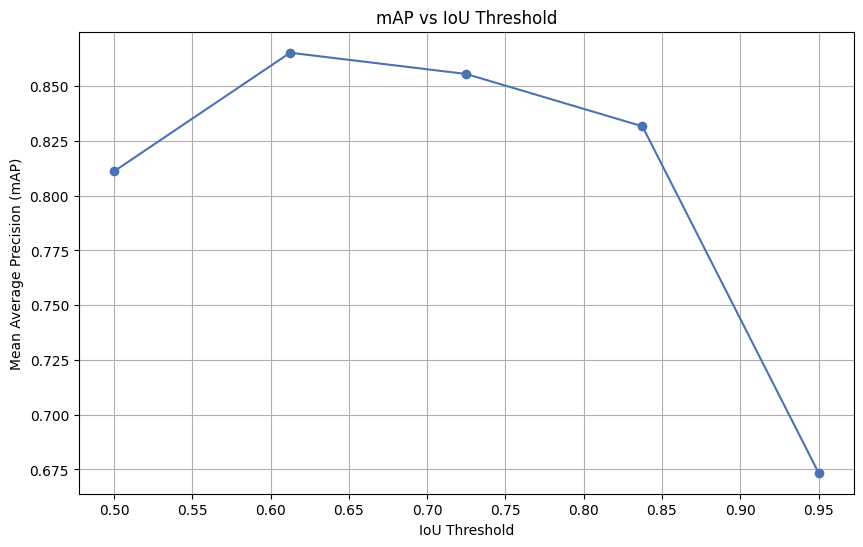

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# 검증 결과에서 mAP 값을 가져옵니다.
# 예시로 results.box.maps를 가져온다고 가정
maps = results.box.maps  # mAP 값을 저장하는 변수

# IoU 임계값 설정 (보통 0.5에서 0.95까지의 임계값을 다룹니다)
iou_thresholds = np.linspace(0.5, 0.95, len(maps))  # IoU 임계값을 자동으로 맞춤

# mAP vs IoU Threshold 그래프 그리기
plt.figure(figsize=(10, 6))
plt.plot(iou_thresholds, maps, marker='o', linestyle='-', color='b')
plt.title('mAP vs IoU Threshold')
plt.xlabel('IoU Threshold')
plt.ylabel('Mean Average Precision (mAP)')
plt.xticks(np.arange(0.5, 1.0, 0.05))  # x축 눈금 설정
plt.grid(True)
plt.show()

## 모델 예측

In [ ]:
# 예측된 결과 저장 디렉토리 확인
print("Predictions saved in: runs/detect/predict")

Predictions saved in: runs/detect/predict


In [ ]:
from ultralytics import YOLO

# 학습된 모델 로드 (best.pt 파일 사용)
# model = YOLO("/content/runs/detect/spine_detection_finetuned/weights/best.pt")
# model = YOLO("/content/drive/MyDrive/YOLO_runs/spine_detection_finetuned/weights/best.pt")
model = YOLO("/content/drive/MyDrive/YOLO weight/9_24.pt")

# 전체 테스트 데이터 예측 (81장)
results = model.predict(source="/content/spine_data_400/images/test", save=True)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.

image 1/81 /content/spine_data_400/images/test/0001-F-037Y0.jpg: 640x544 1 L1, 1 L2, 1 L3, 1 L4, 1 L5, 698.8ms
image 2/81 /content/spine_data_400/images/test/0004-F-010Y0.jpg: 640x544 1 L1, 1 L2, 1 L3, 1 L4, 1 L5, 503.4ms
image 3/81 /content/spine_data_400/images/test/0008-M-022Y0.jpg: 640x544 1 L1, 1 L2, 1 L3, 1 L4, 1 L5, 514.3ms
image 4/81 /content/spine_data_400/images/test/0009-F-038Y0.jpg: 640x544 1 L1, 1 L2, 1 L3, 1 L4, 1 L5, 522.2ms
image 5/81 /content/spine_data_400/images/test/0011-F-063Y0.jpg: 640x544 1 L1, 1 L2, 1 L3, 1 L4, 1 L5, 503.8ms
image 6/81 /content/spine_data_400/images/test/0012-F-013Y0.jpg: 640x544 1 L1, 1 L2, 1 L3, 1 L4, 1 L5, 562.7ms
image 7/81 /content/sp

## 요추별 Center point Distance

In [ ]:
from pathlib import Path

# 저장할 디렉토리 경로 설정 (detect의 predict 폴더)
save_dir = Path("/content/runs/detect/pred_labels/")
save_dir.mkdir(parents=True, exist_ok=True)  # 폴더가 없으면 생성

# 예측된 결과를 바탕으로 바운딩 박스 정보를 텍스트 파일로 저장
for result in results:
    image_name = Path(result.path).stem  # 이미지 파일명 (확장자 제거)
    label_path = save_dir / f"{image_name}.txt"  # 저장할 텍스트 파일 경로

    with open(label_path, 'w') as f:
        for box in result.boxes:
            cls = int(box.cls)  # 클래스 정보
            xywh = box.xywh[0].tolist()  # 바운딩 박스 좌표 (x, y, w, h)
            conf = box.conf[0].item()  # 예측 확률

            # YOLO 형식으로 (class, x_center, y_center, width, height) 저장
            f.write(f"{cls} {xywh[0]} {xywh[1]} {xywh[2]} {xywh[3]} {conf}\n")

print("Label files saved successfully!")

Label files saved successfully!


In [ ]:
import pandas as pd
from PIL import Image
import os

ap_df = merged_df

# YOLO 라벨 변환 및 클래스별 중심점 추출 (Test 데이터만)
class_center_points = {0: [], 1: [], 2: [], 3: [], 4: []}  # 클래스별 중심점 저장

# Test로 split된 데이터만 선택
test_df = ap_df[ap_df['split'] == 'Test']

# 각 이미지에 대해 클래스별 중심점을 계산
results = []

def calculate_center_point(x1, y1, x2, y2, x3, y3, x4, y4):
    x_min = min(x1, x2, x3, x4)
    y_min = min(y1, y2, y3, y4)
    x_max = max(x1, x2, x3, x4)
    y_max = max(y1, y2, y3, y4)

    x_center = (x_min + x_max) / 2
    y_center = (y_min + y_max) / 2
    return x_center, y_center

for index, row in test_df.iterrows():
    image_name = row['filename']
    image_path = row['image_path']

    # 이미지별 결과를 저장하기 위한 리스트
    image_results = []

    # 클래스별 중심점 계산
    for class_id, coords in enumerate([['L1a_1c', 'L1a_1r', 'L1a_2c', 'L1a_2r', 'L1b_1c', 'L1b_1r', 'L1b_2c', 'L1b_2r'],
                                        ['L2a_1c', 'L2a_1r', 'L2a_2c', 'L2a_2r', 'L2b_1c', 'L2b_1r', 'L2b_2c', 'L2b_2r'],
                                        ['L3a_1c', 'L3a_1r', 'L3a_2c', 'L3a_2r', 'L3b_1c', 'L3b_1r', 'L3b_2c', 'L3b_2r'],
                                        ['L4a_1c', 'L4a_1r', 'L4a_2c', 'L4a_2r', 'L4b_1c', 'L4b_1r', 'L4b_2c', 'L4b_2r'],
                                        ['L5a_1c', 'L5a_1r', 'L5a_2c', 'L5a_2r', 'L5b_1c', 'L5b_1r', 'L5b_2c', 'L5b_2r']]):

        x_center, y_center = calculate_center_point(row[coords[0]], row[coords[1]],
                                                    row[coords[2]], row[coords[3]],
                                                    row[coords[4]], row[coords[5]],
                                                    row[coords[6]], row[coords[7]])

        image_results.append(f"Class {class_id}: ({x_center}, {y_center})")

    # 이미지별 결과 저장
    results.append(f"Image: {image_name}\n" + "\n".join(image_results) + "\n")

# 이미지별 클래스 중심점 출력
for result in results:
    print(result)


Image: 0001-F-037Y0
Class 0: (992.99495, 240.36445)
Class 1: (983.82035, 427.8276)
Class 2: (971.6859, 638.98905)
Class 3: (957.64725, 866.1981499999999)
Class 4: (947.9911500000001, 1072.0861)

Image: 0004-F-010Y0
Class 0: (1130.9135, 318.66765)
Class 1: (1123.451, 475.39245)
Class 2: (1106.2511, 641.2791)
Class 3: (1073.22595, 808.8393)
Class 4: (1050.48785, 918.9683)

Image: 0008-M-022Y0
Class 0: (919.18655, 328.11015)
Class 1: (902.87825, 532.3653)
Class 2: (881.0643, 741.7499)
Class 3: (855.6018999999999, 959.0372)
Class 4: (855.17415, 1140.291)

Image: 0009-F-038Y0
Class 0: (1177.7255, 324.3612)
Class 1: (1159.226, 511.47105)
Class 2: (1088.1632, 699.3956499999999)
Class 3: (1008.09455, 899.5676000000001)
Class 4: (949.7282, 1103.8197499999999)

Image: 0011-F-063Y0
Class 0: (739.9757500000001, 528.30375)
Class 1: (773.1877, 709.1323500000001)
Class 2: (865.1532, 882.13225)
Class 3: (928.875, 1056.1965500000001)
Class 4: (950.5064, 1235.5900000000001)

Image: 0012-F-013Y0
Class 0:

In [ ]:
import os
import math

# YOLO 예측 결과가 저장된 디렉토리
pred_labels_dir = "/content/runs/detect/pred_labels/"

# YOLO 예측 결과를 읽어서 클래스별 중심 좌표를 저장할 딕셔너리
yolo_predictions = {}

# YOLO 예측 결과 파일 읽기
for filename in os.listdir(pred_labels_dir):
    if filename.endswith(".txt"):
        image_name = filename.split(".")[0]  # 이미지 이름 (확장자 제거)
        with open(os.path.join(pred_labels_dir, filename), 'r') as f:
            class_centers = {}
            for line in f.readlines():
                # 클래스, 중심 좌표 읽기
                class_id, x_center, y_center, width, height, conf = map(float, line.strip().split())
                class_centers[int(class_id)] = (x_center, y_center)
            yolo_predictions[image_name] = class_centers

# 원본 중심 좌표와 YOLO 예측 결과 비교
for index, row in test_df.iterrows():
    image_name = row['filename']

    if image_name in yolo_predictions:
        print(f"Image: {image_name}")

        for class_id, coords in enumerate([['L1a_1c', 'L1a_1r', 'L1a_2c', 'L1a_2r', 'L1b_1c', 'L1b_1r', 'L1b_2c', 'L1b_2r'],
                                            ['L2a_1c', 'L2a_1r', 'L2a_2c', 'L2a_2r', 'L2b_1c', 'L2b_1r', 'L2b_2c', 'L2b_2r'],
                                            ['L3a_1c', 'L3a_1r', 'L3a_2c', 'L3a_2r', 'L3b_1c', 'L3b_1r', 'L3b_2c', 'L3b_2r'],
                                            ['L4a_1c', 'L4a_1r', 'L4a_2c', 'L4a_2r', 'L4b_1c', 'L4b_1r', 'L4b_2c', 'L4b_2r'],
                                            ['L5a_1c', 'L5a_1r', 'L5a_2c', 'L5a_2r', 'L5b_1c', 'L5b_1r', 'L5b_2c', 'L5b_2r']]):

            # 원본 좌표로부터 중심점 계산
            x_center_orig, y_center_orig = calculate_center_point(row[coords[0]], row[coords[1]],
                                                                  row[coords[2]], row[coords[3]],
                                                                  row[coords[4]], row[coords[5]],
                                                                  row[coords[6]], row[coords[7]])

            # YOLO 예측된 중심점
            x_center_pred, y_center_pred = yolo_predictions[image_name].get(class_id, (None, None))

            # 거리 계산 (유클리드 거리)
            if x_center_pred is not None and y_center_pred is not None:
                distance = math.sqrt((x_center_orig - x_center_pred) ** 2 + (y_center_orig - y_center_pred) ** 2)

                # 비교 출력
                print(f"  Class {class_id}:")
                print(f"    Original center: ({x_center_orig:.4f}, {y_center_orig:.4f})")
                print(f"    YOLO predicted center: ({x_center_pred:.4f}, {y_center_pred:.4f})")
                print(f"    Distance: {distance:.4f}")


Image: 0001-F-037Y0
  Class 0:
    Original center: (992.9950, 240.3645)
    YOLO predicted center: (988.7830, 238.4373)
    Distance: 4.6319
  Class 1:
    Original center: (983.8203, 427.8276)
    YOLO predicted center: (982.9996, 431.3822)
    Distance: 3.6481
  Class 2:
    Original center: (971.6859, 638.9891)
    YOLO predicted center: (968.5283, 637.4209)
    Distance: 3.5256
  Class 3:
    Original center: (957.6472, 866.1981)
    YOLO predicted center: (953.9641, 866.4498)
    Distance: 3.6917
  Class 4:
    Original center: (947.9912, 1072.0861)
    YOLO predicted center: (952.8596, 1079.9451)
    Distance: 9.2447
Image: 0004-F-010Y0
  Class 0:
    Original center: (1130.9135, 318.6676)
    YOLO predicted center: (1124.5295, 318.8604)
    Distance: 6.3869
  Class 1:
    Original center: (1123.4510, 475.3924)
    YOLO predicted center: (1121.4438, 474.7544)
    Distance: 2.1061
  Class 2:
    Original center: (1106.2511, 641.2791)
    YOLO predicted center: (1104.3774, 641.146

In [ ]:
import os
import math
import pandas as pd

# YOLO 예측 결과가 저장된 디렉토리
pred_labels_dir = "/content/runs/detect/pred_labels/"

# YOLO 예측 결과를 읽어서 클래스별 중심 좌표를 저장할 딕셔너리
yolo_predictions = {}

# YOLO 예측 결과 파일 읽기
for filename in os.listdir(pred_labels_dir):
    if filename.endswith(".txt"):
        image_name = filename.split(".")[0]  # 이미지 이름 (확장자 제거)
        with open(os.path.join(pred_labels_dir, filename), 'r') as f:
            class_centers = {}
            for line in f.readlines():
                # 클래스, 중심 좌표 읽기
                class_id, x_center, y_center, width, height, conf = map(float, line.strip().split())
                class_centers[int(class_id)] = (x_center, y_center)
            yolo_predictions[image_name] = class_centers

# 결과를 저장할 리스트
distance_data = []

# 원본 중심 좌표와 YOLO 예측 결과 비교
for index, row in test_df.iterrows():
    image_name = row['filename']

    if image_name in yolo_predictions:
        # 각 클래스별 거리 값을 저장할 리스트 (L1, L2, L3, L4, L5 순서)
        distances = [image_name]

        for class_id, coords in enumerate([['L1a_1c', 'L1a_1r', 'L1a_2c', 'L1a_2r', 'L1b_1c', 'L1b_1r', 'L1b_2c', 'L1b_2r'],
                                            ['L2a_1c', 'L2a_1r', 'L2a_2c', 'L2a_2r', 'L2b_1c', 'L2b_1r', 'L2b_2c', 'L2b_2r'],
                                            ['L3a_1c', 'L3a_1r', 'L3a_2c', 'L3a_2r', 'L3b_1c', 'L3b_1r', 'L3b_2c', 'L3b_2r'],
                                            ['L4a_1c', 'L4a_1r', 'L4a_2c', 'L4a_2r', 'L4b_1c', 'L4b_1r', 'L4b_2c', 'L4b_2r'],
                                            ['L5a_1c', 'L5a_1r', 'L5a_2c', 'L5a_2r', 'L5b_1c', 'L5b_1r', 'L5b_2c', 'L5b_2r']]):

            # 원본 좌표로부터 중심점 계산
            x_center_orig, y_center_orig = calculate_center_point(row[coords[0]], row[coords[1]],
                                                                  row[coords[2]], row[coords[3]],
                                                                  row[coords[4]], row[coords[5]],
                                                                  row[coords[6]], row[coords[7]])

            # YOLO 예측된 중심점
            x_center_pred, y_center_pred = yolo_predictions[image_name].get(class_id, (None, None))

            # 거리 계산 (유클리드 거리)
            if x_center_pred is not None and y_center_pred is not None:
                distance = math.sqrt((x_center_orig - x_center_pred) ** 2 + (y_center_orig - y_center_pred) ** 2)
            else:
                distance = None  # 예측 값이 없는 경우

            distances.append(distance)

        # 이미지 이름과 각 클래스별 거리를 distance_data 리스트에 추가
        distance_data.append(distances)

# 데이터를 DataFrame으로 변환
columns = ['image_name', 'L1', 'L2', 'L3', 'L4', 'L5']
distance_df = pd.DataFrame(distance_data, columns=columns)

# CSV 파일로 저장
csv_file_path = "/content/distance_comparison.csv"
distance_df.to_csv(csv_file_path, index=False)

print(f"CSV file saved successfully at: {csv_file_path}")

CSV file saved successfully at: /content/distance_comparison.csv


In [ ]:
# 각 클래스별 distance의 평균 계산
class_distance_means = distance_df[['L1', 'L2', 'L3', 'L4', 'L5']].mean()

# 결과 출력
print("Class-wise distance means:")
print(class_distance_means)

Class-wise distance means:
L1    16.814679
L2     9.111069
L3    13.706729
L4    23.858882
L5    20.761901
dtype: float64


In [ ]:
import shutil
import os

# YOLOv8 결과 저장 디렉토리 경로
source_dir = "/content/runs/detect/predict"

# Google Drive에 저장할 디렉토리 경로
destination_dir = "/content/drive/MyDrive/YOLOv8_predictions-1"
os.makedirs(destination_dir, exist_ok=True)

# 이미지 파일들을 Google Drive로 복사
for filename in os.listdir(source_dir):
    file_path = os.path.join(source_dir, filename)
    if os.path.isfile(file_path):  # 파일이 존재하는 경우에만 복사
        shutil.copy(file_path, destination_dir)

print(f"모든 예측 이미지가 Google Drive의 {destination_dir}에 저장되었습니다.")

모든 예측 이미지가 Google Drive의 /content/drive/MyDrive/YOLOv8_predictions-1에 저장되었습니다.


## IOU 계산

In [ ]:
!  cp -r /content/drive/MyDrive/YOLO_runs /content/

In [ ]:
import os
import pandas as pd
from ultralytics import YOLO
import numpy as np

# IOU 계산 함수
def calculate_iou(box1, box2):
    x1_inter = max(box1[0], box2[0])
    y1_inter = max(box1[1], box2[1])
    x2_inter = min(box1[2], box2[2])
    y2_inter = min(box1[3], box2[3])

    inter_area = max(0, x2_inter - x1_inter) * max(0, y2_inter - y1_inter)
    box1_area = (box1[2] - box1[0]) * (box1[3] - box1[1])
    box2_area = (box2[2] - box2[0]) * (box2[3] - box2[1])

    union_area = box1_area + box2_area - inter_area

    iou = inter_area / union_area if union_area > 0 else 0
    return iou


In [ ]:
# 각 이미지에 대한 IOU 계산
iou_values = []
image_names = []  # 이미지 이름을 저장
pred_classes = []  # 예측 클래스 정보를 저장

for result in results:
    preds = result.boxes.xyxy.cpu().numpy()
    pred_classes_batch = result.boxes.cls.cpu().numpy()
    image_path = result.path
    image_name = os.path.basename(image_path)
    image_name_no_ext = os.path.splitext(image_name)[0]

    gt_row = ap_df[ap_df['filename'] == image_name_no_ext]
    if not gt_row.empty:
        gt_boxes = {}
        for i in range(1, 6):
            x1, y1 = gt_row[f'L{i}a_1c'].values, gt_row[f'L{i}a_1r'].values
            x2, y2 = gt_row[f'L{i}a_2c'].values, gt_row[f'L{i}a_2r'].values
            x3, y3 = gt_row[f'L{i}b_1c'].values, gt_row[f'L{i}b_1r'].values
            x4, y4 = gt_row[f'L{i}b_2c'].values, gt_row[f'L{i}b_2r'].values
            # 바운딩 박스 계산 (1번 요추)
            x_min = min(x1, x2, x3, x4)
            y_min = min(y1, y2, y3, y4)
            x_max = max(x1, x2, x3, x4)
            y_max = max(y1, y2, y3, y4)
            gt_box = [
               x_min,
               y_min,
               x_max,
               y_max
            ]
            gt_boxes[i - 1] = gt_box

        for pred_box, pred_class in zip(preds, pred_classes_batch):
            if pred_class in gt_boxes:
                gt_box = gt_boxes[pred_class]
                iou_value = calculate_iou(gt_box, pred_box)
                iou_values.append(iou_value)
                image_names.append(image_name_no_ext)
                pred_classes.append(pred_class)

                print(f"{image_name_no_ext}의 클래스 {pred_class}에 대한 IOU: {iou_value}")


##  sw added for code testing
# import cv2
# import matplotlib.pyplot as plt
# image_path = result.path
# test_img = cv2.imread(image_path)
# cv2.rectangle(test_img, [int(n) for n in gt_box[:2]], [int(n) for n in gt_box[2:]], (255,0,0), 3)
# # cv2.rectangle(test_img, [int(n) for n in pred_box[:2]], [int(n) for n in pred_box[2:]], (0,255,0), 3)
# plt.imshow(test_img)
# break

0001-F-037Y0의 클래스 2.0에 대한 IOU: [    0.95804]
0001-F-037Y0의 클래스 3.0에 대한 IOU: [    0.96244]
0001-F-037Y0의 클래스 1.0에 대한 IOU: [    0.91819]
0001-F-037Y0의 클래스 0.0에 대한 IOU: [    0.88165]
0001-F-037Y0의 클래스 4.0에 대한 IOU: [    0.89452]
0004-F-010Y0의 클래스 1.0에 대한 IOU: [    0.92913]
0004-F-010Y0의 클래스 2.0에 대한 IOU: [    0.94605]
0004-F-010Y0의 클래스 0.0에 대한 IOU: [    0.89145]
0004-F-010Y0의 클래스 3.0에 대한 IOU: [      0.666]
0004-F-010Y0의 클래스 4.0에 대한 IOU: [     0.8885]
0008-M-022Y0의 클래스 1.0에 대한 IOU: [    0.97859]
0008-M-022Y0의 클래스 2.0에 대한 IOU: [    0.96094]
0008-M-022Y0의 클래스 0.0에 대한 IOU: [    0.94885]
0008-M-022Y0의 클래스 3.0에 대한 IOU: [     0.9274]
0008-M-022Y0의 클래스 4.0에 대한 IOU: [    0.84117]
0009-F-038Y0의 클래스 2.0에 대한 IOU: [    0.95114]
0009-F-038Y0의 클래스 3.0에 대한 IOU: [    0.96034]
0009-F-038Y0의 클래스 1.0에 대한 IOU: [    0.91057]
0009-F-038Y0의 클래스 0.0에 대한 IOU: [    0.94874]
0009-F-038Y0의 클래스 4.0에 대한 IOU: [    0.89688]
0011-F-063Y0의 클래스 1.0에 대한 IOU: [     0.9571]
0011-F-063Y0의 클래스 3.0에 대한 IOU: [     0.8255]
0011-F-063

In [ ]:
import pandas as pd

# Dictionary to store IOU values for each image
iou_data = {
    'image_name': [],
    'L1': [],
    'L2': [],
    'L3': [],
    'L4': [],
    'L5': []
}

# Iterate over the results and store IOU values for each lumbar vertebra (L1 to L5)
for result in results:
    preds = result.boxes.xyxy.cpu().numpy()
    pred_classes_batch = result.boxes.cls.cpu().numpy()
    image_path = result.path
    image_name = os.path.basename(image_path)
    image_name_no_ext = os.path.splitext(image_name)[0]

    gt_row = ap_df[ap_df['filename'] == image_name_no_ext]
    if not gt_row.empty:
        gt_boxes = {}
        for i in range(1, 6):
            x1, y1 = gt_row[f'L{i}a_1c'].values, gt_row[f'L{i}a_1r'].values
            x2, y2 = gt_row[f'L{i}a_2c'].values, gt_row[f'L{i}a_2r'].values
            x3, y3 = gt_row[f'L{i}b_1c'].values, gt_row[f'L{i}b_1r'].values
            x4, y4 = gt_row[f'L{i}b_2c'].values, gt_row[f'L{i}b_2r'].values
            x_min = pd.Series([x1, x2, x3, x4]).min()
            y_min = pd.Series([y1, y2, y3, y4]).min()
            x_max = pd.Series([x1, x2, x3, x4]).max()
            y_max = pd.Series([y1, y2, y3, y4]).max()
            gt_box = [x_min, y_min, x_max, y_max]
            gt_boxes[i - 1] = gt_box

        # Initialize IOU values for each lumbar vertebra as NaN (for cases with no matching prediction)
        iou_row = [float('nan')] * 5

        # Calculate IOU for each predicted box
        for pred_box, pred_class in zip(preds, pred_classes_batch):
            if pred_class in gt_boxes:
                gt_box = gt_boxes[int(pred_class)]
                iou_value = calculate_iou(gt_box, pred_box)
                iou_row[int(pred_class)] = iou_value  # Store IOU for the corresponding lumbar vertebra

        # Append the IOU row and image name to the dictionary
        iou_data['image_name'].append(image_name_no_ext)
        iou_data['L1'].append(iou_row[0])
        iou_data['L2'].append(iou_row[1])
        iou_data['L3'].append(iou_row[2])
        iou_data['L4'].append(iou_row[3])
        iou_data['L5'].append(iou_row[4])

# Create a DataFrame from the IOU data
iou_df = pd.DataFrame(iou_data)

# Save to CSV file
iou_df.to_csv('iou_results.csv', index=False)

print("IOU values saved to iou_results.csv")


IOU values saved to iou_results.csv


In [ ]:
from collections import defaultdict

# 클래스별로 IoU 값을 저장할 딕셔너리 초기화
iou_dict = defaultdict(list)

# 각 이미지와 클래스별로 IoU 값을 계산하고 저장
for result in results:
    preds = result.boxes.xyxy.cpu().numpy()
    pred_classes_batch = result.boxes.cls.cpu().numpy()
    image_path = result.path
    image_name = os.path.basename(image_path)
    image_name_no_ext = os.path.splitext(image_name)[0]

    gt_row = ap_df[ap_df['filename'] == image_name_no_ext]
    if not gt_row.empty:
        gt_boxes = {}
        for i in range(1, 6):
            gt_box = [
                gt_row[f'L{i}a_1c'].values[0],
                gt_row[f'L{i}a_1r'].values[0],
                gt_row[f'L{i}b_2c'].values[0],
                gt_row[f'L{i}b_2r'].values[0]
            ]
            gt_boxes[i - 1] = gt_box

        for pred_box, pred_class in zip(preds, pred_classes_batch):
            if pred_class in gt_boxes:
                gt_box = gt_boxes[pred_class]
                iou_value = calculate_iou(gt_box, pred_box)
                iou_dict[pred_class].append(iou_value)  # 클래스별로 IoU 값을 저장

# 각 클래스별로 IoU 값의 평균을 계산
for class_id, iou_list in iou_dict.items():
    mean_iou = np.mean(iou_list)
    print(f"클래스 {class_id}에 대한 평균 IOU: {mean_iou:.4f}")

클래스 2.0에 대한 평균 IOU: 0.7144
클래스 3.0에 대한 평균 IOU: 0.7003
클래스 1.0에 대한 평균 IOU: 0.7455
클래스 0.0에 대한 평균 IOU: 0.7139
클래스 4.0에 대한 평균 IOU: 0.7158


## confidence >= 0.6

In [ ]:
iou_threshold = 0.6  # 원하는 신뢰도 임계값

iou_values = []
image_names = []  # 이미지 이름을 저장
pred_classes = []  # 예측 클래스 정보를 저장

for result in results:
    preds = result.boxes.xyxy.cpu().numpy()  # 예측된 바운딩 박스 좌표
    pred_classes_batch = result.boxes.cls.cpu().numpy()  # 예측 클래스
    confidences_batch = result.boxes.conf.cpu().numpy()  # confidence score
    image_path = result.path
    image_name = os.path.basename(image_path)
    image_name_no_ext = os.path.splitext(image_name)[0]

    gt_row = ap_df[ap_df['filename'] == image_name_no_ext]
    if not gt_row.empty:
        gt_boxes = {}
        for i in range(1, 6):
            gt_box = [
                gt_row[f'L{i}a_1c'].values[0],
                gt_row[f'L{i}a_1r'].values[0],
                gt_row[f'L{i}b_2c'].values[0],
                gt_row[f'L{i}b_2r'].values[0]
            ]
            gt_boxes[i - 1] = gt_box

        for pred_box, pred_class, conf in zip(preds, pred_classes_batch, confidences_batch):
            if conf >= iou_threshold:  # confidence가 0.6 이상일 경우에만 처리
                if pred_class in gt_boxes:
                    gt_box = gt_boxes[pred_class]
                    iou_value = calculate_iou(gt_box, pred_box)
                    iou_values.append(iou_value)
                    image_names.append(image_name_no_ext)
                    pred_classes.append(pred_class)

                    print(f"{image_name_no_ext}의 클래스 {pred_class}에 대한 IOU: {iou_value} (Confidence: {conf})")


0001-F-037Y0의 클래스 2.0에 대한 IOU: 0.9033727612467021 (Confidence: 0.9367218017578125)
0001-F-037Y0의 클래스 3.0에 대한 IOU: 0.8856074434960526 (Confidence: 0.9319210648536682)
0001-F-037Y0의 클래스 1.0에 대한 IOU: 0.8709655983723924 (Confidence: 0.9085317254066467)
0001-F-037Y0의 클래스 0.0에 대한 IOU: 0.845063941496984 (Confidence: 0.8998459577560425)
0001-F-037Y0의 클래스 4.0에 대한 IOU: 0.8394498792704812 (Confidence: 0.8738444447517395)
0004-F-010Y0의 클래스 1.0에 대한 IOU: 0.8481336384510982 (Confidence: 0.9335710406303406)
0004-F-010Y0의 클래스 2.0에 대한 IOU: 0.8346778096844308 (Confidence: 0.9046086668968201)
0004-F-010Y0의 클래스 0.0에 대한 IOU: 0.8701186330527041 (Confidence: 0.8974602818489075)
0004-F-010Y0의 클래스 3.0에 대한 IOU: 0.6831770359029361 (Confidence: 0.8921735882759094)
0004-F-010Y0의 클래스 4.0에 대한 IOU: 0.7999058857628297 (Confidence: 0.7269867062568665)
0008-M-022Y0의 클래스 1.0에 대한 IOU: 0.8991626632448766 (Confidence: 0.9455658197402954)
0008-M-022Y0의 클래스 2.0에 대한 IOU: 0.8465837531906562 (Confidence: 0.9359920620918274)
0008-

0001-F-037Y0의 클래스 L3에 대한 IOU: 0.90 (Confidence: 0.94)
0001-F-037Y0의 클래스 L4에 대한 IOU: 0.89 (Confidence: 0.93)
0001-F-037Y0의 클래스 L2에 대한 IOU: 0.87 (Confidence: 0.91)
0001-F-037Y0의 클래스 L1에 대한 IOU: 0.85 (Confidence: 0.90)
0001-F-037Y0의 클래스 L5에 대한 IOU: 0.84 (Confidence: 0.87)


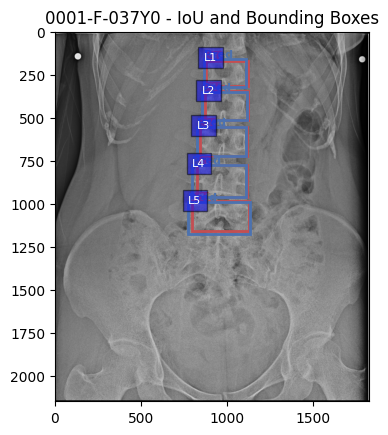

0004-F-010Y0의 클래스 L2에 대한 IOU: 0.85 (Confidence: 0.93)
0004-F-010Y0의 클래스 L3에 대한 IOU: 0.83 (Confidence: 0.90)
0004-F-010Y0의 클래스 L1에 대한 IOU: 0.87 (Confidence: 0.90)
0004-F-010Y0의 클래스 L4에 대한 IOU: 0.68 (Confidence: 0.89)
0004-F-010Y0의 클래스 L5에 대한 IOU: 0.80 (Confidence: 0.73)


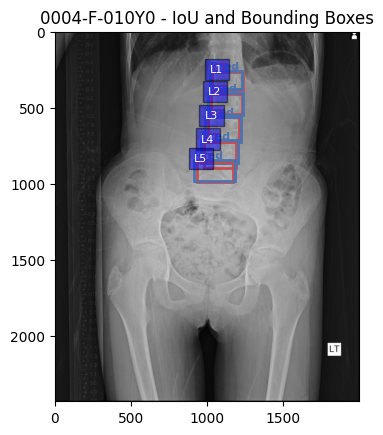

0008-M-022Y0의 클래스 L2에 대한 IOU: 0.90 (Confidence: 0.95)
0008-M-022Y0의 클래스 L3에 대한 IOU: 0.85 (Confidence: 0.94)
0008-M-022Y0의 클래스 L1에 대한 IOU: 0.91 (Confidence: 0.93)
0008-M-022Y0의 클래스 L4에 대한 IOU: 0.84 (Confidence: 0.92)
0008-M-022Y0의 클래스 L5에 대한 IOU: 0.83 (Confidence: 0.86)


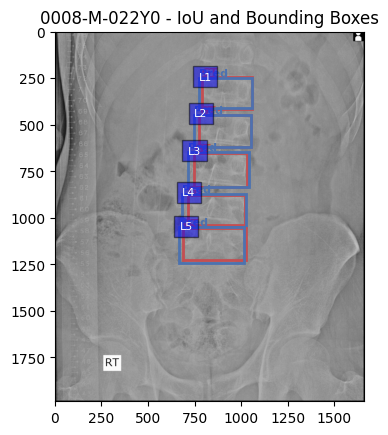

0009-F-038Y0의 클래스 L3에 대한 IOU: 0.57 (Confidence: 0.95)
0009-F-038Y0의 클래스 L4에 대한 IOU: 0.65 (Confidence: 0.95)
0009-F-038Y0의 클래스 L2에 대한 IOU: 0.69 (Confidence: 0.90)
0009-F-038Y0의 클래스 L1에 대한 IOU: 0.90 (Confidence: 0.89)
0009-F-038Y0의 클래스 L5에 대한 IOU: 0.76 (Confidence: 0.88)


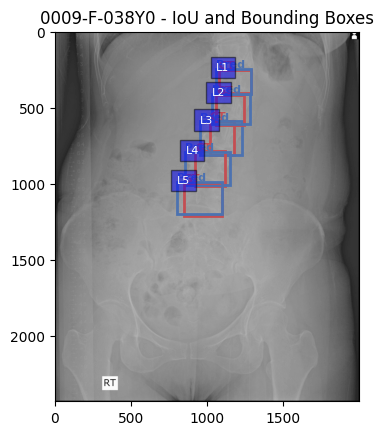

0011-F-063Y0의 클래스 L2에 대한 IOU: 0.27 (Confidence: 0.94)
0011-F-063Y0의 클래스 L4에 대한 IOU: 0.32 (Confidence: 0.93)
0011-F-063Y0의 클래스 L3에 대한 IOU: 0.18 (Confidence: 0.93)
0011-F-063Y0의 클래스 L1에 대한 IOU: 0.67 (Confidence: 0.91)
0011-F-063Y0의 클래스 L5에 대한 IOU: 0.78 (Confidence: 0.89)


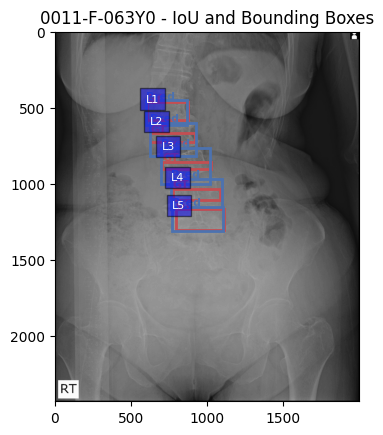

0012-F-013Y0의 클래스 L3에 대한 IOU: 0.91 (Confidence: 0.93)
0012-F-013Y0의 클래스 L4에 대한 IOU: 0.87 (Confidence: 0.91)
0012-F-013Y0의 클래스 L2에 대한 IOU: 0.92 (Confidence: 0.91)
0012-F-013Y0의 클래스 L5에 대한 IOU: 0.79 (Confidence: 0.87)
0012-F-013Y0의 클래스 L1에 대한 IOU: 0.81 (Confidence: 0.85)


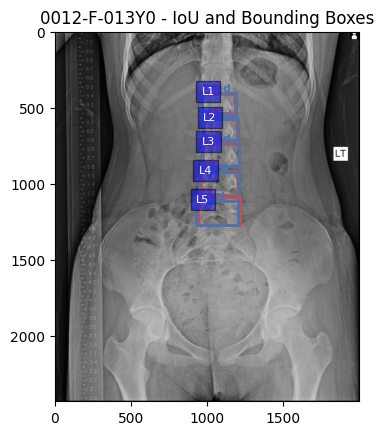

0015-M-020Y0의 클래스 L4에 대한 IOU: 0.78 (Confidence: 0.94)
0015-M-020Y0의 클래스 L3에 대한 IOU: 0.90 (Confidence: 0.93)
0015-M-020Y0의 클래스 L2에 대한 IOU: 0.52 (Confidence: 0.92)
0015-M-020Y0의 클래스 L1에 대한 IOU: 0.21 (Confidence: 0.90)
0015-M-020Y0의 클래스 L5에 대한 IOU: 0.69 (Confidence: 0.87)


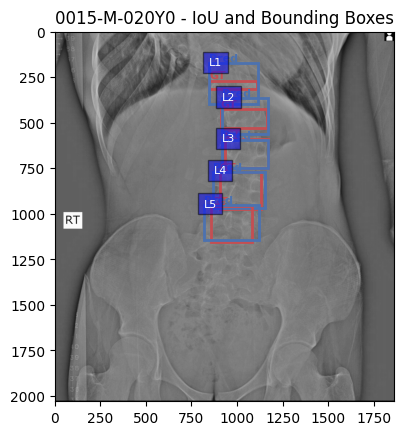

0016-F-023Y0의 클래스 L2에 대한 IOU: 0.62 (Confidence: 0.95)
0016-F-023Y0의 클래스 L3에 대한 IOU: 0.85 (Confidence: 0.94)
0016-F-023Y0의 클래스 L4에 대한 IOU: 0.89 (Confidence: 0.93)
0016-F-023Y0의 클래스 L1에 대한 IOU: 0.57 (Confidence: 0.90)
0016-F-023Y0의 클래스 L5에 대한 IOU: 0.76 (Confidence: 0.87)


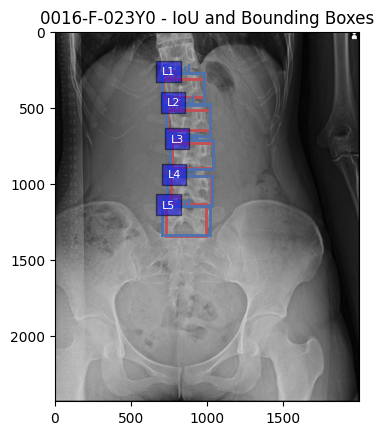

0020-M-030Y0의 클래스 L4에 대한 IOU: 0.92 (Confidence: 0.94)
0020-M-030Y0의 클래스 L3에 대한 IOU: 0.92 (Confidence: 0.94)
0020-M-030Y0의 클래스 L2에 대한 IOU: 0.90 (Confidence: 0.94)
0020-M-030Y0의 클래스 L1에 대한 IOU: 0.88 (Confidence: 0.90)
0020-M-030Y0의 클래스 L5에 대한 IOU: 0.83 (Confidence: 0.83)


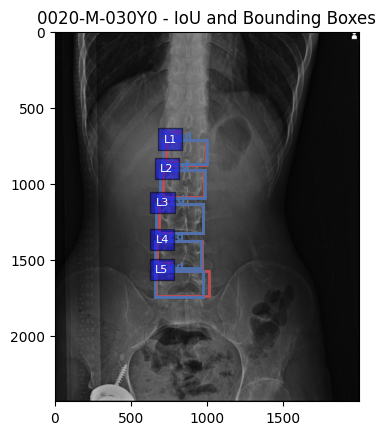

0022-M-006Y0의 클래스 L4에 대한 IOU: 0.75 (Confidence: 0.93)
0022-M-006Y0의 클래스 L2에 대한 IOU: 0.73 (Confidence: 0.87)
0022-M-006Y0의 클래스 L3에 대한 IOU: 0.79 (Confidence: 0.87)
0022-M-006Y0의 클래스 L1에 대한 IOU: 0.71 (Confidence: 0.85)
0022-M-006Y0의 클래스 L5에 대한 IOU: 0.67 (Confidence: 0.82)


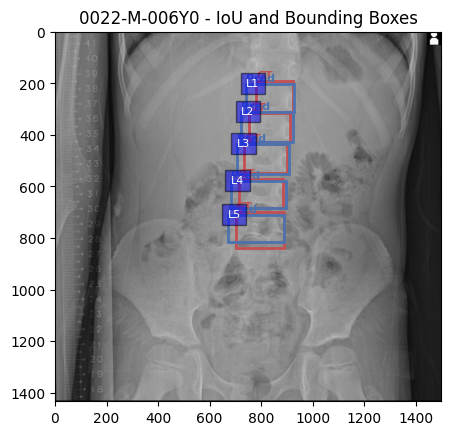

0023-F-014Y0의 클래스 L3에 대한 IOU: 0.89 (Confidence: 0.93)
0023-F-014Y0의 클래스 L2에 대한 IOU: 0.90 (Confidence: 0.93)
0023-F-014Y0의 클래스 L4에 대한 IOU: 0.89 (Confidence: 0.91)
0023-F-014Y0의 클래스 L1에 대한 IOU: 0.89 (Confidence: 0.91)
0023-F-014Y0의 클래스 L5에 대한 IOU: 0.85 (Confidence: 0.83)


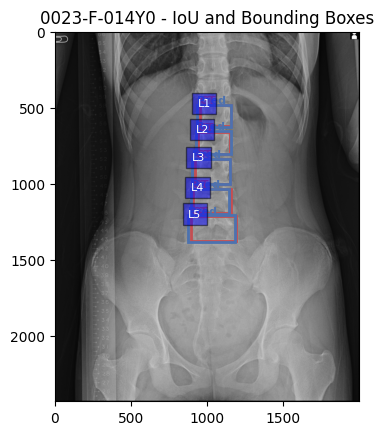

0025-F-015Y0의 클래스 L3에 대한 IOU: 0.45 (Confidence: 0.91)
0025-F-015Y0의 클래스 L2에 대한 IOU: 0.66 (Confidence: 0.88)
0025-F-015Y0의 클래스 L1에 대한 IOU: 0.88 (Confidence: 0.87)
0025-F-015Y0의 클래스 L4에 대한 IOU: 0.62 (Confidence: 0.80)
0025-F-015Y0의 클래스 L4에 대한 IOU: 0.07 (Confidence: 0.71)


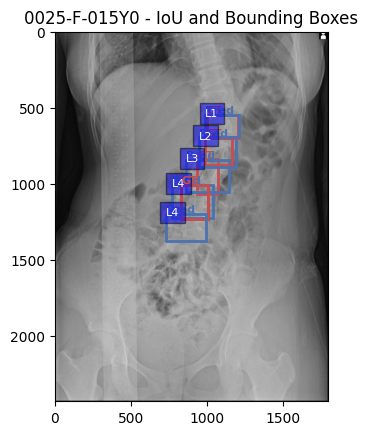

0026-F-029Y0의 클래스 L3에 대한 IOU: 0.66 (Confidence: 0.94)
0026-F-029Y0의 클래스 L4에 대한 IOU: 0.63 (Confidence: 0.94)
0026-F-029Y0의 클래스 L2에 대한 IOU: 0.87 (Confidence: 0.93)
0026-F-029Y0의 클래스 L5에 대한 IOU: 0.72 (Confidence: 0.89)
0026-F-029Y0의 클래스 L1에 대한 IOU: 0.87 (Confidence: 0.87)


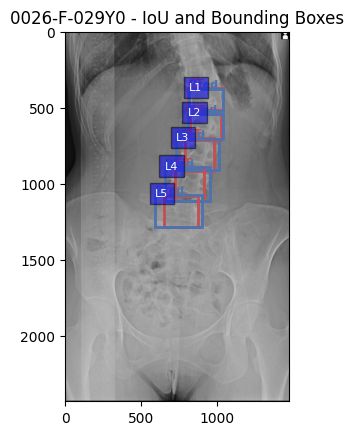

0028-F-041Y0의 클래스 L4에 대한 IOU: 0.84 (Confidence: 0.91)
0028-F-041Y0의 클래스 L3에 대한 IOU: 0.00 (Confidence: 0.87)
0028-F-041Y0의 클래스 L3에 대한 IOU: 0.92 (Confidence: 0.84)
0028-F-041Y0의 클래스 L4에 대한 IOU: 0.00 (Confidence: 0.82)
0028-F-041Y0의 클래스 L2에 대한 IOU: 0.00 (Confidence: 0.81)
0028-F-041Y0의 클래스 L5에 대한 IOU: 0.50 (Confidence: 0.68)
0028-F-041Y0의 클래스 L1에 대한 IOU: 0.00 (Confidence: 0.65)


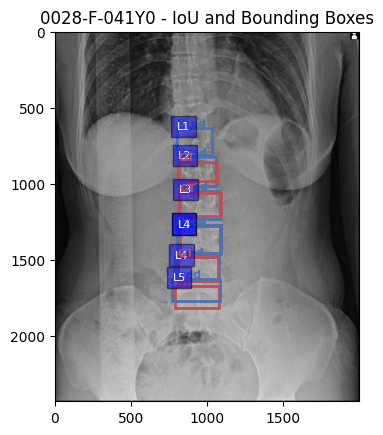

0032-F-007Y0의 클래스 L3에 대한 IOU: 0.90 (Confidence: 0.91)
0032-F-007Y0의 클래스 L1에 대한 IOU: 0.71 (Confidence: 0.89)
0032-F-007Y0의 클래스 L2에 대한 IOU: 0.80 (Confidence: 0.89)
0032-F-007Y0의 클래스 L4에 대한 IOU: 0.82 (Confidence: 0.88)
0032-F-007Y0의 클래스 L5에 대한 IOU: 0.86 (Confidence: 0.76)


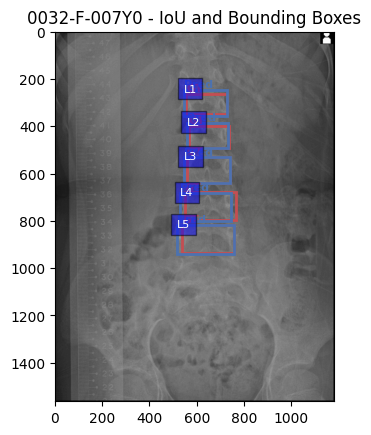

0034-F-067Y0의 클래스 L3에 대한 IOU: 0.88 (Confidence: 0.91)
0034-F-067Y0의 클래스 L4에 대한 IOU: 0.82 (Confidence: 0.89)
0034-F-067Y0의 클래스 L2에 대한 IOU: 0.83 (Confidence: 0.86)
0034-F-067Y0의 클래스 L1에 대한 IOU: 0.76 (Confidence: 0.84)
0034-F-067Y0의 클래스 L5에 대한 IOU: 0.73 (Confidence: 0.77)


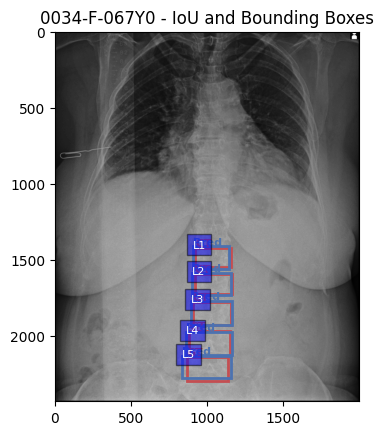

0037-F-019Y0의 클래스 L3에 대한 IOU: 0.65 (Confidence: 0.93)
0037-F-019Y0의 클래스 L2에 대한 IOU: 0.78 (Confidence: 0.93)
0037-F-019Y0의 클래스 L4에 대한 IOU: 0.60 (Confidence: 0.91)
0037-F-019Y0의 클래스 L1에 대한 IOU: 0.94 (Confidence: 0.86)
0037-F-019Y0의 클래스 L5에 대한 IOU: 0.71 (Confidence: 0.75)


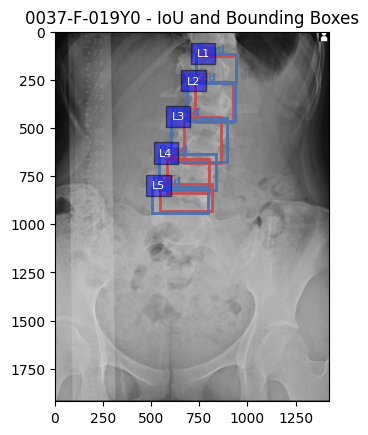

0038-F-020Y0의 클래스 L2에 대한 IOU: 0.73 (Confidence: 0.94)
0038-F-020Y0의 클래스 L3에 대한 IOU: 0.91 (Confidence: 0.94)
0038-F-020Y0의 클래스 L4에 대한 IOU: 0.85 (Confidence: 0.91)
0038-F-020Y0의 클래스 L1에 대한 IOU: 0.66 (Confidence: 0.91)
0038-F-020Y0의 클래스 L5에 대한 IOU: 0.85 (Confidence: 0.86)


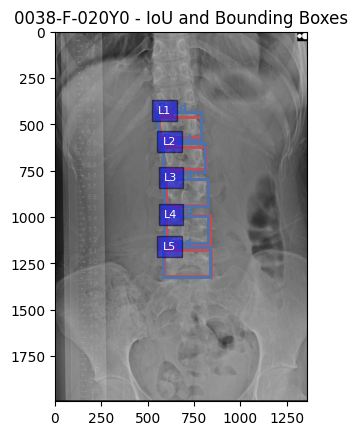

0040-M-023Y0의 클래스 L4에 대한 IOU: 0.81 (Confidence: 0.93)
0040-M-023Y0의 클래스 L3에 대한 IOU: 0.89 (Confidence: 0.93)
0040-M-023Y0의 클래스 L2에 대한 IOU: 0.84 (Confidence: 0.92)
0040-M-023Y0의 클래스 L5에 대한 IOU: 0.81 (Confidence: 0.86)
0040-M-023Y0의 클래스 L1에 대한 IOU: 0.76 (Confidence: 0.84)


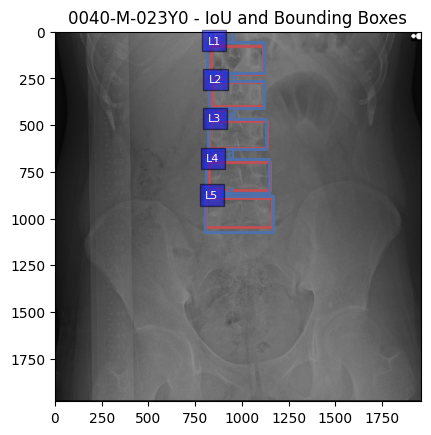

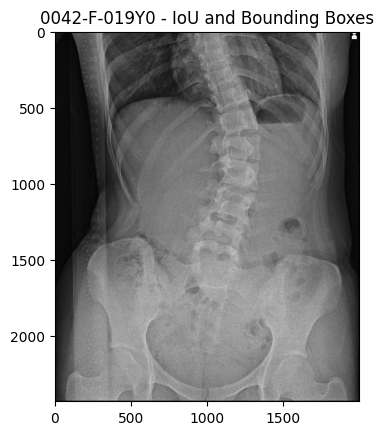

0043-F-039Y0의 클래스 L4에 대한 IOU: 0.65 (Confidence: 0.96)
0043-F-039Y0의 클래스 L3에 대한 IOU: 0.58 (Confidence: 0.93)
0043-F-039Y0의 클래스 L2에 대한 IOU: 0.70 (Confidence: 0.93)
0043-F-039Y0의 클래스 L5에 대한 IOU: 0.75 (Confidence: 0.90)
0043-F-039Y0의 클래스 L1에 대한 IOU: 0.80 (Confidence: 0.90)


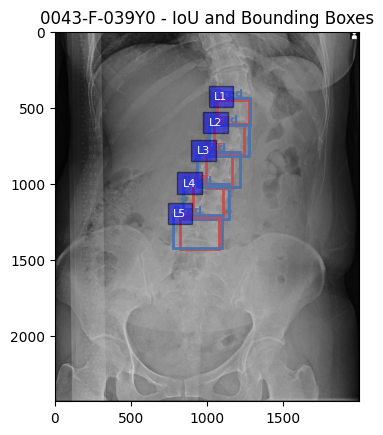

0046-F-021Y0의 클래스 L2에 대한 IOU: 0.57 (Confidence: 0.95)
0046-F-021Y0의 클래스 L3에 대한 IOU: 0.87 (Confidence: 0.93)
0046-F-021Y0의 클래스 L4에 대한 IOU: 0.86 (Confidence: 0.92)
0046-F-021Y0의 클래스 L1에 대한 IOU: 0.36 (Confidence: 0.91)
0046-F-021Y0의 클래스 L5에 대한 IOU: 0.84 (Confidence: 0.85)


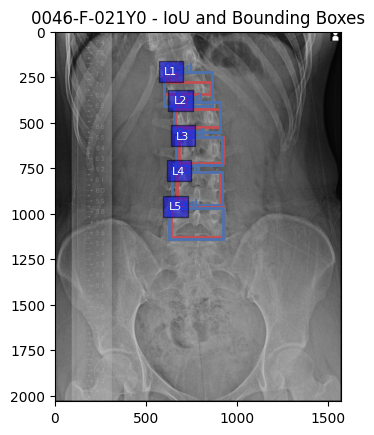

0048-F-020Y0의 클래스 L3에 대한 IOU: 0.81 (Confidence: 0.95)
0048-F-020Y0의 클래스 L2에 대한 IOU: 0.89 (Confidence: 0.93)
0048-F-020Y0의 클래스 L4에 대한 IOU: 0.85 (Confidence: 0.91)
0048-F-020Y0의 클래스 L1에 대한 IOU: 0.89 (Confidence: 0.90)
0048-F-020Y0의 클래스 L5에 대한 IOU: 0.84 (Confidence: 0.75)


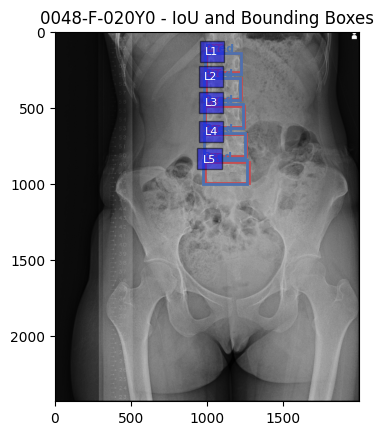

0054-F-079Y0의 클래스 L2에 대한 IOU: 0.81 (Confidence: 0.94)
0054-F-079Y0의 클래스 L3에 대한 IOU: 0.71 (Confidence: 0.94)
0054-F-079Y0의 클래스 L4에 대한 IOU: 0.57 (Confidence: 0.91)
0054-F-079Y0의 클래스 L1에 대한 IOU: 0.88 (Confidence: 0.90)
0054-F-079Y0의 클래스 L5에 대한 IOU: 0.47 (Confidence: 0.80)


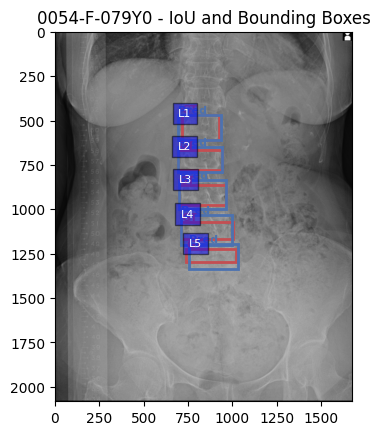

0056-F-069Y0의 클래스 L2에 대한 IOU: 0.92 (Confidence: 0.93)
0056-F-069Y0의 클래스 L3에 대한 IOU: 0.45 (Confidence: 0.93)
0056-F-069Y0의 클래스 L1에 대한 IOU: 0.79 (Confidence: 0.90)
0056-F-069Y0의 클래스 L4에 대한 IOU: 0.31 (Confidence: 0.88)
0056-F-069Y0의 클래스 L5에 대한 IOU: 0.67 (Confidence: 0.80)


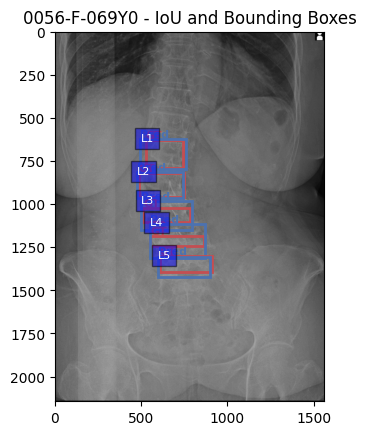

0057-F-030Y0의 클래스 L2에 대한 IOU: 0.92 (Confidence: 0.94)
0057-F-030Y0의 클래스 L3에 대한 IOU: 0.91 (Confidence: 0.93)
0057-F-030Y0의 클래스 L4에 대한 IOU: 0.86 (Confidence: 0.93)
0057-F-030Y0의 클래스 L1에 대한 IOU: 0.90 (Confidence: 0.90)
0057-F-030Y0의 클래스 L5에 대한 IOU: 0.84 (Confidence: 0.83)


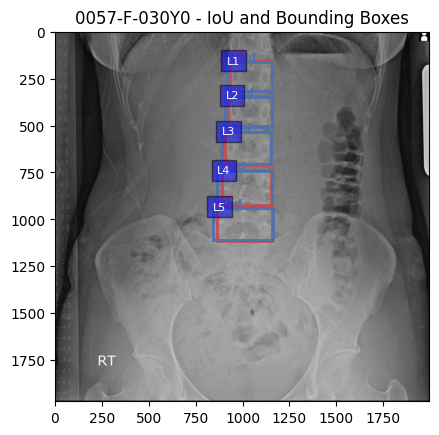

0059-F-028Y0의 클래스 L3에 대한 IOU: 0.90 (Confidence: 0.92)
0059-F-028Y0의 클래스 L2에 대한 IOU: 0.89 (Confidence: 0.92)
0059-F-028Y0의 클래스 L1에 대한 IOU: 0.82 (Confidence: 0.89)
0059-F-028Y0의 클래스 L4에 대한 IOU: 0.94 (Confidence: 0.87)
0059-F-028Y0의 클래스 L5에 대한 IOU: 0.87 (Confidence: 0.84)


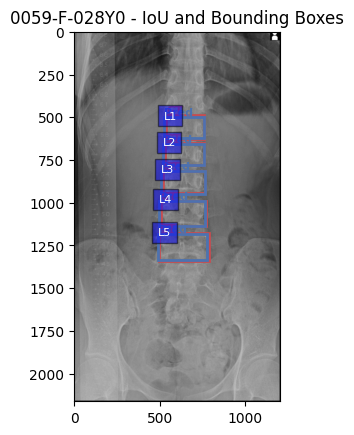

0062-F-041Y0의 클래스 L4에 대한 IOU: 0.44 (Confidence: 0.94)
0062-F-041Y0의 클래스 L2에 대한 IOU: 0.65 (Confidence: 0.93)
0062-F-041Y0의 클래스 L3에 대한 IOU: 0.35 (Confidence: 0.93)
0062-F-041Y0의 클래스 L5에 대한 IOU: 0.75 (Confidence: 0.87)
0062-F-041Y0의 클래스 L1에 대한 IOU: 0.73 (Confidence: 0.84)


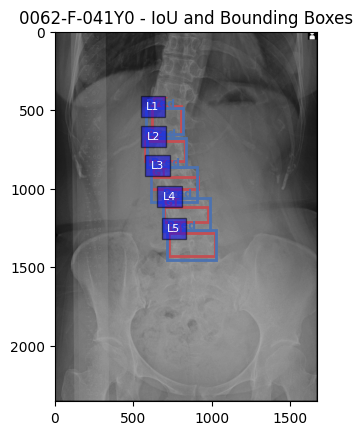

0065-F-032Y0의 클래스 L3에 대한 IOU: 0.70 (Confidence: 0.95)
0065-F-032Y0의 클래스 L2에 대한 IOU: 0.84 (Confidence: 0.94)
0065-F-032Y0의 클래스 L4에 대한 IOU: 0.78 (Confidence: 0.92)
0065-F-032Y0의 클래스 L1에 대한 IOU: 0.80 (Confidence: 0.91)
0065-F-032Y0의 클래스 L5에 대한 IOU: 0.87 (Confidence: 0.88)


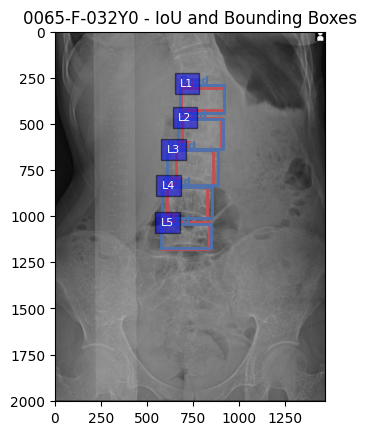

0067-F-028Y0의 클래스 L2에 대한 IOU: 0.91 (Confidence: 0.94)
0067-F-028Y0의 클래스 L3에 대한 IOU: 0.90 (Confidence: 0.93)
0067-F-028Y0의 클래스 L4에 대한 IOU: 0.86 (Confidence: 0.92)
0067-F-028Y0의 클래스 L1에 대한 IOU: 0.93 (Confidence: 0.90)
0067-F-028Y0의 클래스 L5에 대한 IOU: 0.87 (Confidence: 0.85)


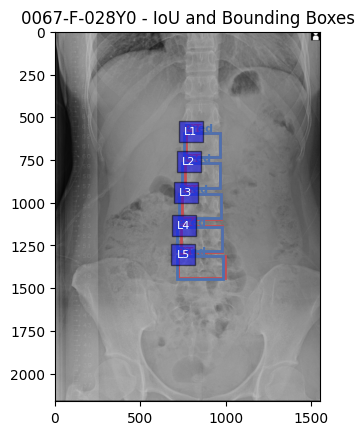

0073-F-036Y0의 클래스 L3에 대한 IOU: 0.90 (Confidence: 0.94)
0073-F-036Y0의 클래스 L2에 대한 IOU: 0.97 (Confidence: 0.94)
0073-F-036Y0의 클래스 L1에 대한 IOU: 0.89 (Confidence: 0.92)
0073-F-036Y0의 클래스 L4에 대한 IOU: 0.91 (Confidence: 0.91)
0073-F-036Y0의 클래스 L5에 대한 IOU: 0.94 (Confidence: 0.85)


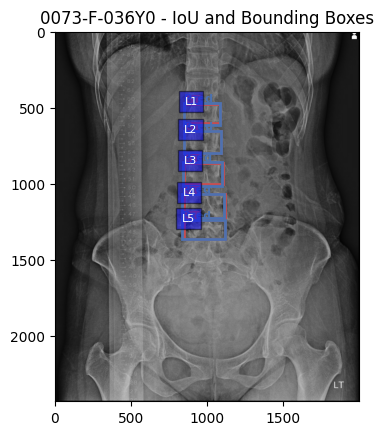

0109-F-042Y0의 클래스 L4에 대한 IOU: 0.67 (Confidence: 0.96)
0109-F-042Y0의 클래스 L3에 대한 IOU: 0.61 (Confidence: 0.94)
0109-F-042Y0의 클래스 L2에 대한 IOU: 0.73 (Confidence: 0.93)
0109-F-042Y0의 클래스 L5에 대한 IOU: 0.81 (Confidence: 0.92)
0109-F-042Y0의 클래스 L1에 대한 IOU: 0.83 (Confidence: 0.83)


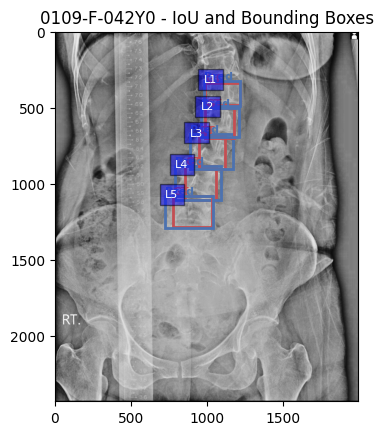

0112-F-064Y0의 클래스 L2에 대한 IOU: 0.89 (Confidence: 0.94)
0112-F-064Y0의 클래스 L1에 대한 IOU: 0.83 (Confidence: 0.93)
0112-F-064Y0의 클래스 L3에 대한 IOU: 0.93 (Confidence: 0.93)
0112-F-064Y0의 클래스 L4에 대한 IOU: 0.93 (Confidence: 0.90)
0112-F-064Y0의 클래스 L5에 대한 IOU: 0.97 (Confidence: 0.80)


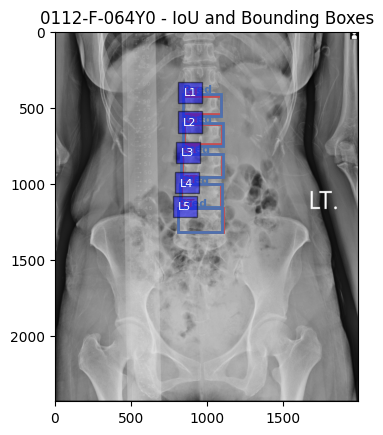

0113-F-082Y0의 클래스 L4에 대한 IOU: 0.52 (Confidence: 0.92)
0113-F-082Y0의 클래스 L5에 대한 IOU: 0.50 (Confidence: 0.87)
0113-F-082Y0의 클래스 L3에 대한 IOU: 0.85 (Confidence: 0.83)
0113-F-082Y0의 클래스 L1에 대한 IOU: 0.00 (Confidence: 0.77)
0113-F-082Y0의 클래스 L1에 대한 IOU: 0.88 (Confidence: 0.72)


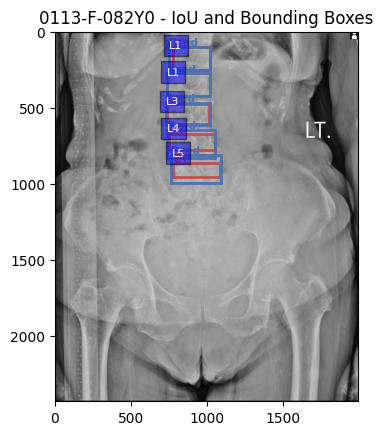

0134-M-038Y0의 클래스 L3에 대한 IOU: 0.00 (Confidence: 0.85)
0134-M-038Y0의 클래스 L1에 대한 IOU: 0.88 (Confidence: 0.84)
0134-M-038Y0의 클래스 L2에 대한 IOU: 0.00 (Confidence: 0.83)
0134-M-038Y0의 클래스 L4에 대한 IOU: 0.00 (Confidence: 0.80)
0134-M-038Y0의 클래스 L1에 대한 IOU: 0.00 (Confidence: 0.80)
0134-M-038Y0의 클래스 L2에 대한 IOU: 0.86 (Confidence: 0.62)


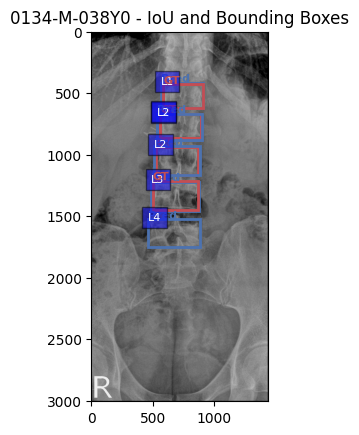

0138-M-064Y0의 클래스 L4에 대한 IOU: 0.85 (Confidence: 0.93)
0138-M-064Y0의 클래스 L3에 대한 IOU: 0.81 (Confidence: 0.93)
0138-M-064Y0의 클래스 L2에 대한 IOU: 0.84 (Confidence: 0.89)
0138-M-064Y0의 클래스 L1에 대한 IOU: 0.84 (Confidence: 0.86)
0138-M-064Y0의 클래스 L5에 대한 IOU: 0.62 (Confidence: 0.84)


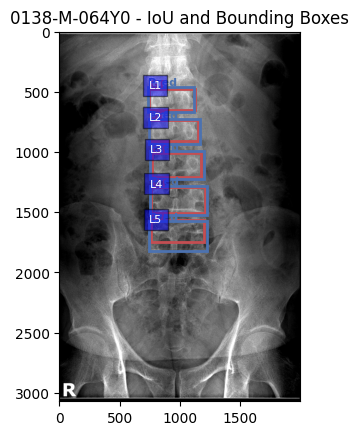

0139-F-077Y0의 클래스 L4에 대한 IOU: 0.84 (Confidence: 0.92)
0139-F-077Y0의 클래스 L3에 대한 IOU: 0.85 (Confidence: 0.90)
0139-F-077Y0의 클래스 L1에 대한 IOU: 0.27 (Confidence: 0.88)
0139-F-077Y0의 클래스 L2에 대한 IOU: 0.30 (Confidence: 0.85)
0139-F-077Y0의 클래스 L5에 대한 IOU: 0.81 (Confidence: 0.85)


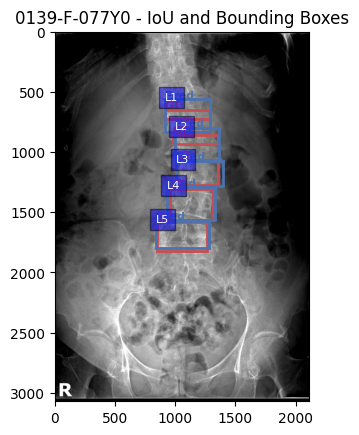

0140-M-024Y0의 클래스 L2에 대한 IOU: 0.79 (Confidence: 0.95)
0140-M-024Y0의 클래스 L3에 대한 IOU: 0.75 (Confidence: 0.94)
0140-M-024Y0의 클래스 L4에 대한 IOU: 0.82 (Confidence: 0.92)
0140-M-024Y0의 클래스 L1에 대한 IOU: 0.78 (Confidence: 0.91)
0140-M-024Y0의 클래스 L5에 대한 IOU: 0.77 (Confidence: 0.89)


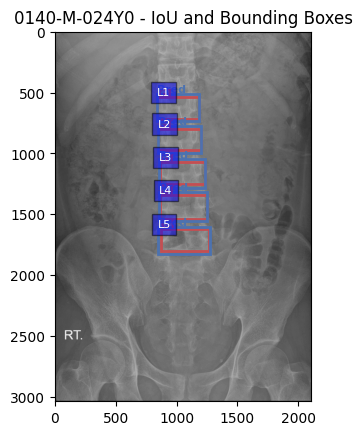

0141-M-055Y0의 클래스 L3에 대한 IOU: 0.91 (Confidence: 0.93)
0141-M-055Y0의 클래스 L4에 대한 IOU: 0.84 (Confidence: 0.91)
0141-M-055Y0의 클래스 L5에 대한 IOU: 0.91 (Confidence: 0.91)
0141-M-055Y0의 클래스 L2에 대한 IOU: 0.87 (Confidence: 0.89)
0141-M-055Y0의 클래스 L1에 대한 IOU: 0.88 (Confidence: 0.83)


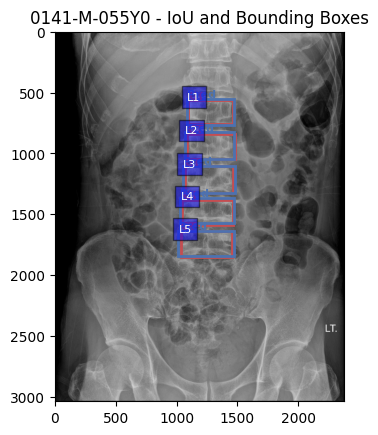

0142-F-051Y0의 클래스 L2에 대한 IOU: 0.89 (Confidence: 0.94)
0142-F-051Y0의 클래스 L3에 대한 IOU: 0.83 (Confidence: 0.93)
0142-F-051Y0의 클래스 L4에 대한 IOU: 0.84 (Confidence: 0.93)
0142-F-051Y0의 클래스 L1에 대한 IOU: 0.83 (Confidence: 0.90)
0142-F-051Y0의 클래스 L5에 대한 IOU: 0.86 (Confidence: 0.89)


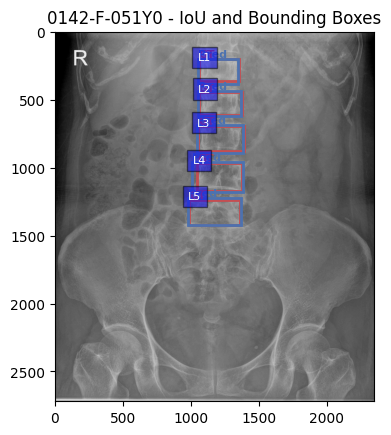

0147-F-086Y0의 클래스 L2에 대한 IOU: 0.66 (Confidence: 0.93)
0147-F-086Y0의 클래스 L3에 대한 IOU: 0.69 (Confidence: 0.92)
0147-F-086Y0의 클래스 L4에 대한 IOU: 0.51 (Confidence: 0.91)
0147-F-086Y0의 클래스 L1에 대한 IOU: 0.87 (Confidence: 0.86)
0147-F-086Y0의 클래스 L5에 대한 IOU: 0.80 (Confidence: 0.80)


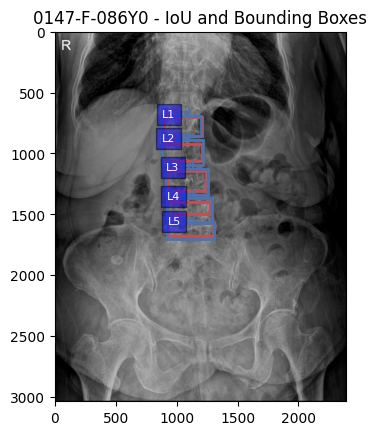

0148-M-058Y0의 클래스 L3에 대한 IOU: 0.88 (Confidence: 0.94)
0148-M-058Y0의 클래스 L4에 대한 IOU: 0.90 (Confidence: 0.94)
0148-M-058Y0의 클래스 L1에 대한 IOU: 0.78 (Confidence: 0.90)
0148-M-058Y0의 클래스 L2에 대한 IOU: 0.79 (Confidence: 0.89)
0148-M-058Y0의 클래스 L5에 대한 IOU: 0.86 (Confidence: 0.84)


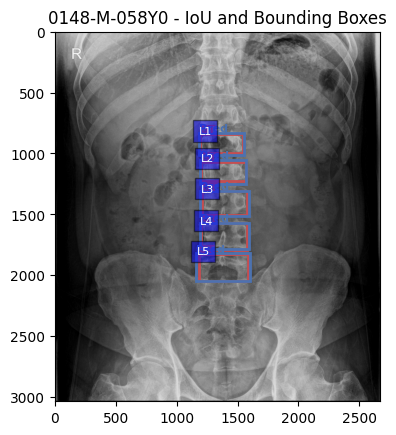

0151-M-079Y0의 클래스 L4에 대한 IOU: 0.89 (Confidence: 0.92)
0151-M-079Y0의 클래스 L1에 대한 IOU: 0.83 (Confidence: 0.91)
0151-M-079Y0의 클래스 L3에 대한 IOU: 0.71 (Confidence: 0.91)
0151-M-079Y0의 클래스 L2에 대한 IOU: 0.80 (Confidence: 0.89)
0151-M-079Y0의 클래스 L5에 대한 IOU: 0.88 (Confidence: 0.88)


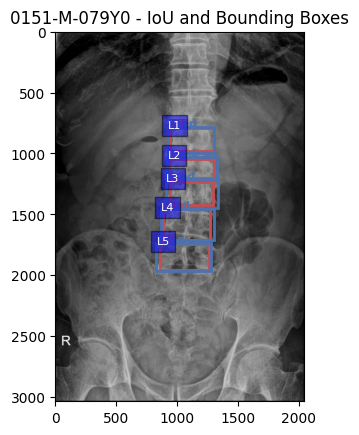

0157-M-060Y0의 클래스 L3에 대한 IOU: 0.92 (Confidence: 0.93)
0157-M-060Y0의 클래스 L4에 대한 IOU: 0.87 (Confidence: 0.93)
0157-M-060Y0의 클래스 L1에 대한 IOU: 0.80 (Confidence: 0.90)
0157-M-060Y0의 클래스 L2에 대한 IOU: 0.92 (Confidence: 0.88)
0157-M-060Y0의 클래스 L5에 대한 IOU: 0.77 (Confidence: 0.83)


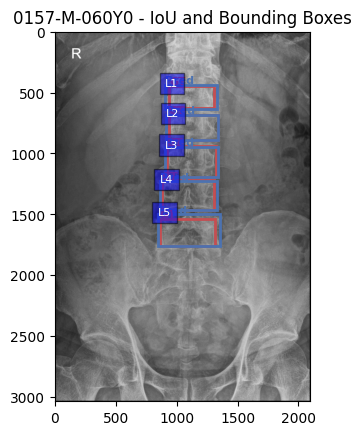

0163-F-053Y0의 클래스 L3에 대한 IOU: 0.85 (Confidence: 0.94)
0163-F-053Y0의 클래스 L2에 대한 IOU: 0.80 (Confidence: 0.92)
0163-F-053Y0의 클래스 L4에 대한 IOU: 0.82 (Confidence: 0.89)
0163-F-053Y0의 클래스 L5에 대한 IOU: 0.84 (Confidence: 0.86)
0163-F-053Y0의 클래스 L1에 대한 IOU: 0.84 (Confidence: 0.86)


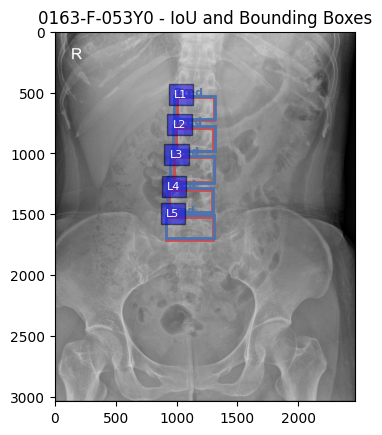

0164-F-064Y0의 클래스 L3에 대한 IOU: 0.81 (Confidence: 0.93)
0164-F-064Y0의 클래스 L4에 대한 IOU: 0.91 (Confidence: 0.92)
0164-F-064Y0의 클래스 L5에 대한 IOU: 0.80 (Confidence: 0.89)
0164-F-064Y0의 클래스 L2에 대한 IOU: 0.76 (Confidence: 0.86)
0164-F-064Y0의 클래스 L1에 대한 IOU: 0.81 (Confidence: 0.86)
0164-F-064Y0의 클래스 L1에 대한 IOU: 0.00 (Confidence: 0.73)


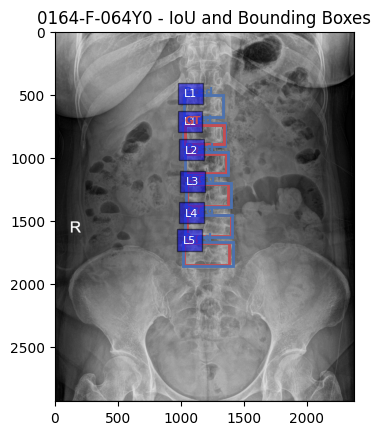

0165-M-078Y0의 클래스 L3에 대한 IOU: 0.84 (Confidence: 0.93)
0165-M-078Y0의 클래스 L4에 대한 IOU: 0.76 (Confidence: 0.92)
0165-M-078Y0의 클래스 L2에 대한 IOU: 0.85 (Confidence: 0.92)
0165-M-078Y0의 클래스 L1에 대한 IOU: 0.85 (Confidence: 0.88)
0165-M-078Y0의 클래스 L5에 대한 IOU: 0.51 (Confidence: 0.86)


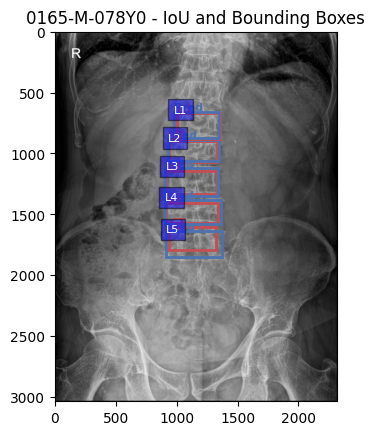

0166-F-071Y0의 클래스 L1에 대한 IOU: 0.84 (Confidence: 0.90)
0166-F-071Y0의 클래스 L2에 대한 IOU: 0.88 (Confidence: 0.90)
0166-F-071Y0의 클래스 L3에 대한 IOU: 0.87 (Confidence: 0.86)
0166-F-071Y0의 클래스 L3에 대한 IOU: 0.00 (Confidence: 0.83)
0166-F-071Y0의 클래스 L5에 대한 IOU: 0.88 (Confidence: 0.71)


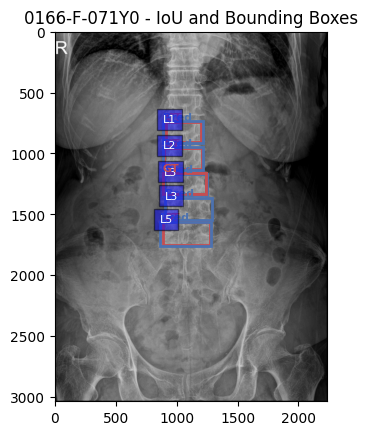

0167-F-049Y0의 클래스 L1에 대한 IOU: 0.90 (Confidence: 0.94)
0167-F-049Y0의 클래스 L3에 대한 IOU: 0.85 (Confidence: 0.94)
0167-F-049Y0의 클래스 L2에 대한 IOU: 0.90 (Confidence: 0.93)
0167-F-049Y0의 클래스 L4에 대한 IOU: 0.83 (Confidence: 0.89)
0167-F-049Y0의 클래스 L5에 대한 IOU: 0.95 (Confidence: 0.89)


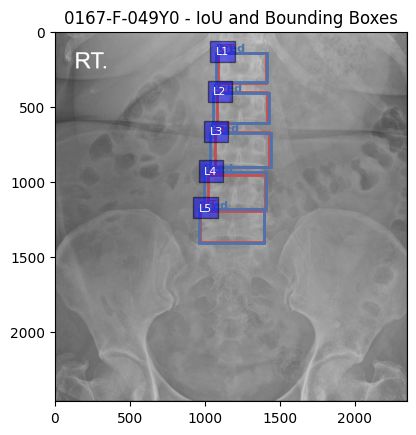

0168-M-055Y0의 클래스 L3에 대한 IOU: 0.69 (Confidence: 0.94)
0168-M-055Y0의 클래스 L2에 대한 IOU: 0.68 (Confidence: 0.93)
0168-M-055Y0의 클래스 L4에 대한 IOU: 0.57 (Confidence: 0.91)
0168-M-055Y0의 클래스 L1에 대한 IOU: 0.78 (Confidence: 0.89)
0168-M-055Y0의 클래스 L5에 대한 IOU: 0.65 (Confidence: 0.85)


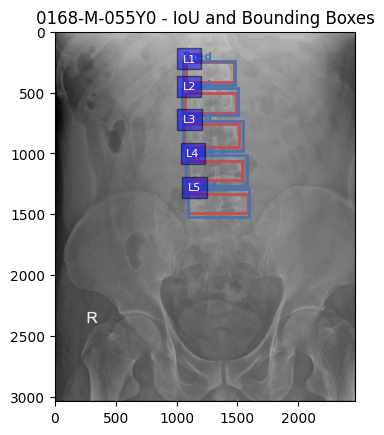

0173-F-079Y0의 클래스 L3에 대한 IOU: 0.28 (Confidence: 0.94)
0173-F-079Y0의 클래스 L4에 대한 IOU: 0.53 (Confidence: 0.91)
0173-F-079Y0의 클래스 L2에 대한 IOU: 0.16 (Confidence: 0.91)
0173-F-079Y0의 클래스 L1에 대한 IOU: 0.60 (Confidence: 0.90)
0173-F-079Y0의 클래스 L5에 대한 IOU: 0.64 (Confidence: 0.80)


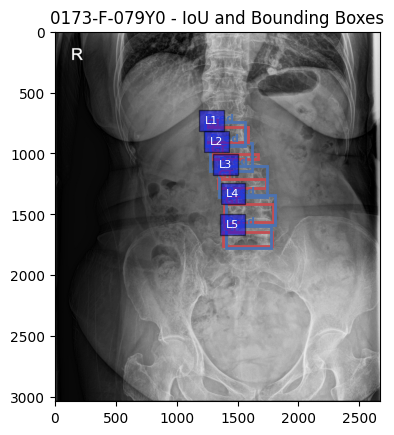

0174-M-063Y0의 클래스 L4에 대한 IOU: 0.73 (Confidence: 0.95)
0174-M-063Y0의 클래스 L3에 대한 IOU: 0.80 (Confidence: 0.93)
0174-M-063Y0의 클래스 L2에 대한 IOU: 0.92 (Confidence: 0.92)
0174-M-063Y0의 클래스 L1에 대한 IOU: 0.92 (Confidence: 0.90)
0174-M-063Y0의 클래스 L5에 대한 IOU: 0.67 (Confidence: 0.80)


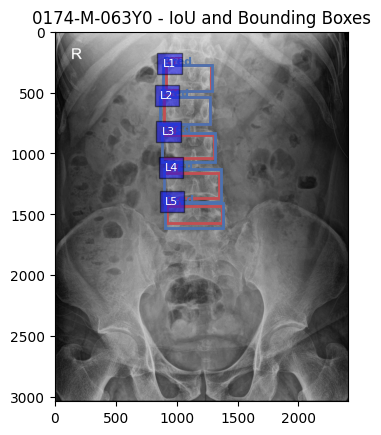

0175-M-053Y0의 클래스 L4에 대한 IOU: 0.89 (Confidence: 0.94)
0175-M-053Y0의 클래스 L2에 대한 IOU: 0.84 (Confidence: 0.94)
0175-M-053Y0의 클래스 L3에 대한 IOU: 0.90 (Confidence: 0.93)
0175-M-053Y0의 클래스 L1에 대한 IOU: 0.85 (Confidence: 0.89)
0175-M-053Y0의 클래스 L5에 대한 IOU: 0.81 (Confidence: 0.84)


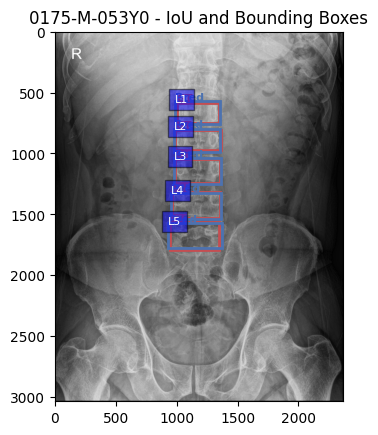

0180-M-082Y0의 클래스 L4에 대한 IOU: 0.56 (Confidence: 0.93)
0180-M-082Y0의 클래스 L3에 대한 IOU: 0.75 (Confidence: 0.93)
0180-M-082Y0의 클래스 L2에 대한 IOU: 0.77 (Confidence: 0.88)
0180-M-082Y0의 클래스 L5에 대한 IOU: 0.52 (Confidence: 0.85)
0180-M-082Y0의 클래스 L1에 대한 IOU: 0.59 (Confidence: 0.85)


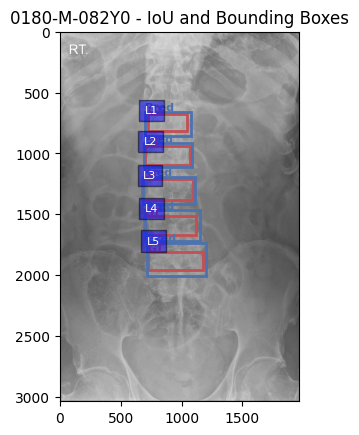

0183-F-080Y0의 클래스 L4에 대한 IOU: 0.89 (Confidence: 0.92)
0183-F-080Y0의 클래스 L3에 대한 IOU: 0.84 (Confidence: 0.92)
0183-F-080Y0의 클래스 L2에 대한 IOU: 0.61 (Confidence: 0.89)
0183-F-080Y0의 클래스 L5에 대한 IOU: 0.84 (Confidence: 0.89)
0183-F-080Y0의 클래스 L1에 대한 IOU: 0.67 (Confidence: 0.87)


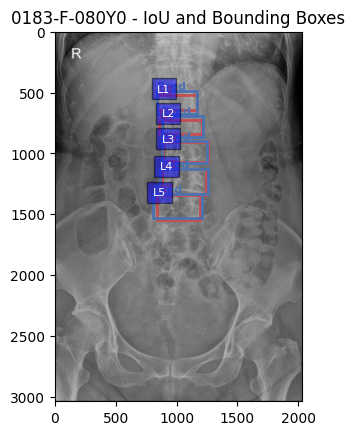

0185-F-073Y0의 클래스 L3에 대한 IOU: 0.85 (Confidence: 0.93)
0185-F-073Y0의 클래스 L2에 대한 IOU: 0.85 (Confidence: 0.91)
0185-F-073Y0의 클래스 L4에 대한 IOU: 0.80 (Confidence: 0.89)
0185-F-073Y0의 클래스 L1에 대한 IOU: 0.91 (Confidence: 0.88)
0185-F-073Y0의 클래스 L5에 대한 IOU: 0.63 (Confidence: 0.80)
0185-F-073Y0의 클래스 L5에 대한 IOU: 0.70 (Confidence: 0.72)


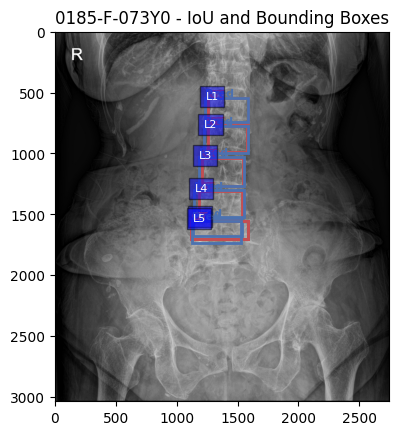

0188-F-066Y0의 클래스 L4에 대한 IOU: 0.86 (Confidence: 0.94)
0188-F-066Y0의 클래스 L3에 대한 IOU: 0.86 (Confidence: 0.93)
0188-F-066Y0의 클래스 L2에 대한 IOU: 0.85 (Confidence: 0.92)
0188-F-066Y0의 클래스 L1에 대한 IOU: 0.78 (Confidence: 0.88)
0188-F-066Y0의 클래스 L5에 대한 IOU: 0.63 (Confidence: 0.86)


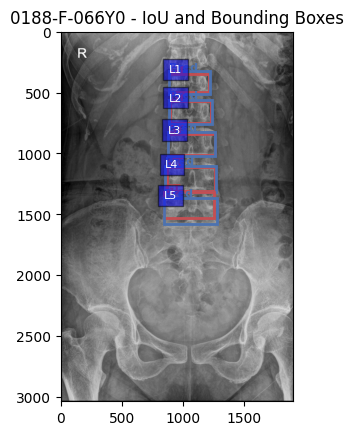

0189-M-068Y0의 클래스 L3에 대한 IOU: 0.81 (Confidence: 0.93)
0189-M-068Y0의 클래스 L2에 대한 IOU: 0.82 (Confidence: 0.92)
0189-M-068Y0의 클래스 L4에 대한 IOU: 0.92 (Confidence: 0.91)
0189-M-068Y0의 클래스 L1에 대한 IOU: 0.82 (Confidence: 0.91)
0189-M-068Y0의 클래스 L5에 대한 IOU: 0.77 (Confidence: 0.91)


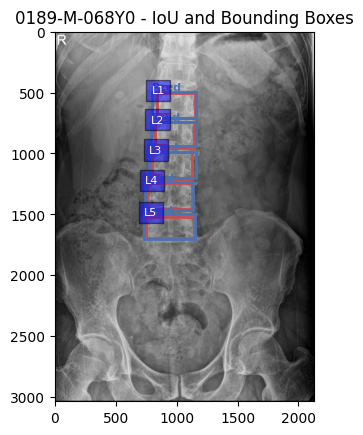

0195-F-064Y0의 클래스 L3에 대한 IOU: 0.86 (Confidence: 0.94)
0195-F-064Y0의 클래스 L4에 대한 IOU: 0.87 (Confidence: 0.94)
0195-F-064Y0의 클래스 L2에 대한 IOU: 0.79 (Confidence: 0.93)
0195-F-064Y0의 클래스 L5에 대한 IOU: 0.81 (Confidence: 0.89)
0195-F-064Y0의 클래스 L1에 대한 IOU: 0.74 (Confidence: 0.88)


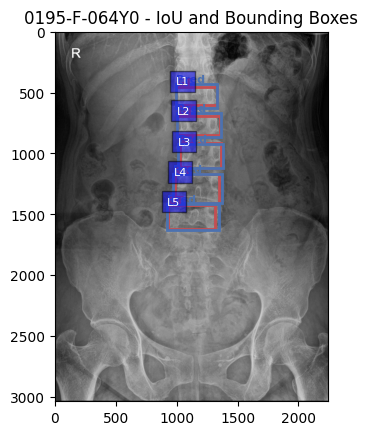

0196-F-051Y0의 클래스 L2에 대한 IOU: 0.76 (Confidence: 0.94)
0196-F-051Y0의 클래스 L4에 대한 IOU: 0.85 (Confidence: 0.94)
0196-F-051Y0의 클래스 L1에 대한 IOU: 0.80 (Confidence: 0.93)
0196-F-051Y0의 클래스 L3에 대한 IOU: 0.80 (Confidence: 0.93)
0196-F-051Y0의 클래스 L5에 대한 IOU: 0.75 (Confidence: 0.88)


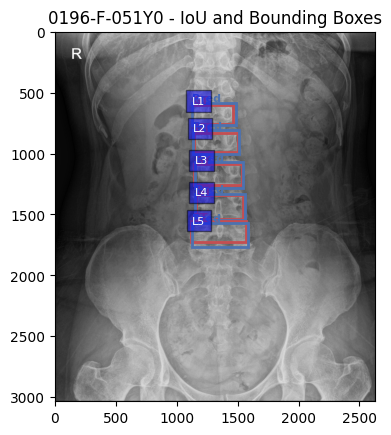

0197-F-077Y0의 클래스 L3에 대한 IOU: 0.69 (Confidence: 0.94)
0197-F-077Y0의 클래스 L4에 대한 IOU: 0.71 (Confidence: 0.90)
0197-F-077Y0의 클래스 L2에 대한 IOU: 0.71 (Confidence: 0.89)
0197-F-077Y0의 클래스 L5에 대한 IOU: 0.90 (Confidence: 0.82)
0197-F-077Y0의 클래스 L1에 대한 IOU: 0.83 (Confidence: 0.69)


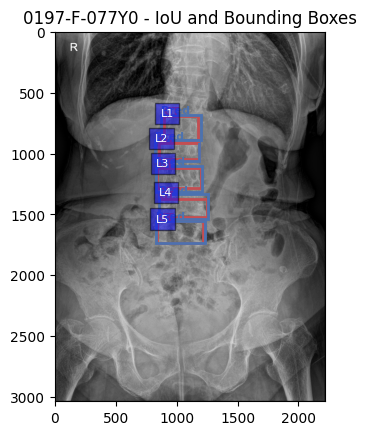

0202-F-068Y0의 클래스 L3에 대한 IOU: 0.85 (Confidence: 0.94)
0202-F-068Y0의 클래스 L4에 대한 IOU: 0.91 (Confidence: 0.93)
0202-F-068Y0의 클래스 L2에 대한 IOU: 0.83 (Confidence: 0.92)
0202-F-068Y0의 클래스 L1에 대한 IOU: 0.85 (Confidence: 0.92)
0202-F-068Y0의 클래스 L5에 대한 IOU: 0.53 (Confidence: 0.85)


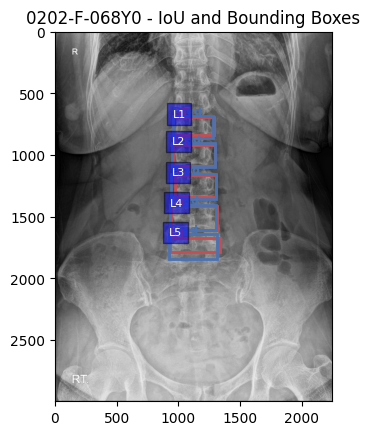

0205-M-063Y0의 클래스 L4에 대한 IOU: 0.72 (Confidence: 0.93)
0205-M-063Y0의 클래스 L5에 대한 IOU: 0.77 (Confidence: 0.90)
0205-M-063Y0의 클래스 L3에 대한 IOU: 0.40 (Confidence: 0.88)
0205-M-063Y0의 클래스 L2에 대한 IOU: 0.56 (Confidence: 0.86)
0205-M-063Y0의 클래스 L1에 대한 IOU: 0.40 (Confidence: 0.81)


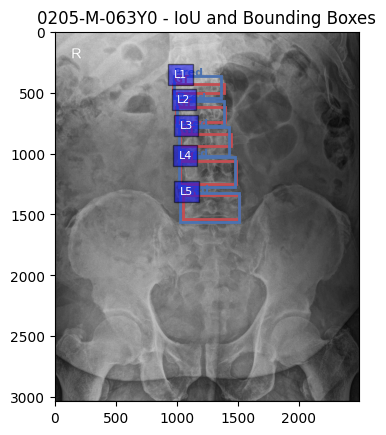

0206-F-070Y0의 클래스 L3에 대한 IOU: 0.86 (Confidence: 0.93)
0206-F-070Y0의 클래스 L4에 대한 IOU: 0.82 (Confidence: 0.93)
0206-F-070Y0의 클래스 L5에 대한 IOU: 0.66 (Confidence: 0.85)
0206-F-070Y0의 클래스 L1에 대한 IOU: 0.70 (Confidence: 0.81)
0206-F-070Y0의 클래스 L2에 대한 IOU: 0.58 (Confidence: 0.80)


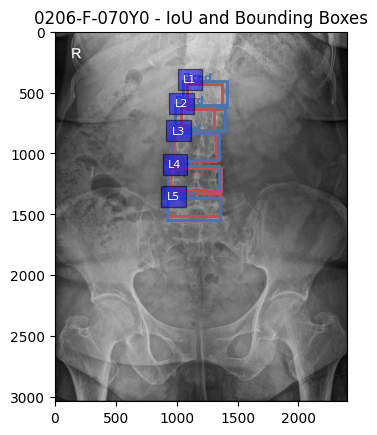

0209-M-072Y0의 클래스 L2에 대한 IOU: 0.72 (Confidence: 0.92)
0209-M-072Y0의 클래스 L4에 대한 IOU: 0.86 (Confidence: 0.92)
0209-M-072Y0의 클래스 L3에 대한 IOU: 0.83 (Confidence: 0.91)
0209-M-072Y0의 클래스 L1에 대한 IOU: 0.82 (Confidence: 0.88)
0209-M-072Y0의 클래스 L5에 대한 IOU: 0.73 (Confidence: 0.77)


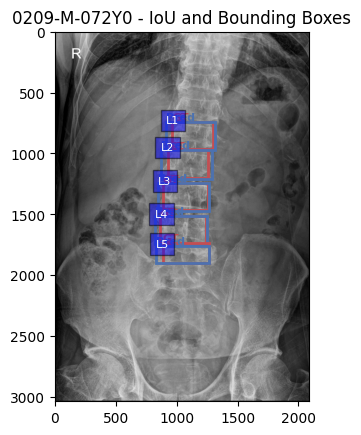

0211-F-055Y0의 클래스 L4에 대한 IOU: 0.87 (Confidence: 0.93)
0211-F-055Y0의 클래스 L3에 대한 IOU: 0.84 (Confidence: 0.93)
0211-F-055Y0의 클래스 L2에 대한 IOU: 0.88 (Confidence: 0.91)
0211-F-055Y0의 클래스 L1에 대한 IOU: 0.85 (Confidence: 0.90)
0211-F-055Y0의 클래스 L5에 대한 IOU: 0.47 (Confidence: 0.87)


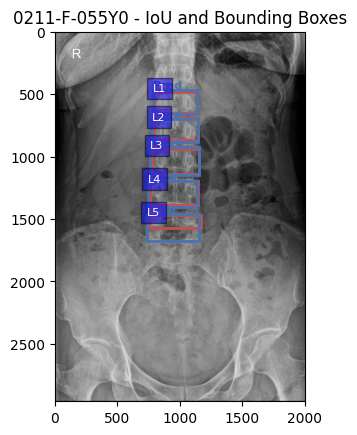

0214-F-072Y0의 클래스 L4에 대한 IOU: 0.71 (Confidence: 0.93)
0214-F-072Y0의 클래스 L3에 대한 IOU: 0.63 (Confidence: 0.93)
0214-F-072Y0의 클래스 L2에 대한 IOU: 0.67 (Confidence: 0.92)
0214-F-072Y0의 클래스 L1에 대한 IOU: 0.81 (Confidence: 0.89)
0214-F-072Y0의 클래스 L5에 대한 IOU: 0.80 (Confidence: 0.86)


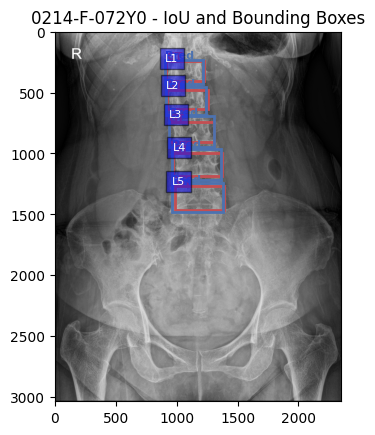

0220-F-069Y0의 클래스 L3에 대한 IOU: 0.00 (Confidence: 0.93)
0220-F-069Y0의 클래스 L4에 대한 IOU: 0.00 (Confidence: 0.90)
0220-F-069Y0의 클래스 L5에 대한 IOU: 0.00 (Confidence: 0.88)
0220-F-069Y0의 클래스 L3에 대한 IOU: 0.53 (Confidence: 0.87)
0220-F-069Y0의 클래스 L2에 대한 IOU: 0.83 (Confidence: 0.86)
0220-F-069Y0의 클래스 L1에 대한 IOU: 0.00 (Confidence: 0.65)


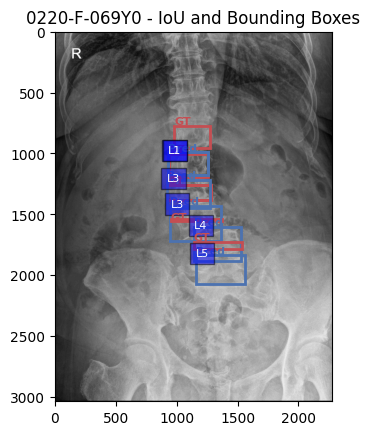

0223-F-063Y0의 클래스 L3에 대한 IOU: 0.11 (Confidence: 0.94)
0223-F-063Y0의 클래스 L1에 대한 IOU: 0.20 (Confidence: 0.90)
0223-F-063Y0의 클래스 L4에 대한 IOU: 0.55 (Confidence: 0.88)
0223-F-063Y0의 클래스 L2에 대한 IOU: 0.12 (Confidence: 0.88)
0223-F-063Y0의 클래스 L5에 대한 IOU: 0.81 (Confidence: 0.87)


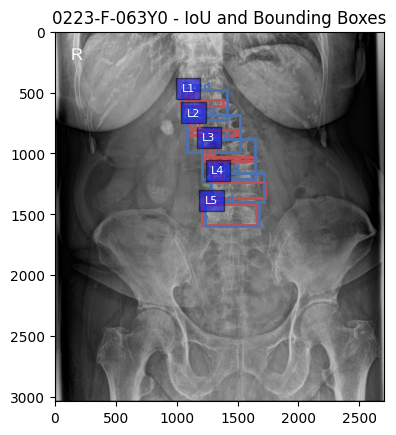

0225-M-086Y0의 클래스 L1에 대한 IOU: 0.71 (Confidence: 0.93)
0225-M-086Y0의 클래스 L3에 대한 IOU: 0.62 (Confidence: 0.93)
0225-M-086Y0의 클래스 L2에 대한 IOU: 0.56 (Confidence: 0.91)
0225-M-086Y0의 클래스 L4에 대한 IOU: 0.66 (Confidence: 0.89)
0225-M-086Y0의 클래스 L5에 대한 IOU: 0.77 (Confidence: 0.81)


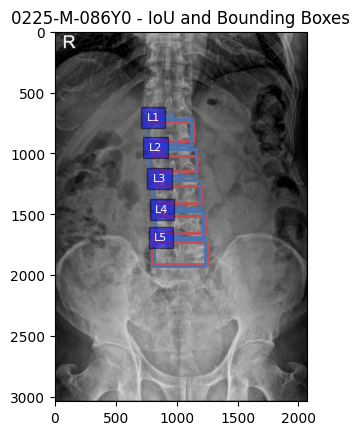

0226-M-060Y0의 클래스 L3에 대한 IOU: 0.83 (Confidence: 0.93)
0226-M-060Y0의 클래스 L2에 대한 IOU: 0.65 (Confidence: 0.93)
0226-M-060Y0의 클래스 L4에 대한 IOU: 0.84 (Confidence: 0.90)
0226-M-060Y0의 클래스 L1에 대한 IOU: 0.85 (Confidence: 0.88)
0226-M-060Y0의 클래스 L5에 대한 IOU: 0.81 (Confidence: 0.87)


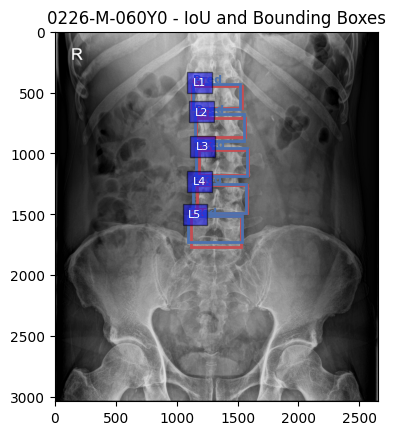

0228-F-057Y0의 클래스 L3에 대한 IOU: 0.76 (Confidence: 0.94)
0228-F-057Y0의 클래스 L4에 대한 IOU: 0.83 (Confidence: 0.93)
0228-F-057Y0의 클래스 L2에 대한 IOU: 0.73 (Confidence: 0.89)
0228-F-057Y0의 클래스 L5에 대한 IOU: 0.90 (Confidence: 0.88)
0228-F-057Y0의 클래스 L1에 대한 IOU: 0.69 (Confidence: 0.86)


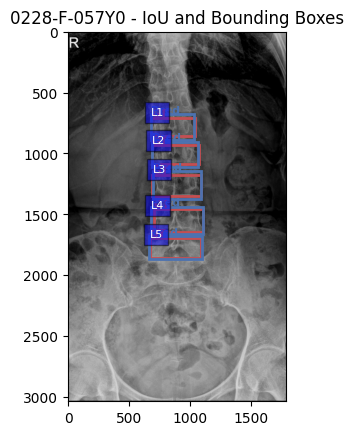

0229-F-078Y0의 클래스 L1에 대한 IOU: 0.58 (Confidence: 0.91)
0229-F-078Y0의 클래스 L3에 대한 IOU: 0.78 (Confidence: 0.88)
0229-F-078Y0의 클래스 L4에 대한 IOU: 0.46 (Confidence: 0.85)
0229-F-078Y0의 클래스 L3에 대한 IOU: 0.00 (Confidence: 0.83)
0229-F-078Y0의 클래스 L4에 대한 IOU: 0.00 (Confidence: 0.73)
0229-F-078Y0의 클래스 L2에 대한 IOU: 0.56 (Confidence: 0.70)
0229-F-078Y0의 클래스 L5에 대한 IOU: 0.35 (Confidence: 0.68)


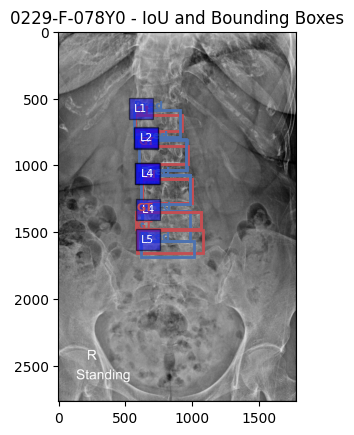

0238-F-067Y0의 클래스 L3에 대한 IOU: 0.45 (Confidence: 0.93)
0238-F-067Y0의 클래스 L4에 대한 IOU: 0.41 (Confidence: 0.92)
0238-F-067Y0의 클래스 L2에 대한 IOU: 0.84 (Confidence: 0.90)
0238-F-067Y0의 클래스 L5에 대한 IOU: 0.66 (Confidence: 0.88)
0238-F-067Y0의 클래스 L1에 대한 IOU: 0.75 (Confidence: 0.87)


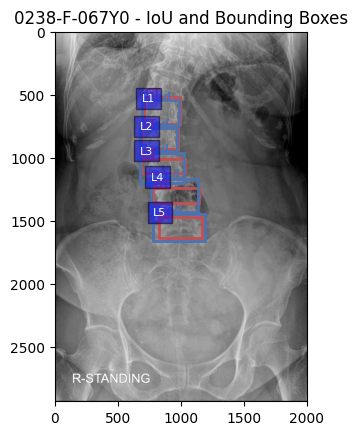

0247-F-063Y0의 클래스 L2에 대한 IOU: 0.88 (Confidence: 0.94)
0247-F-063Y0의 클래스 L4에 대한 IOU: 0.81 (Confidence: 0.93)
0247-F-063Y0의 클래스 L3에 대한 IOU: 0.87 (Confidence: 0.92)
0247-F-063Y0의 클래스 L1에 대한 IOU: 0.93 (Confidence: 0.91)
0247-F-063Y0의 클래스 L5에 대한 IOU: 0.76 (Confidence: 0.88)


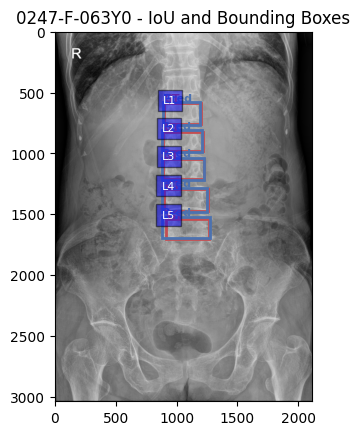

0248-F-058Y0의 클래스 L3에 대한 IOU: 0.80 (Confidence: 0.93)
0248-F-058Y0의 클래스 L4에 대한 IOU: 0.67 (Confidence: 0.92)
0248-F-058Y0의 클래스 L2에 대한 IOU: 0.90 (Confidence: 0.91)
0248-F-058Y0의 클래스 L1에 대한 IOU: 0.81 (Confidence: 0.90)
0248-F-058Y0의 클래스 L5에 대한 IOU: 0.61 (Confidence: 0.88)


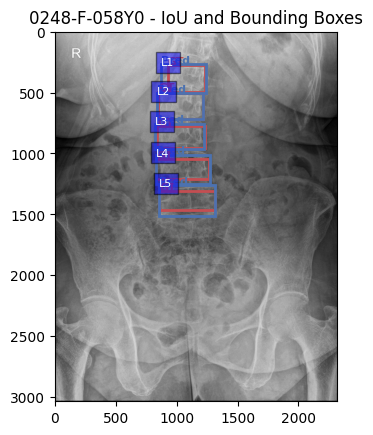

0255-F-053Y0의 클래스 L3에 대한 IOU: 0.86 (Confidence: 0.94)
0255-F-053Y0의 클래스 L2에 대한 IOU: 0.89 (Confidence: 0.93)
0255-F-053Y0의 클래스 L4에 대한 IOU: 0.86 (Confidence: 0.92)
0255-F-053Y0의 클래스 L1에 대한 IOU: 0.90 (Confidence: 0.92)
0255-F-053Y0의 클래스 L5에 대한 IOU: 0.77 (Confidence: 0.90)


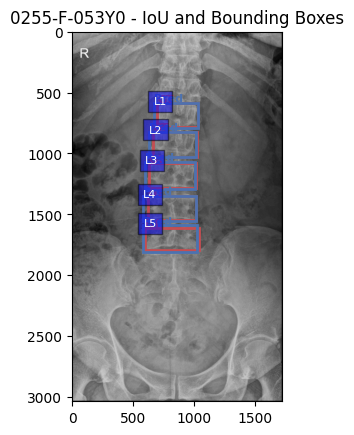

0272-M-035Y0의 클래스 L2에 대한 IOU: 0.74 (Confidence: 0.93)
0272-M-035Y0의 클래스 L4에 대한 IOU: 0.75 (Confidence: 0.93)
0272-M-035Y0의 클래스 L3에 대한 IOU: 0.70 (Confidence: 0.93)
0272-M-035Y0의 클래스 L1에 대한 IOU: 0.79 (Confidence: 0.92)
0272-M-035Y0의 클래스 L5에 대한 IOU: 0.66 (Confidence: 0.79)


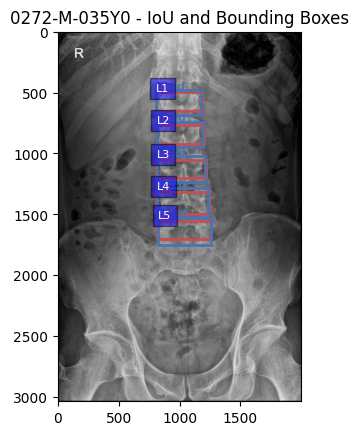

0279-M-043Y0의 클래스 L3에 대한 IOU: 0.86 (Confidence: 0.93)
0279-M-043Y0의 클래스 L4에 대한 IOU: 0.92 (Confidence: 0.93)
0279-M-043Y0의 클래스 L1에 대한 IOU: 0.92 (Confidence: 0.93)
0279-M-043Y0의 클래스 L2에 대한 IOU: 0.88 (Confidence: 0.92)
0279-M-043Y0의 클래스 L5에 대한 IOU: 0.90 (Confidence: 0.88)


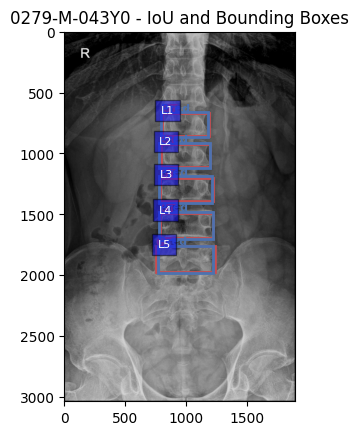

0379-M-040Y0의 클래스 L2에 대한 IOU: 0.90 (Confidence: 0.95)
0379-M-040Y0의 클래스 L4에 대한 IOU: 0.90 (Confidence: 0.93)
0379-M-040Y0의 클래스 L3에 대한 IOU: 0.92 (Confidence: 0.93)
0379-M-040Y0의 클래스 L1에 대한 IOU: 0.90 (Confidence: 0.90)
0379-M-040Y0의 클래스 L5에 대한 IOU: 0.88 (Confidence: 0.83)


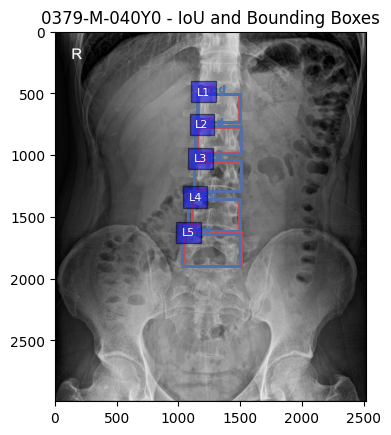

0391-M-046Y0의 클래스 L2에 대한 IOU: 0.86 (Confidence: 0.94)
0391-M-046Y0의 클래스 L3에 대한 IOU: 0.94 (Confidence: 0.93)
0391-M-046Y0의 클래스 L1에 대한 IOU: 0.62 (Confidence: 0.91)
0391-M-046Y0의 클래스 L4에 대한 IOU: 0.87 (Confidence: 0.76)
0391-M-046Y0의 클래스 L5에 대한 IOU: 0.02 (Confidence: 0.67)


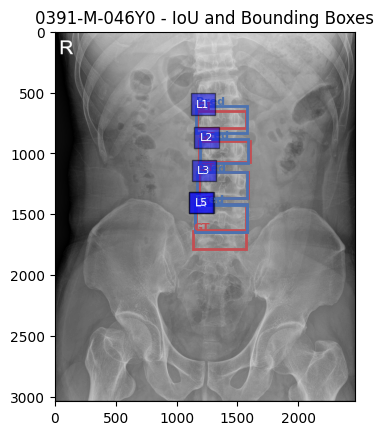

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image

# 클래스 이름 정의
class_labels = {0: 'L1', 1: 'L2', 2: 'L3', 3: 'L4', 4: 'L5'}

iou_threshold = 0.6  # 신뢰도 임계값 (confidence score)

for result in results:
    preds = result.boxes.xyxy.cpu().numpy()  # 예측된 바운딩 박스 좌표
    pred_classes_batch = result.boxes.cls.cpu().numpy()  # 예측된 클래스
    confidences_batch = result.boxes.conf.cpu().numpy()  # 예측된 confidence score
    image_path = result.path
    image_name = os.path.basename(image_path)
    image_name_no_ext = os.path.splitext(image_name)[0]

    # 이미지를 로드
    img = Image.open(image_path)

    gt_row = ap_df[ap_df['filename'] == image_name_no_ext]
    if not gt_row.empty:
        gt_boxes = {}
        for i in range(1, 6):  # 각 클래스의 실제 바운딩 박스 정보 가져오기
            gt_box = [
                gt_row[f'L{i}a_1c'].values[0],
                gt_row[f'L{i}a_1r'].values[0],
                gt_row[f'L{i}b_2c'].values[0],
                gt_row[f'L{i}b_2r'].values[0]
            ]
            gt_boxes[i - 1] = gt_box

        # 이미지 시각화 준비
        fig, ax = plt.subplots(1)
        ax.imshow(img, cmap='gray')  # 이미지를 흑백으로 표시

        # 예측된 바운딩 박스와 ground truth 바운딩 박스를 그려줌
        for pred_box, pred_class, conf in zip(preds, pred_classes_batch, confidences_batch):
            if conf >= iou_threshold:  # 신뢰도 임계값 0.6 이상인 경우만 처리
                if pred_class in gt_boxes:
                    gt_box = gt_boxes[pred_class]
                    iou_value = calculate_iou(gt_box, pred_box)

                    # Ground truth 박스 그리기 (빨간색) 및 'GT' 레이블 추가
                    gt_rect = patches.Rectangle((gt_box[0], gt_box[1]), gt_box[2] - gt_box[0], gt_box[3] - gt_box[1],
                                                linewidth=2, edgecolor='r', facecolor='none')
                    ax.add_patch(gt_rect)
                    ax.text(gt_box[0], gt_box[1] - 10, 'GT', color='r', fontsize=8, fontweight='bold')

                    # 예측 박스 그리기 (파란색) 및 'Pred' 레이블 추가
                    pred_rect = patches.Rectangle((pred_box[0], pred_box[1]), pred_box[2] - pred_box[0], pred_box[3] - pred_box[1],
                                                  linewidth=2, edgecolor='b', facecolor='none')
                    ax.add_patch(pred_rect)
                    ax.text(pred_box[0], pred_box[1] - 10, 'Pred', color='b', fontsize=8, fontweight='bold')

                    # 클래스 이름 추가 (예: L1, L2 등)
                    class_label = class_labels.get(int(pred_class), 'Unknown')
                    ax.text(pred_box[0], pred_box[1] + 10, class_label, color='white', fontsize=8, bbox=dict(facecolor='blue', alpha=0.5))

                    # IoU 값을 출력
                    print(f"{image_name_no_ext}의 클래스 {class_label}에 대한 IOU: {iou_value:.2f} (Confidence: {conf:.2f})")

        # 이미지 출력
        plt.title(f"{image_name_no_ext} - IoU and Bounding Boxes")
        plt.show()


In [ ]:
import pandas as pd
import numpy as np

# 우선 데이터 저장할 딕셔너리 초기화
iou_dict = {}

# 각 클래스별로 IoU 값을 저장
for image_name, pred_class, iou_value in zip(image_names, pred_classes, iou_values):
    if image_name not in iou_dict:
        # 이미지 이름이 처음 등장하면 해당 이미지의 클래스별 iou를 빈 값으로 초기화
        iou_dict[image_name] = {'L1': np.nan, 'L2': np.nan, 'L3': np.nan, 'L4': np.nan, 'L5': np.nan}

    # 예측된 클래스에 따라 해당 클래스의 IoU 값 업데이트
    iou_dict[image_name][f'L{int(pred_class) + 1}'] = max(iou_dict[image_name].get(f'L{int(pred_class) + 1}', np.nan), iou_value)

# 딕셔너리를 DataFrame으로 변환
df = pd.DataFrame.from_dict(iou_dict, orient='index').reset_index()

# 'index' 열을 'image_name'으로 변경
df.rename(columns={'index': 'image_name'}, inplace=True)

# CSV 파일로 저장
df.to_csv('/content/drive/MyDrive/IOU_YOLO+RCNN/iou_results.csv', index=False)

print("CSV 파일로 저장되었습니다.")


CSV 파일로 저장되었습니다.


0001-F-037Y0의 클래스 L3에 대한 IOU: 0.90 (Confidence: 0.94)
0001-F-037Y0의 클래스 L4에 대한 IOU: 0.89 (Confidence: 0.93)
0001-F-037Y0의 클래스 L2에 대한 IOU: 0.87 (Confidence: 0.91)
0001-F-037Y0의 클래스 L1에 대한 IOU: 0.85 (Confidence: 0.90)
0001-F-037Y0의 클래스 L5에 대한 IOU: 0.84 (Confidence: 0.87)


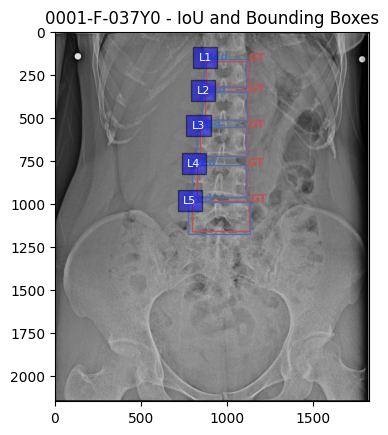

0004-F-010Y0의 클래스 L2에 대한 IOU: 0.85 (Confidence: 0.93)
0004-F-010Y0의 클래스 L3에 대한 IOU: 0.83 (Confidence: 0.90)
0004-F-010Y0의 클래스 L1에 대한 IOU: 0.87 (Confidence: 0.90)
0004-F-010Y0의 클래스 L4에 대한 IOU: 0.68 (Confidence: 0.89)
0004-F-010Y0의 클래스 L5에 대한 IOU: 0.80 (Confidence: 0.73)


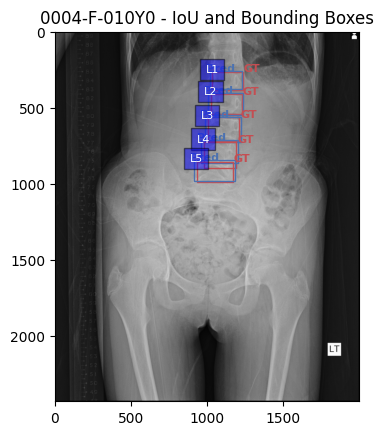

0008-M-022Y0의 클래스 L2에 대한 IOU: 0.90 (Confidence: 0.95)
0008-M-022Y0의 클래스 L3에 대한 IOU: 0.85 (Confidence: 0.94)
0008-M-022Y0의 클래스 L1에 대한 IOU: 0.91 (Confidence: 0.93)
0008-M-022Y0의 클래스 L4에 대한 IOU: 0.84 (Confidence: 0.92)
0008-M-022Y0의 클래스 L5에 대한 IOU: 0.83 (Confidence: 0.86)


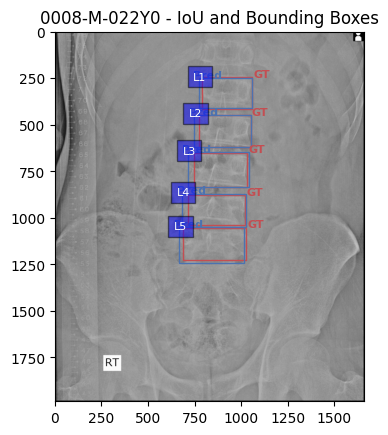

0009-F-038Y0의 클래스 L3에 대한 IOU: 0.57 (Confidence: 0.95)
0009-F-038Y0의 클래스 L4에 대한 IOU: 0.65 (Confidence: 0.95)
0009-F-038Y0의 클래스 L2에 대한 IOU: 0.69 (Confidence: 0.90)
0009-F-038Y0의 클래스 L1에 대한 IOU: 0.90 (Confidence: 0.89)
0009-F-038Y0의 클래스 L5에 대한 IOU: 0.76 (Confidence: 0.88)


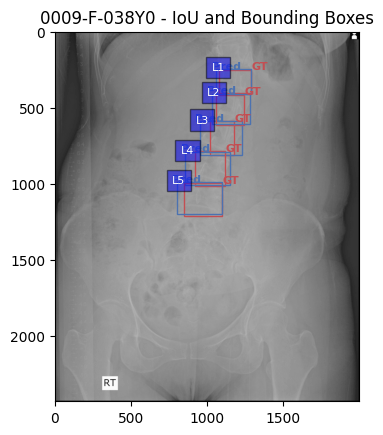

0011-F-063Y0의 클래스 L2에 대한 IOU: 0.27 (Confidence: 0.94)
0011-F-063Y0의 클래스 L4에 대한 IOU: 0.32 (Confidence: 0.93)
0011-F-063Y0의 클래스 L3에 대한 IOU: 0.18 (Confidence: 0.93)
0011-F-063Y0의 클래스 L1에 대한 IOU: 0.67 (Confidence: 0.91)
0011-F-063Y0의 클래스 L5에 대한 IOU: 0.78 (Confidence: 0.89)


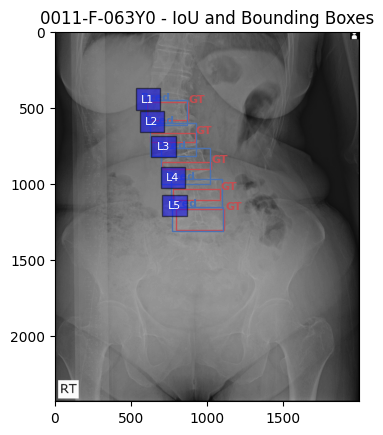

0012-F-013Y0의 클래스 L3에 대한 IOU: 0.91 (Confidence: 0.93)
0012-F-013Y0의 클래스 L4에 대한 IOU: 0.87 (Confidence: 0.91)
0012-F-013Y0의 클래스 L2에 대한 IOU: 0.92 (Confidence: 0.91)
0012-F-013Y0의 클래스 L5에 대한 IOU: 0.79 (Confidence: 0.87)
0012-F-013Y0의 클래스 L1에 대한 IOU: 0.81 (Confidence: 0.85)


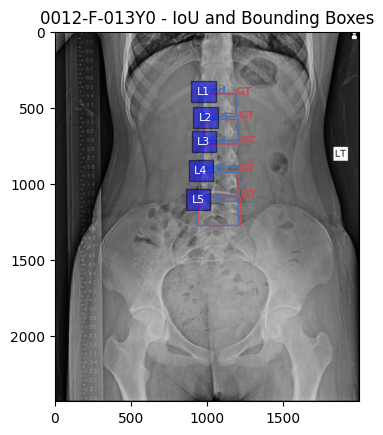

0015-M-020Y0의 클래스 L4에 대한 IOU: 0.78 (Confidence: 0.94)
0015-M-020Y0의 클래스 L3에 대한 IOU: 0.90 (Confidence: 0.93)
0015-M-020Y0의 클래스 L2에 대한 IOU: 0.52 (Confidence: 0.92)
0015-M-020Y0의 클래스 L1에 대한 IOU: 0.21 (Confidence: 0.90)
0015-M-020Y0의 클래스 L5에 대한 IOU: 0.69 (Confidence: 0.87)


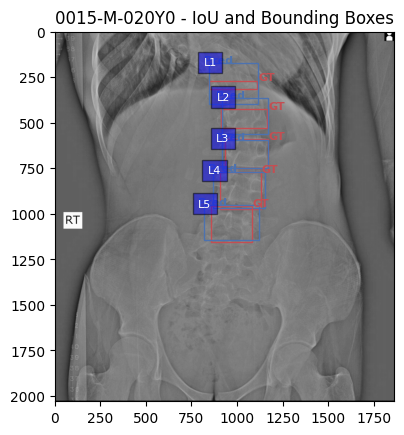

0016-F-023Y0의 클래스 L2에 대한 IOU: 0.62 (Confidence: 0.95)
0016-F-023Y0의 클래스 L3에 대한 IOU: 0.85 (Confidence: 0.94)
0016-F-023Y0의 클래스 L4에 대한 IOU: 0.89 (Confidence: 0.93)
0016-F-023Y0의 클래스 L1에 대한 IOU: 0.57 (Confidence: 0.90)
0016-F-023Y0의 클래스 L5에 대한 IOU: 0.76 (Confidence: 0.87)


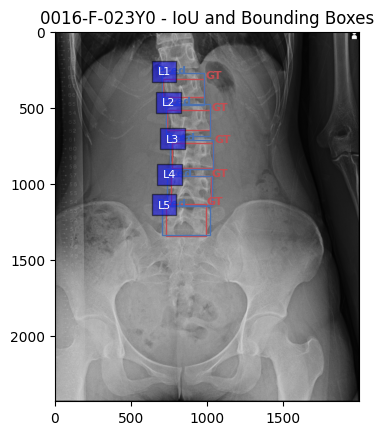

0020-M-030Y0의 클래스 L4에 대한 IOU: 0.92 (Confidence: 0.94)
0020-M-030Y0의 클래스 L3에 대한 IOU: 0.92 (Confidence: 0.94)
0020-M-030Y0의 클래스 L2에 대한 IOU: 0.90 (Confidence: 0.94)
0020-M-030Y0의 클래스 L1에 대한 IOU: 0.88 (Confidence: 0.90)
0020-M-030Y0의 클래스 L5에 대한 IOU: 0.83 (Confidence: 0.83)


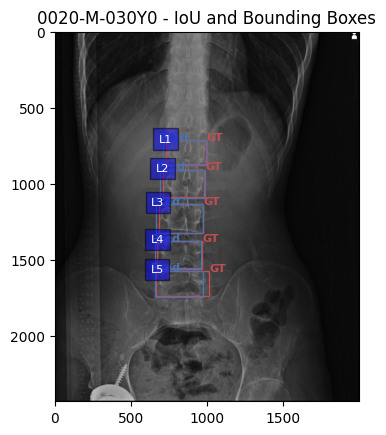

0022-M-006Y0의 클래스 L4에 대한 IOU: 0.75 (Confidence: 0.93)
0022-M-006Y0의 클래스 L2에 대한 IOU: 0.73 (Confidence: 0.87)
0022-M-006Y0의 클래스 L3에 대한 IOU: 0.79 (Confidence: 0.87)
0022-M-006Y0의 클래스 L1에 대한 IOU: 0.71 (Confidence: 0.85)
0022-M-006Y0의 클래스 L5에 대한 IOU: 0.67 (Confidence: 0.82)


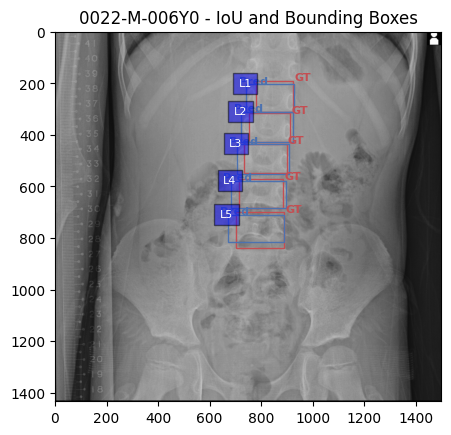

0023-F-014Y0의 클래스 L3에 대한 IOU: 0.89 (Confidence: 0.93)
0023-F-014Y0의 클래스 L2에 대한 IOU: 0.90 (Confidence: 0.93)
0023-F-014Y0의 클래스 L4에 대한 IOU: 0.89 (Confidence: 0.91)
0023-F-014Y0의 클래스 L1에 대한 IOU: 0.89 (Confidence: 0.91)
0023-F-014Y0의 클래스 L5에 대한 IOU: 0.85 (Confidence: 0.83)


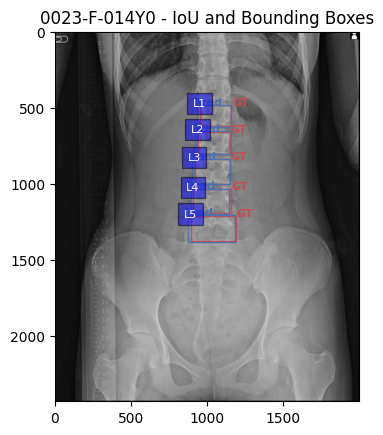

0025-F-015Y0의 클래스 L3에 대한 IOU: 0.45 (Confidence: 0.91)
0025-F-015Y0의 클래스 L2에 대한 IOU: 0.66 (Confidence: 0.88)
0025-F-015Y0의 클래스 L1에 대한 IOU: 0.88 (Confidence: 0.87)
0025-F-015Y0의 클래스 L4에 대한 IOU: 0.62 (Confidence: 0.80)
0025-F-015Y0의 클래스 L4에 대한 IOU: 0.07 (Confidence: 0.71)


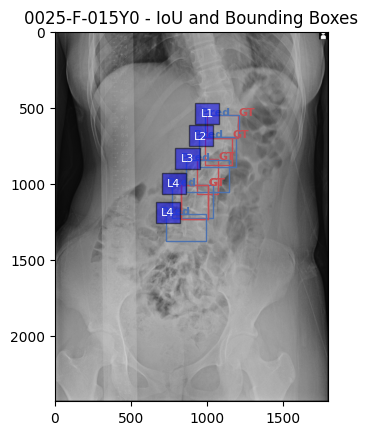

0026-F-029Y0의 클래스 L3에 대한 IOU: 0.66 (Confidence: 0.94)
0026-F-029Y0의 클래스 L4에 대한 IOU: 0.63 (Confidence: 0.94)
0026-F-029Y0의 클래스 L2에 대한 IOU: 0.87 (Confidence: 0.93)
0026-F-029Y0의 클래스 L5에 대한 IOU: 0.72 (Confidence: 0.89)
0026-F-029Y0의 클래스 L1에 대한 IOU: 0.87 (Confidence: 0.87)


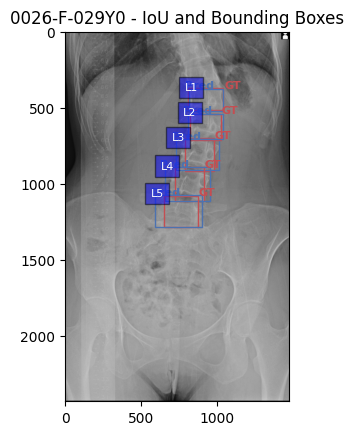

0028-F-041Y0의 클래스 L4에 대한 IOU: 0.84 (Confidence: 0.91)
0028-F-041Y0의 클래스 L3에 대한 IOU: 0.00 (Confidence: 0.87)
0028-F-041Y0의 클래스 L3에 대한 IOU: 0.92 (Confidence: 0.84)
0028-F-041Y0의 클래스 L4에 대한 IOU: 0.00 (Confidence: 0.82)
0028-F-041Y0의 클래스 L2에 대한 IOU: 0.00 (Confidence: 0.81)
0028-F-041Y0의 클래스 L5에 대한 IOU: 0.50 (Confidence: 0.68)
0028-F-041Y0의 클래스 L1에 대한 IOU: 0.00 (Confidence: 0.65)


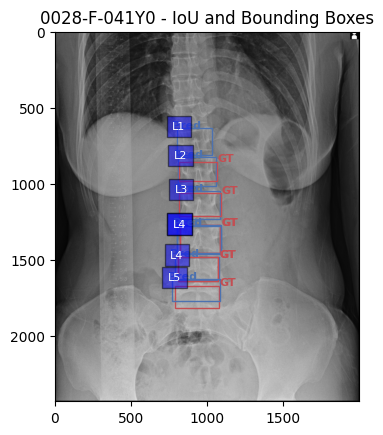

0032-F-007Y0의 클래스 L3에 대한 IOU: 0.90 (Confidence: 0.91)
0032-F-007Y0의 클래스 L1에 대한 IOU: 0.71 (Confidence: 0.89)
0032-F-007Y0의 클래스 L2에 대한 IOU: 0.80 (Confidence: 0.89)
0032-F-007Y0의 클래스 L4에 대한 IOU: 0.82 (Confidence: 0.88)
0032-F-007Y0의 클래스 L5에 대한 IOU: 0.86 (Confidence: 0.76)


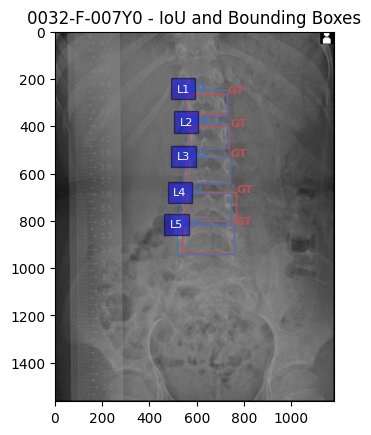

0034-F-067Y0의 클래스 L3에 대한 IOU: 0.88 (Confidence: 0.91)
0034-F-067Y0의 클래스 L4에 대한 IOU: 0.82 (Confidence: 0.89)
0034-F-067Y0의 클래스 L2에 대한 IOU: 0.83 (Confidence: 0.86)
0034-F-067Y0의 클래스 L1에 대한 IOU: 0.76 (Confidence: 0.84)
0034-F-067Y0의 클래스 L5에 대한 IOU: 0.73 (Confidence: 0.77)


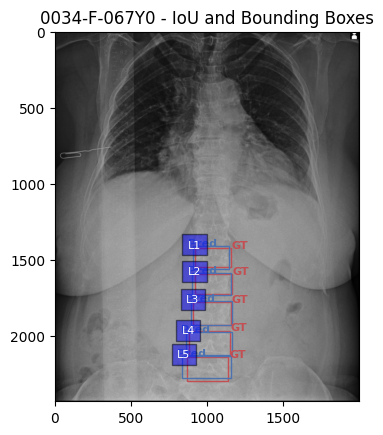

0037-F-019Y0의 클래스 L3에 대한 IOU: 0.65 (Confidence: 0.93)
0037-F-019Y0의 클래스 L2에 대한 IOU: 0.78 (Confidence: 0.93)
0037-F-019Y0의 클래스 L4에 대한 IOU: 0.60 (Confidence: 0.91)
0037-F-019Y0의 클래스 L1에 대한 IOU: 0.94 (Confidence: 0.86)
0037-F-019Y0의 클래스 L5에 대한 IOU: 0.71 (Confidence: 0.75)


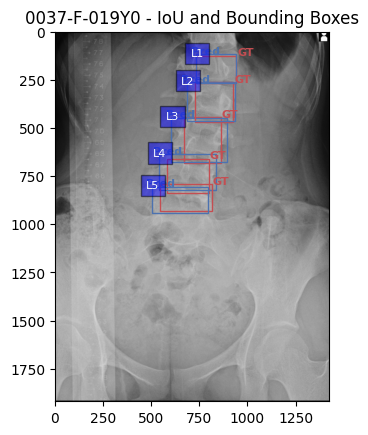

0038-F-020Y0의 클래스 L2에 대한 IOU: 0.73 (Confidence: 0.94)
0038-F-020Y0의 클래스 L3에 대한 IOU: 0.91 (Confidence: 0.94)
0038-F-020Y0의 클래스 L4에 대한 IOU: 0.85 (Confidence: 0.91)
0038-F-020Y0의 클래스 L1에 대한 IOU: 0.66 (Confidence: 0.91)
0038-F-020Y0의 클래스 L5에 대한 IOU: 0.85 (Confidence: 0.86)


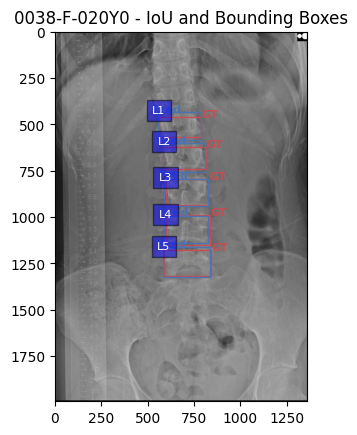

0040-M-023Y0의 클래스 L4에 대한 IOU: 0.81 (Confidence: 0.93)
0040-M-023Y0의 클래스 L3에 대한 IOU: 0.89 (Confidence: 0.93)
0040-M-023Y0의 클래스 L2에 대한 IOU: 0.84 (Confidence: 0.92)
0040-M-023Y0의 클래스 L5에 대한 IOU: 0.81 (Confidence: 0.86)
0040-M-023Y0의 클래스 L1에 대한 IOU: 0.76 (Confidence: 0.84)


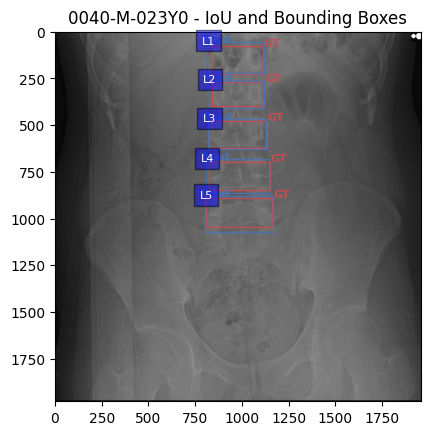

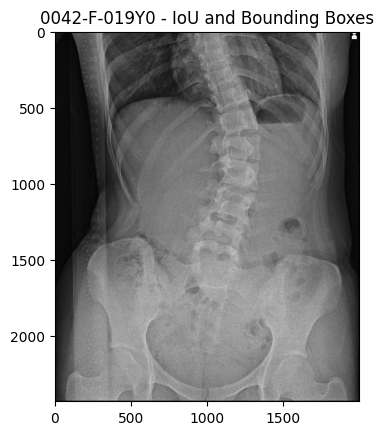

0043-F-039Y0의 클래스 L4에 대한 IOU: 0.65 (Confidence: 0.96)
0043-F-039Y0의 클래스 L3에 대한 IOU: 0.58 (Confidence: 0.93)
0043-F-039Y0의 클래스 L2에 대한 IOU: 0.70 (Confidence: 0.93)
0043-F-039Y0의 클래스 L5에 대한 IOU: 0.75 (Confidence: 0.90)
0043-F-039Y0의 클래스 L1에 대한 IOU: 0.80 (Confidence: 0.90)


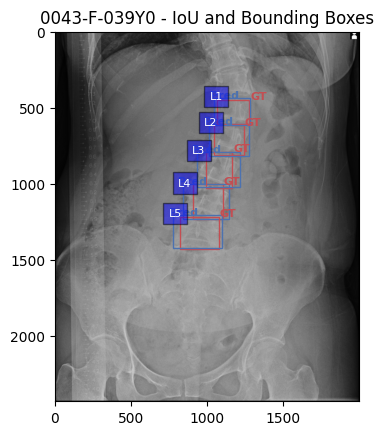

0046-F-021Y0의 클래스 L2에 대한 IOU: 0.57 (Confidence: 0.95)
0046-F-021Y0의 클래스 L3에 대한 IOU: 0.87 (Confidence: 0.93)
0046-F-021Y0의 클래스 L4에 대한 IOU: 0.86 (Confidence: 0.92)
0046-F-021Y0의 클래스 L1에 대한 IOU: 0.36 (Confidence: 0.91)
0046-F-021Y0의 클래스 L5에 대한 IOU: 0.84 (Confidence: 0.85)


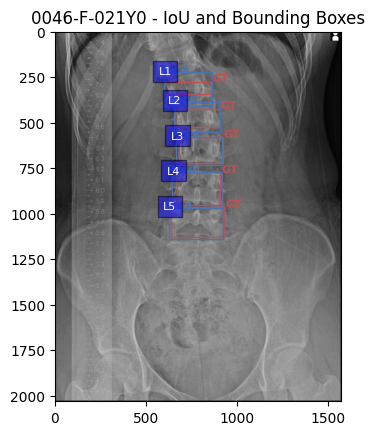

0048-F-020Y0의 클래스 L3에 대한 IOU: 0.81 (Confidence: 0.95)
0048-F-020Y0의 클래스 L2에 대한 IOU: 0.89 (Confidence: 0.93)
0048-F-020Y0의 클래스 L4에 대한 IOU: 0.85 (Confidence: 0.91)
0048-F-020Y0의 클래스 L1에 대한 IOU: 0.89 (Confidence: 0.90)
0048-F-020Y0의 클래스 L5에 대한 IOU: 0.84 (Confidence: 0.75)


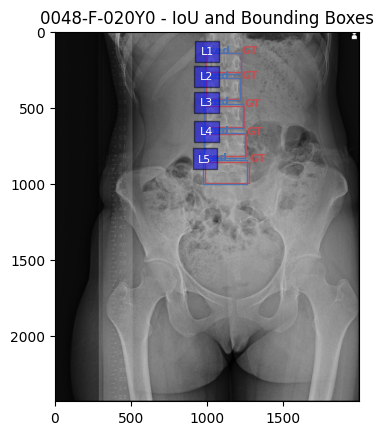

0054-F-079Y0의 클래스 L2에 대한 IOU: 0.81 (Confidence: 0.94)
0054-F-079Y0의 클래스 L3에 대한 IOU: 0.71 (Confidence: 0.94)
0054-F-079Y0의 클래스 L4에 대한 IOU: 0.57 (Confidence: 0.91)
0054-F-079Y0의 클래스 L1에 대한 IOU: 0.88 (Confidence: 0.90)
0054-F-079Y0의 클래스 L5에 대한 IOU: 0.47 (Confidence: 0.80)


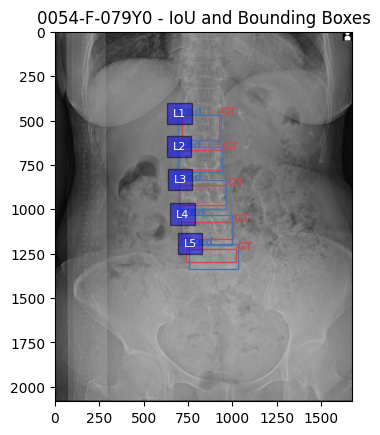

0056-F-069Y0의 클래스 L2에 대한 IOU: 0.92 (Confidence: 0.93)
0056-F-069Y0의 클래스 L3에 대한 IOU: 0.45 (Confidence: 0.93)
0056-F-069Y0의 클래스 L1에 대한 IOU: 0.79 (Confidence: 0.90)
0056-F-069Y0의 클래스 L4에 대한 IOU: 0.31 (Confidence: 0.88)
0056-F-069Y0의 클래스 L5에 대한 IOU: 0.67 (Confidence: 0.80)


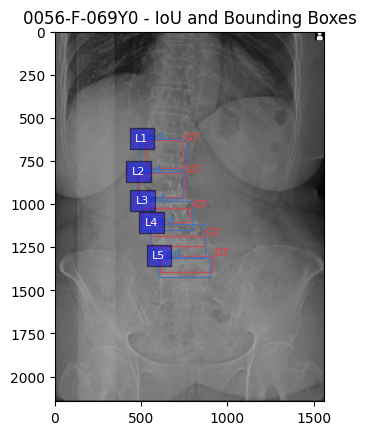

0057-F-030Y0의 클래스 L2에 대한 IOU: 0.92 (Confidence: 0.94)
0057-F-030Y0의 클래스 L3에 대한 IOU: 0.91 (Confidence: 0.93)
0057-F-030Y0의 클래스 L4에 대한 IOU: 0.86 (Confidence: 0.93)
0057-F-030Y0의 클래스 L1에 대한 IOU: 0.90 (Confidence: 0.90)
0057-F-030Y0의 클래스 L5에 대한 IOU: 0.84 (Confidence: 0.83)


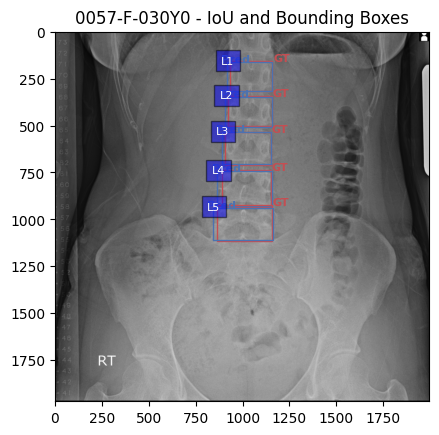

0059-F-028Y0의 클래스 L3에 대한 IOU: 0.90 (Confidence: 0.92)
0059-F-028Y0의 클래스 L2에 대한 IOU: 0.89 (Confidence: 0.92)
0059-F-028Y0의 클래스 L1에 대한 IOU: 0.82 (Confidence: 0.89)
0059-F-028Y0의 클래스 L4에 대한 IOU: 0.94 (Confidence: 0.87)
0059-F-028Y0의 클래스 L5에 대한 IOU: 0.87 (Confidence: 0.84)


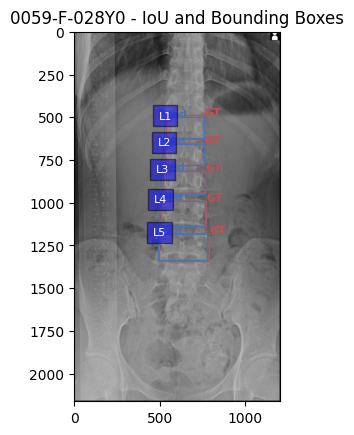

0062-F-041Y0의 클래스 L4에 대한 IOU: 0.44 (Confidence: 0.94)
0062-F-041Y0의 클래스 L2에 대한 IOU: 0.65 (Confidence: 0.93)
0062-F-041Y0의 클래스 L3에 대한 IOU: 0.35 (Confidence: 0.93)
0062-F-041Y0의 클래스 L5에 대한 IOU: 0.75 (Confidence: 0.87)
0062-F-041Y0의 클래스 L1에 대한 IOU: 0.73 (Confidence: 0.84)


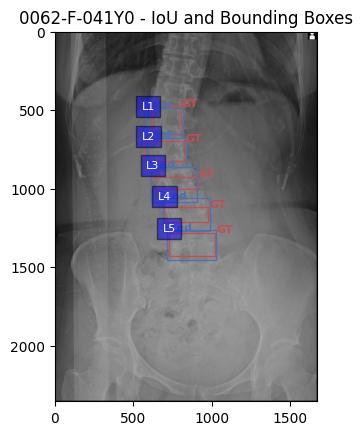

0065-F-032Y0의 클래스 L3에 대한 IOU: 0.70 (Confidence: 0.95)
0065-F-032Y0의 클래스 L2에 대한 IOU: 0.84 (Confidence: 0.94)
0065-F-032Y0의 클래스 L4에 대한 IOU: 0.78 (Confidence: 0.92)
0065-F-032Y0의 클래스 L1에 대한 IOU: 0.80 (Confidence: 0.91)
0065-F-032Y0의 클래스 L5에 대한 IOU: 0.87 (Confidence: 0.88)


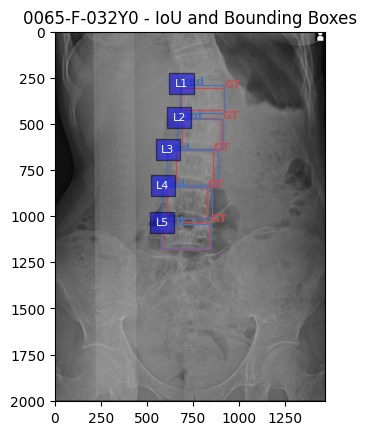

0067-F-028Y0의 클래스 L2에 대한 IOU: 0.91 (Confidence: 0.94)
0067-F-028Y0의 클래스 L3에 대한 IOU: 0.90 (Confidence: 0.93)
0067-F-028Y0의 클래스 L4에 대한 IOU: 0.86 (Confidence: 0.92)
0067-F-028Y0의 클래스 L1에 대한 IOU: 0.93 (Confidence: 0.90)
0067-F-028Y0의 클래스 L5에 대한 IOU: 0.87 (Confidence: 0.85)


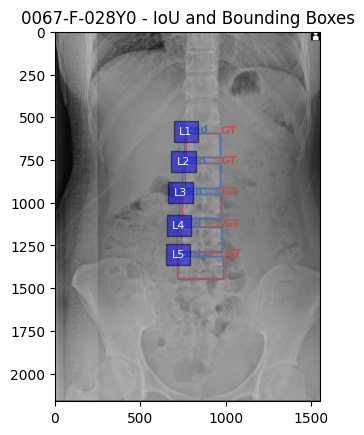

0073-F-036Y0의 클래스 L3에 대한 IOU: 0.90 (Confidence: 0.94)
0073-F-036Y0의 클래스 L2에 대한 IOU: 0.97 (Confidence: 0.94)
0073-F-036Y0의 클래스 L1에 대한 IOU: 0.89 (Confidence: 0.92)
0073-F-036Y0의 클래스 L4에 대한 IOU: 0.91 (Confidence: 0.91)
0073-F-036Y0의 클래스 L5에 대한 IOU: 0.94 (Confidence: 0.85)


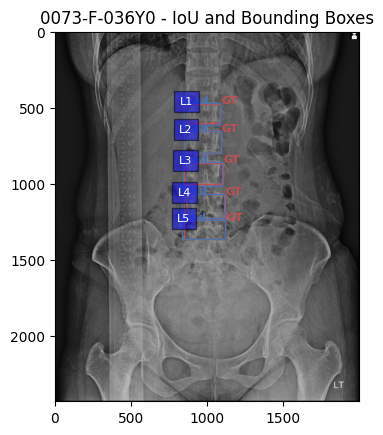

0109-F-042Y0의 클래스 L4에 대한 IOU: 0.67 (Confidence: 0.96)
0109-F-042Y0의 클래스 L3에 대한 IOU: 0.61 (Confidence: 0.94)
0109-F-042Y0의 클래스 L2에 대한 IOU: 0.73 (Confidence: 0.93)
0109-F-042Y0의 클래스 L5에 대한 IOU: 0.81 (Confidence: 0.92)
0109-F-042Y0의 클래스 L1에 대한 IOU: 0.83 (Confidence: 0.83)


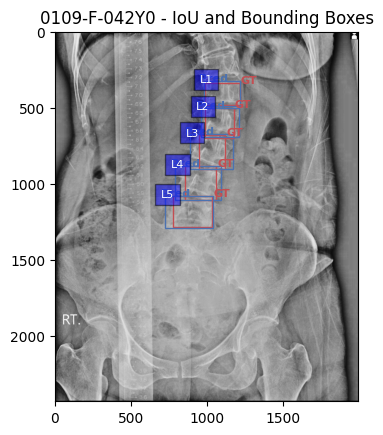

0112-F-064Y0의 클래스 L2에 대한 IOU: 0.89 (Confidence: 0.94)
0112-F-064Y0의 클래스 L1에 대한 IOU: 0.83 (Confidence: 0.93)
0112-F-064Y0의 클래스 L3에 대한 IOU: 0.93 (Confidence: 0.93)
0112-F-064Y0의 클래스 L4에 대한 IOU: 0.93 (Confidence: 0.90)
0112-F-064Y0의 클래스 L5에 대한 IOU: 0.97 (Confidence: 0.80)


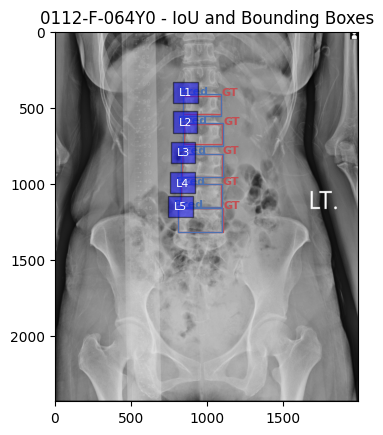

0113-F-082Y0의 클래스 L4에 대한 IOU: 0.52 (Confidence: 0.92)
0113-F-082Y0의 클래스 L5에 대한 IOU: 0.50 (Confidence: 0.87)
0113-F-082Y0의 클래스 L3에 대한 IOU: 0.85 (Confidence: 0.83)
0113-F-082Y0의 클래스 L1에 대한 IOU: 0.00 (Confidence: 0.77)
0113-F-082Y0의 클래스 L1에 대한 IOU: 0.88 (Confidence: 0.72)


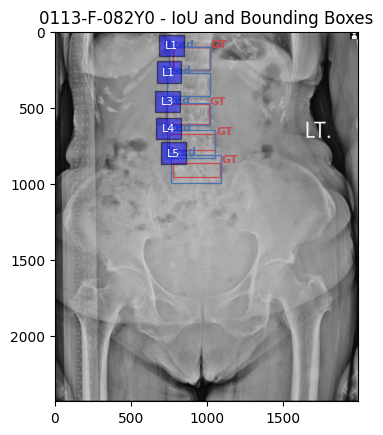

0134-M-038Y0의 클래스 L3에 대한 IOU: 0.00 (Confidence: 0.85)
0134-M-038Y0의 클래스 L1에 대한 IOU: 0.88 (Confidence: 0.84)
0134-M-038Y0의 클래스 L2에 대한 IOU: 0.00 (Confidence: 0.83)
0134-M-038Y0의 클래스 L4에 대한 IOU: 0.00 (Confidence: 0.80)
0134-M-038Y0의 클래스 L1에 대한 IOU: 0.00 (Confidence: 0.80)
0134-M-038Y0의 클래스 L2에 대한 IOU: 0.86 (Confidence: 0.62)


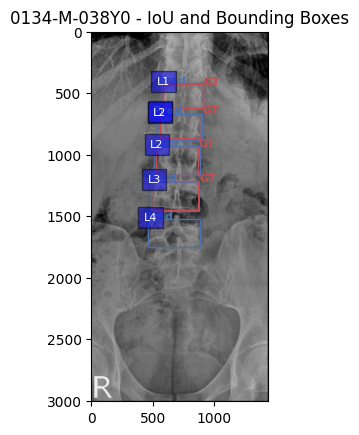

0138-M-064Y0의 클래스 L4에 대한 IOU: 0.85 (Confidence: 0.93)
0138-M-064Y0의 클래스 L3에 대한 IOU: 0.81 (Confidence: 0.93)
0138-M-064Y0의 클래스 L2에 대한 IOU: 0.84 (Confidence: 0.89)
0138-M-064Y0의 클래스 L1에 대한 IOU: 0.84 (Confidence: 0.86)
0138-M-064Y0의 클래스 L5에 대한 IOU: 0.62 (Confidence: 0.84)


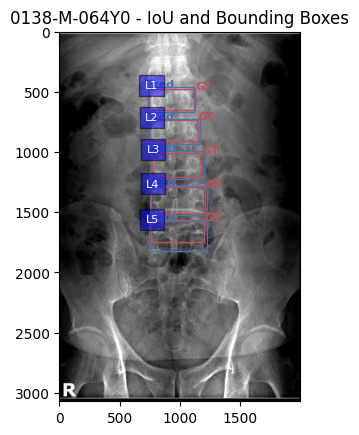

0139-F-077Y0의 클래스 L4에 대한 IOU: 0.84 (Confidence: 0.92)
0139-F-077Y0의 클래스 L3에 대한 IOU: 0.85 (Confidence: 0.90)
0139-F-077Y0의 클래스 L1에 대한 IOU: 0.27 (Confidence: 0.88)
0139-F-077Y0의 클래스 L2에 대한 IOU: 0.30 (Confidence: 0.85)
0139-F-077Y0의 클래스 L5에 대한 IOU: 0.81 (Confidence: 0.85)


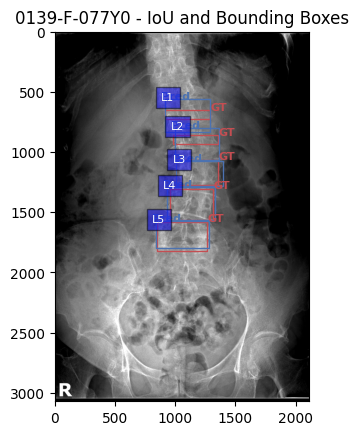

0140-M-024Y0의 클래스 L2에 대한 IOU: 0.79 (Confidence: 0.95)
0140-M-024Y0의 클래스 L3에 대한 IOU: 0.75 (Confidence: 0.94)
0140-M-024Y0의 클래스 L4에 대한 IOU: 0.82 (Confidence: 0.92)
0140-M-024Y0의 클래스 L1에 대한 IOU: 0.78 (Confidence: 0.91)
0140-M-024Y0의 클래스 L5에 대한 IOU: 0.77 (Confidence: 0.89)


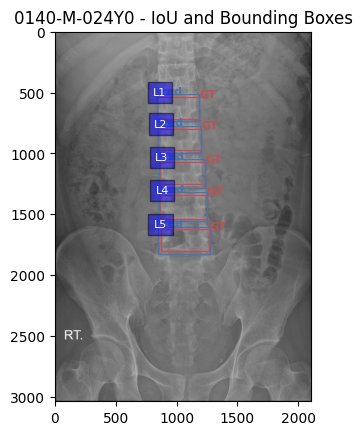

0141-M-055Y0의 클래스 L3에 대한 IOU: 0.91 (Confidence: 0.93)
0141-M-055Y0의 클래스 L4에 대한 IOU: 0.84 (Confidence: 0.91)
0141-M-055Y0의 클래스 L5에 대한 IOU: 0.91 (Confidence: 0.91)
0141-M-055Y0의 클래스 L2에 대한 IOU: 0.87 (Confidence: 0.89)
0141-M-055Y0의 클래스 L1에 대한 IOU: 0.88 (Confidence: 0.83)


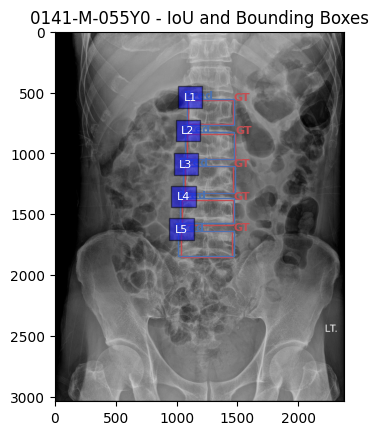

0142-F-051Y0의 클래스 L2에 대한 IOU: 0.89 (Confidence: 0.94)
0142-F-051Y0의 클래스 L3에 대한 IOU: 0.83 (Confidence: 0.93)
0142-F-051Y0의 클래스 L4에 대한 IOU: 0.84 (Confidence: 0.93)
0142-F-051Y0의 클래스 L1에 대한 IOU: 0.83 (Confidence: 0.90)
0142-F-051Y0의 클래스 L5에 대한 IOU: 0.86 (Confidence: 0.89)


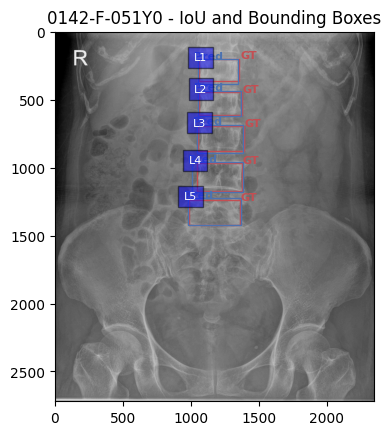

0147-F-086Y0의 클래스 L2에 대한 IOU: 0.66 (Confidence: 0.93)
0147-F-086Y0의 클래스 L3에 대한 IOU: 0.69 (Confidence: 0.92)
0147-F-086Y0의 클래스 L4에 대한 IOU: 0.51 (Confidence: 0.91)
0147-F-086Y0의 클래스 L1에 대한 IOU: 0.87 (Confidence: 0.86)
0147-F-086Y0의 클래스 L5에 대한 IOU: 0.80 (Confidence: 0.80)


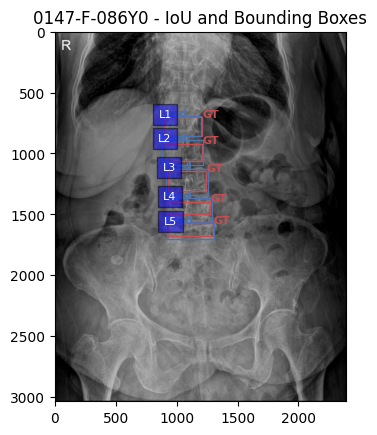

0148-M-058Y0의 클래스 L3에 대한 IOU: 0.88 (Confidence: 0.94)
0148-M-058Y0의 클래스 L4에 대한 IOU: 0.90 (Confidence: 0.94)
0148-M-058Y0의 클래스 L1에 대한 IOU: 0.78 (Confidence: 0.90)
0148-M-058Y0의 클래스 L2에 대한 IOU: 0.79 (Confidence: 0.89)
0148-M-058Y0의 클래스 L5에 대한 IOU: 0.86 (Confidence: 0.84)


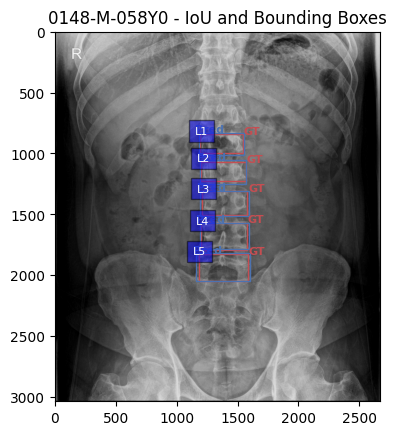

0151-M-079Y0의 클래스 L4에 대한 IOU: 0.89 (Confidence: 0.92)
0151-M-079Y0의 클래스 L1에 대한 IOU: 0.83 (Confidence: 0.91)
0151-M-079Y0의 클래스 L3에 대한 IOU: 0.71 (Confidence: 0.91)
0151-M-079Y0의 클래스 L2에 대한 IOU: 0.80 (Confidence: 0.89)
0151-M-079Y0의 클래스 L5에 대한 IOU: 0.88 (Confidence: 0.88)


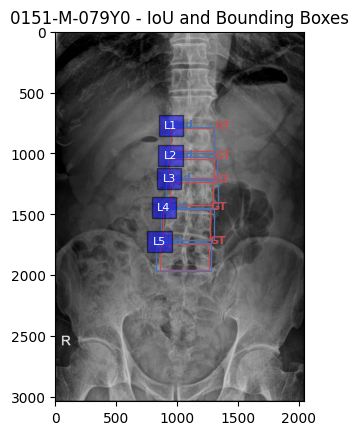

0157-M-060Y0의 클래스 L3에 대한 IOU: 0.92 (Confidence: 0.93)
0157-M-060Y0의 클래스 L4에 대한 IOU: 0.87 (Confidence: 0.93)
0157-M-060Y0의 클래스 L1에 대한 IOU: 0.80 (Confidence: 0.90)
0157-M-060Y0의 클래스 L2에 대한 IOU: 0.92 (Confidence: 0.88)
0157-M-060Y0의 클래스 L5에 대한 IOU: 0.77 (Confidence: 0.83)


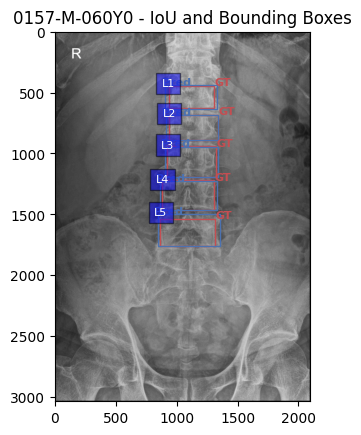

0163-F-053Y0의 클래스 L3에 대한 IOU: 0.85 (Confidence: 0.94)
0163-F-053Y0의 클래스 L2에 대한 IOU: 0.80 (Confidence: 0.92)
0163-F-053Y0의 클래스 L4에 대한 IOU: 0.82 (Confidence: 0.89)
0163-F-053Y0의 클래스 L5에 대한 IOU: 0.84 (Confidence: 0.86)
0163-F-053Y0의 클래스 L1에 대한 IOU: 0.84 (Confidence: 0.86)


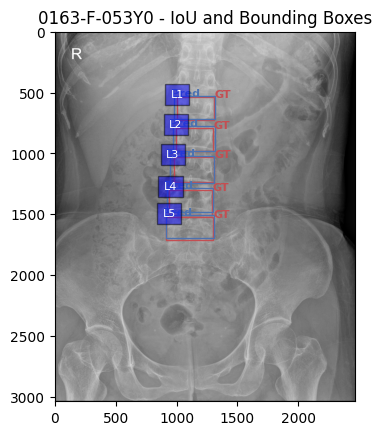

0164-F-064Y0의 클래스 L3에 대한 IOU: 0.81 (Confidence: 0.93)
0164-F-064Y0의 클래스 L4에 대한 IOU: 0.91 (Confidence: 0.92)
0164-F-064Y0의 클래스 L5에 대한 IOU: 0.80 (Confidence: 0.89)
0164-F-064Y0의 클래스 L2에 대한 IOU: 0.76 (Confidence: 0.86)
0164-F-064Y0의 클래스 L1에 대한 IOU: 0.81 (Confidence: 0.86)
0164-F-064Y0의 클래스 L1에 대한 IOU: 0.00 (Confidence: 0.73)


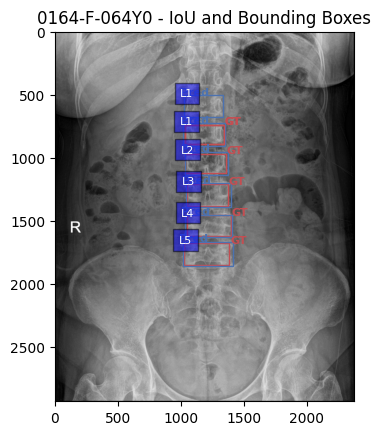

0165-M-078Y0의 클래스 L3에 대한 IOU: 0.84 (Confidence: 0.93)
0165-M-078Y0의 클래스 L4에 대한 IOU: 0.76 (Confidence: 0.92)
0165-M-078Y0의 클래스 L2에 대한 IOU: 0.85 (Confidence: 0.92)
0165-M-078Y0의 클래스 L1에 대한 IOU: 0.85 (Confidence: 0.88)
0165-M-078Y0의 클래스 L5에 대한 IOU: 0.51 (Confidence: 0.86)


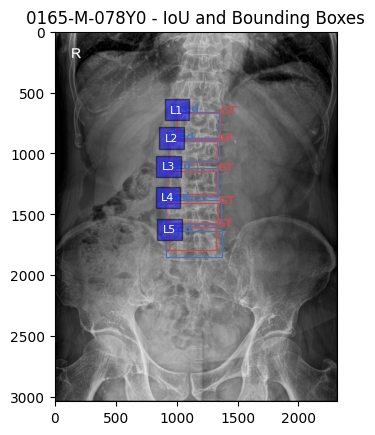

0166-F-071Y0의 클래스 L1에 대한 IOU: 0.84 (Confidence: 0.90)
0166-F-071Y0의 클래스 L2에 대한 IOU: 0.88 (Confidence: 0.90)
0166-F-071Y0의 클래스 L3에 대한 IOU: 0.87 (Confidence: 0.86)
0166-F-071Y0의 클래스 L3에 대한 IOU: 0.00 (Confidence: 0.83)
0166-F-071Y0의 클래스 L5에 대한 IOU: 0.88 (Confidence: 0.71)


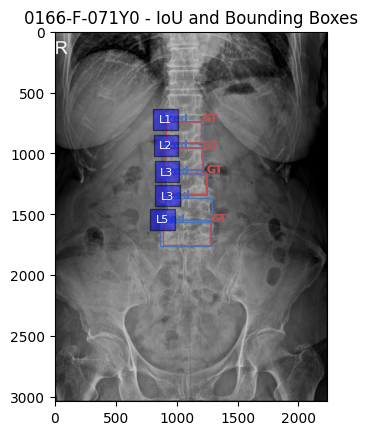

0167-F-049Y0의 클래스 L1에 대한 IOU: 0.90 (Confidence: 0.94)
0167-F-049Y0의 클래스 L3에 대한 IOU: 0.85 (Confidence: 0.94)
0167-F-049Y0의 클래스 L2에 대한 IOU: 0.90 (Confidence: 0.93)
0167-F-049Y0의 클래스 L4에 대한 IOU: 0.83 (Confidence: 0.89)
0167-F-049Y0의 클래스 L5에 대한 IOU: 0.95 (Confidence: 0.89)


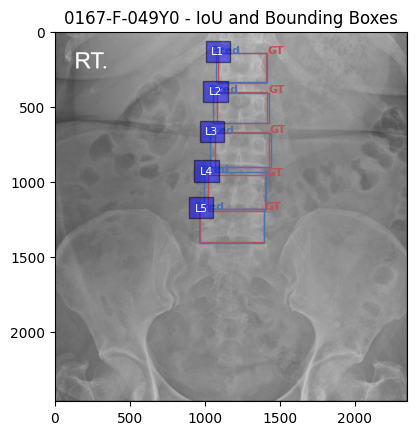

0168-M-055Y0의 클래스 L3에 대한 IOU: 0.69 (Confidence: 0.94)
0168-M-055Y0의 클래스 L2에 대한 IOU: 0.68 (Confidence: 0.93)
0168-M-055Y0의 클래스 L4에 대한 IOU: 0.57 (Confidence: 0.91)
0168-M-055Y0의 클래스 L1에 대한 IOU: 0.78 (Confidence: 0.89)
0168-M-055Y0의 클래스 L5에 대한 IOU: 0.65 (Confidence: 0.85)


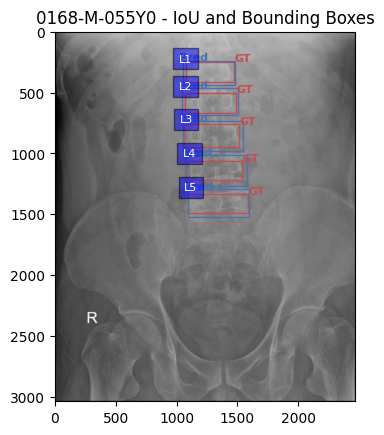

0173-F-079Y0의 클래스 L3에 대한 IOU: 0.28 (Confidence: 0.94)
0173-F-079Y0의 클래스 L4에 대한 IOU: 0.53 (Confidence: 0.91)
0173-F-079Y0의 클래스 L2에 대한 IOU: 0.16 (Confidence: 0.91)
0173-F-079Y0의 클래스 L1에 대한 IOU: 0.60 (Confidence: 0.90)
0173-F-079Y0의 클래스 L5에 대한 IOU: 0.64 (Confidence: 0.80)


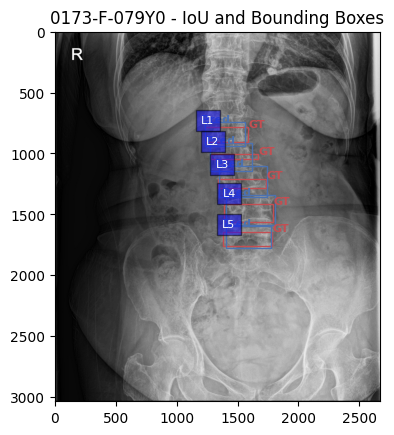

0174-M-063Y0의 클래스 L4에 대한 IOU: 0.73 (Confidence: 0.95)
0174-M-063Y0의 클래스 L3에 대한 IOU: 0.80 (Confidence: 0.93)
0174-M-063Y0의 클래스 L2에 대한 IOU: 0.92 (Confidence: 0.92)
0174-M-063Y0의 클래스 L1에 대한 IOU: 0.92 (Confidence: 0.90)
0174-M-063Y0의 클래스 L5에 대한 IOU: 0.67 (Confidence: 0.80)


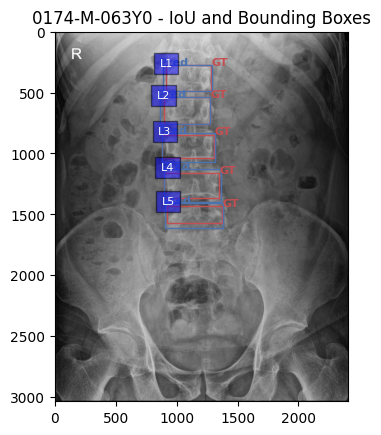

0175-M-053Y0의 클래스 L4에 대한 IOU: 0.89 (Confidence: 0.94)
0175-M-053Y0의 클래스 L2에 대한 IOU: 0.84 (Confidence: 0.94)
0175-M-053Y0의 클래스 L3에 대한 IOU: 0.90 (Confidence: 0.93)
0175-M-053Y0의 클래스 L1에 대한 IOU: 0.85 (Confidence: 0.89)
0175-M-053Y0의 클래스 L5에 대한 IOU: 0.81 (Confidence: 0.84)


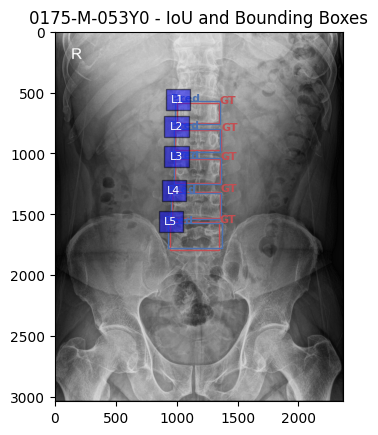

0180-M-082Y0의 클래스 L4에 대한 IOU: 0.56 (Confidence: 0.93)
0180-M-082Y0의 클래스 L3에 대한 IOU: 0.75 (Confidence: 0.93)
0180-M-082Y0의 클래스 L2에 대한 IOU: 0.77 (Confidence: 0.88)
0180-M-082Y0의 클래스 L5에 대한 IOU: 0.52 (Confidence: 0.85)
0180-M-082Y0의 클래스 L1에 대한 IOU: 0.59 (Confidence: 0.85)


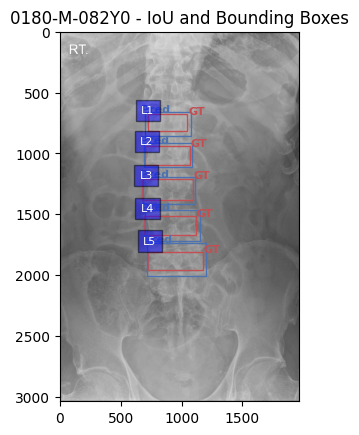

0183-F-080Y0의 클래스 L4에 대한 IOU: 0.89 (Confidence: 0.92)
0183-F-080Y0의 클래스 L3에 대한 IOU: 0.84 (Confidence: 0.92)
0183-F-080Y0의 클래스 L2에 대한 IOU: 0.61 (Confidence: 0.89)
0183-F-080Y0의 클래스 L5에 대한 IOU: 0.84 (Confidence: 0.89)
0183-F-080Y0의 클래스 L1에 대한 IOU: 0.67 (Confidence: 0.87)


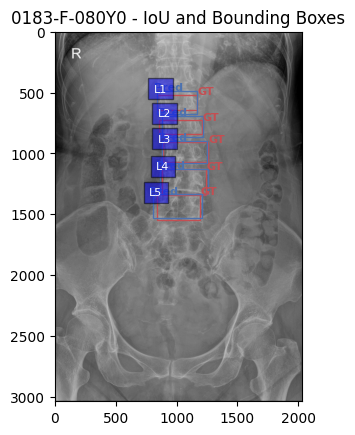

0185-F-073Y0의 클래스 L3에 대한 IOU: 0.85 (Confidence: 0.93)
0185-F-073Y0의 클래스 L2에 대한 IOU: 0.85 (Confidence: 0.91)
0185-F-073Y0의 클래스 L4에 대한 IOU: 0.80 (Confidence: 0.89)
0185-F-073Y0의 클래스 L1에 대한 IOU: 0.91 (Confidence: 0.88)
0185-F-073Y0의 클래스 L5에 대한 IOU: 0.63 (Confidence: 0.80)
0185-F-073Y0의 클래스 L5에 대한 IOU: 0.70 (Confidence: 0.72)


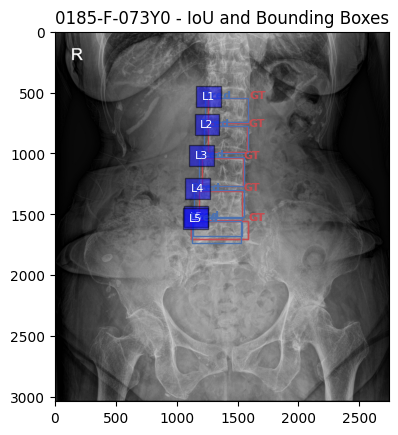

0188-F-066Y0의 클래스 L4에 대한 IOU: 0.86 (Confidence: 0.94)
0188-F-066Y0의 클래스 L3에 대한 IOU: 0.86 (Confidence: 0.93)
0188-F-066Y0의 클래스 L2에 대한 IOU: 0.85 (Confidence: 0.92)
0188-F-066Y0의 클래스 L1에 대한 IOU: 0.78 (Confidence: 0.88)
0188-F-066Y0의 클래스 L5에 대한 IOU: 0.63 (Confidence: 0.86)


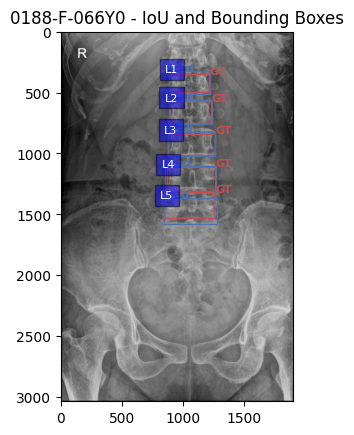

0189-M-068Y0의 클래스 L3에 대한 IOU: 0.81 (Confidence: 0.93)
0189-M-068Y0의 클래스 L2에 대한 IOU: 0.82 (Confidence: 0.92)
0189-M-068Y0의 클래스 L4에 대한 IOU: 0.92 (Confidence: 0.91)
0189-M-068Y0의 클래스 L1에 대한 IOU: 0.82 (Confidence: 0.91)
0189-M-068Y0의 클래스 L5에 대한 IOU: 0.77 (Confidence: 0.91)


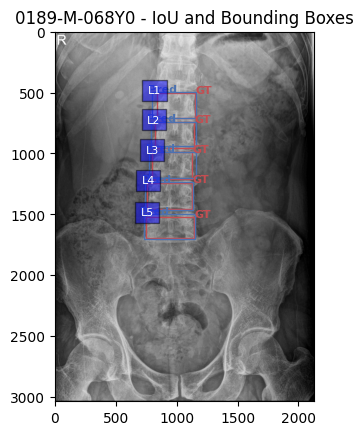

0195-F-064Y0의 클래스 L3에 대한 IOU: 0.86 (Confidence: 0.94)
0195-F-064Y0의 클래스 L4에 대한 IOU: 0.87 (Confidence: 0.94)
0195-F-064Y0의 클래스 L2에 대한 IOU: 0.79 (Confidence: 0.93)
0195-F-064Y0의 클래스 L5에 대한 IOU: 0.81 (Confidence: 0.89)
0195-F-064Y0의 클래스 L1에 대한 IOU: 0.74 (Confidence: 0.88)


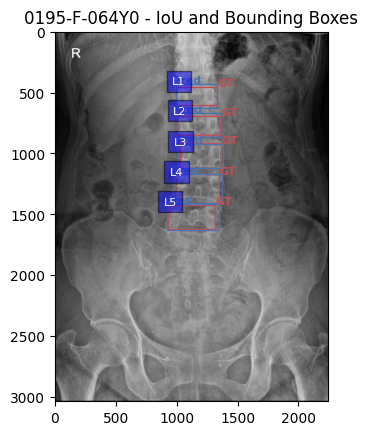

0196-F-051Y0의 클래스 L2에 대한 IOU: 0.76 (Confidence: 0.94)
0196-F-051Y0의 클래스 L4에 대한 IOU: 0.85 (Confidence: 0.94)
0196-F-051Y0의 클래스 L1에 대한 IOU: 0.80 (Confidence: 0.93)
0196-F-051Y0의 클래스 L3에 대한 IOU: 0.80 (Confidence: 0.93)
0196-F-051Y0의 클래스 L5에 대한 IOU: 0.75 (Confidence: 0.88)


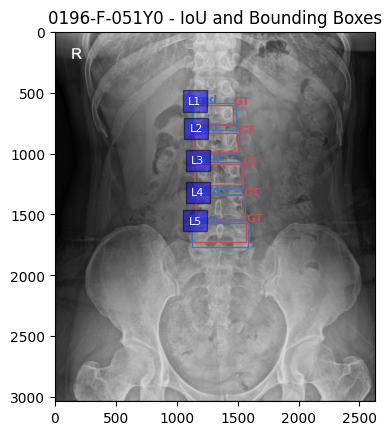

0197-F-077Y0의 클래스 L3에 대한 IOU: 0.69 (Confidence: 0.94)
0197-F-077Y0의 클래스 L4에 대한 IOU: 0.71 (Confidence: 0.90)
0197-F-077Y0의 클래스 L2에 대한 IOU: 0.71 (Confidence: 0.89)
0197-F-077Y0의 클래스 L5에 대한 IOU: 0.90 (Confidence: 0.82)
0197-F-077Y0의 클래스 L1에 대한 IOU: 0.83 (Confidence: 0.69)


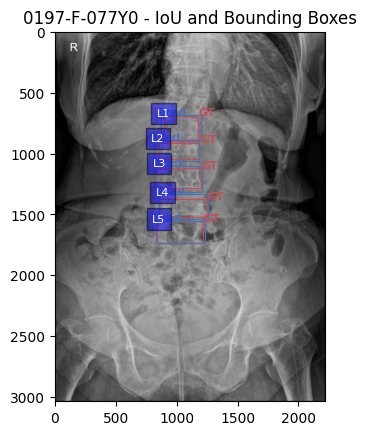

0202-F-068Y0의 클래스 L3에 대한 IOU: 0.85 (Confidence: 0.94)
0202-F-068Y0의 클래스 L4에 대한 IOU: 0.91 (Confidence: 0.93)
0202-F-068Y0의 클래스 L2에 대한 IOU: 0.83 (Confidence: 0.92)
0202-F-068Y0의 클래스 L1에 대한 IOU: 0.85 (Confidence: 0.92)
0202-F-068Y0의 클래스 L5에 대한 IOU: 0.53 (Confidence: 0.85)


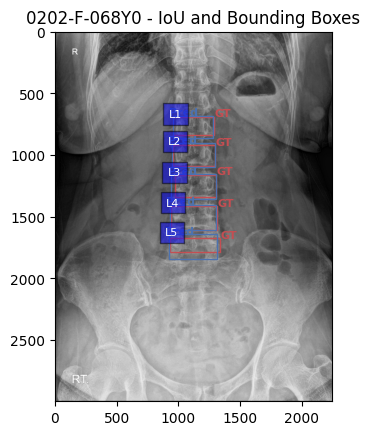

0205-M-063Y0의 클래스 L4에 대한 IOU: 0.72 (Confidence: 0.93)
0205-M-063Y0의 클래스 L5에 대한 IOU: 0.77 (Confidence: 0.90)
0205-M-063Y0의 클래스 L3에 대한 IOU: 0.40 (Confidence: 0.88)
0205-M-063Y0의 클래스 L2에 대한 IOU: 0.56 (Confidence: 0.86)
0205-M-063Y0의 클래스 L1에 대한 IOU: 0.40 (Confidence: 0.81)


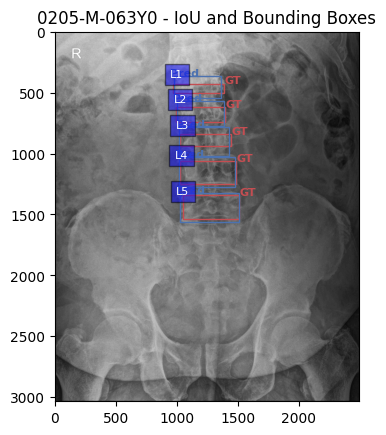

0206-F-070Y0의 클래스 L3에 대한 IOU: 0.86 (Confidence: 0.93)
0206-F-070Y0의 클래스 L4에 대한 IOU: 0.82 (Confidence: 0.93)
0206-F-070Y0의 클래스 L5에 대한 IOU: 0.66 (Confidence: 0.85)
0206-F-070Y0의 클래스 L1에 대한 IOU: 0.70 (Confidence: 0.81)
0206-F-070Y0의 클래스 L2에 대한 IOU: 0.58 (Confidence: 0.80)


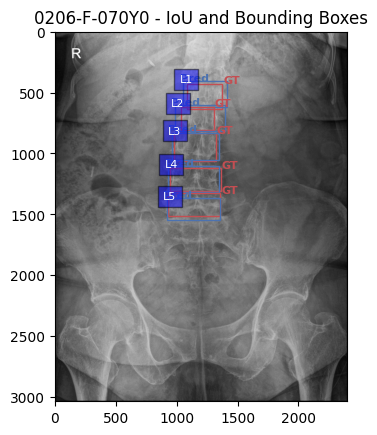

0209-M-072Y0의 클래스 L2에 대한 IOU: 0.72 (Confidence: 0.92)
0209-M-072Y0의 클래스 L4에 대한 IOU: 0.86 (Confidence: 0.92)
0209-M-072Y0의 클래스 L3에 대한 IOU: 0.83 (Confidence: 0.91)
0209-M-072Y0의 클래스 L1에 대한 IOU: 0.82 (Confidence: 0.88)
0209-M-072Y0의 클래스 L5에 대한 IOU: 0.73 (Confidence: 0.77)


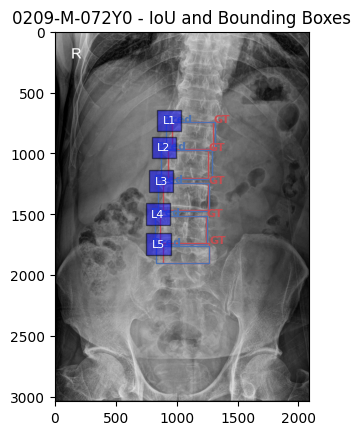

0211-F-055Y0의 클래스 L4에 대한 IOU: 0.87 (Confidence: 0.93)
0211-F-055Y0의 클래스 L3에 대한 IOU: 0.84 (Confidence: 0.93)
0211-F-055Y0의 클래스 L2에 대한 IOU: 0.88 (Confidence: 0.91)
0211-F-055Y0의 클래스 L1에 대한 IOU: 0.85 (Confidence: 0.90)
0211-F-055Y0의 클래스 L5에 대한 IOU: 0.47 (Confidence: 0.87)


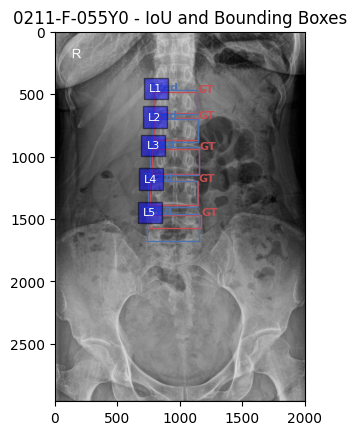

0214-F-072Y0의 클래스 L4에 대한 IOU: 0.71 (Confidence: 0.93)
0214-F-072Y0의 클래스 L3에 대한 IOU: 0.63 (Confidence: 0.93)
0214-F-072Y0의 클래스 L2에 대한 IOU: 0.67 (Confidence: 0.92)
0214-F-072Y0의 클래스 L1에 대한 IOU: 0.81 (Confidence: 0.89)
0214-F-072Y0의 클래스 L5에 대한 IOU: 0.80 (Confidence: 0.86)


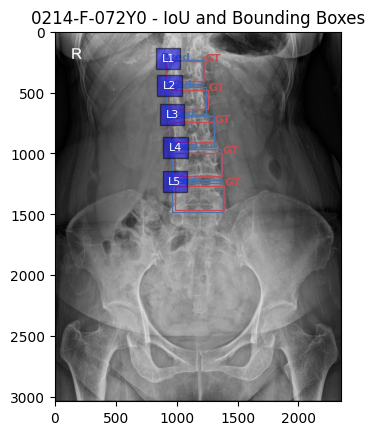

0220-F-069Y0의 클래스 L3에 대한 IOU: 0.00 (Confidence: 0.93)
0220-F-069Y0의 클래스 L4에 대한 IOU: 0.00 (Confidence: 0.90)
0220-F-069Y0의 클래스 L5에 대한 IOU: 0.00 (Confidence: 0.88)
0220-F-069Y0의 클래스 L3에 대한 IOU: 0.53 (Confidence: 0.87)
0220-F-069Y0의 클래스 L2에 대한 IOU: 0.83 (Confidence: 0.86)
0220-F-069Y0의 클래스 L1에 대한 IOU: 0.00 (Confidence: 0.65)


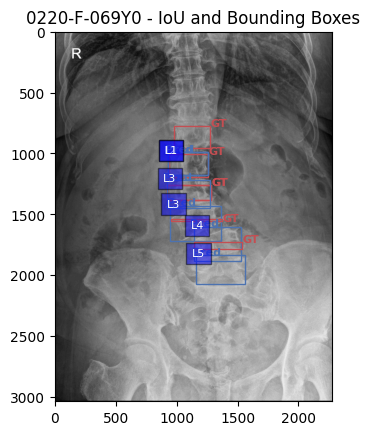

0223-F-063Y0의 클래스 L3에 대한 IOU: 0.11 (Confidence: 0.94)
0223-F-063Y0의 클래스 L1에 대한 IOU: 0.20 (Confidence: 0.90)
0223-F-063Y0의 클래스 L4에 대한 IOU: 0.55 (Confidence: 0.88)
0223-F-063Y0의 클래스 L2에 대한 IOU: 0.12 (Confidence: 0.88)
0223-F-063Y0의 클래스 L5에 대한 IOU: 0.81 (Confidence: 0.87)


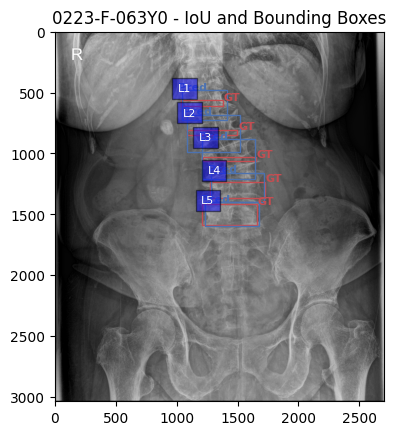

0225-M-086Y0의 클래스 L1에 대한 IOU: 0.71 (Confidence: 0.93)
0225-M-086Y0의 클래스 L3에 대한 IOU: 0.62 (Confidence: 0.93)
0225-M-086Y0의 클래스 L2에 대한 IOU: 0.56 (Confidence: 0.91)
0225-M-086Y0의 클래스 L4에 대한 IOU: 0.66 (Confidence: 0.89)
0225-M-086Y0의 클래스 L5에 대한 IOU: 0.77 (Confidence: 0.81)


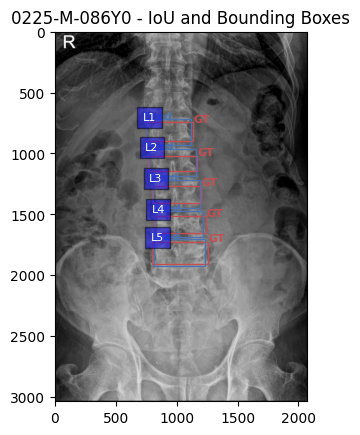

0226-M-060Y0의 클래스 L3에 대한 IOU: 0.83 (Confidence: 0.93)
0226-M-060Y0의 클래스 L2에 대한 IOU: 0.65 (Confidence: 0.93)
0226-M-060Y0의 클래스 L4에 대한 IOU: 0.84 (Confidence: 0.90)
0226-M-060Y0의 클래스 L1에 대한 IOU: 0.85 (Confidence: 0.88)
0226-M-060Y0의 클래스 L5에 대한 IOU: 0.81 (Confidence: 0.87)


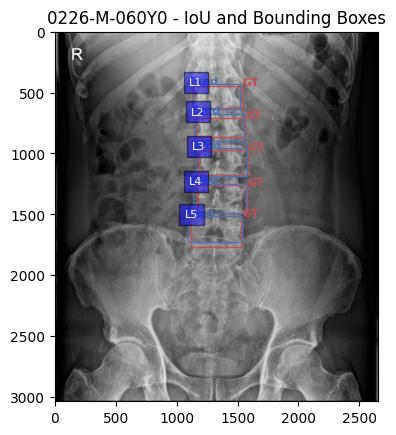

0228-F-057Y0의 클래스 L3에 대한 IOU: 0.76 (Confidence: 0.94)
0228-F-057Y0의 클래스 L4에 대한 IOU: 0.83 (Confidence: 0.93)
0228-F-057Y0의 클래스 L2에 대한 IOU: 0.73 (Confidence: 0.89)
0228-F-057Y0의 클래스 L5에 대한 IOU: 0.90 (Confidence: 0.88)
0228-F-057Y0의 클래스 L1에 대한 IOU: 0.69 (Confidence: 0.86)


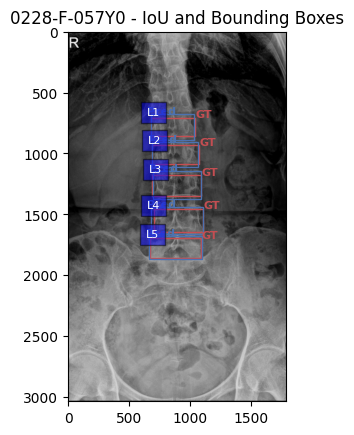

0229-F-078Y0의 클래스 L1에 대한 IOU: 0.58 (Confidence: 0.91)
0229-F-078Y0의 클래스 L3에 대한 IOU: 0.78 (Confidence: 0.88)
0229-F-078Y0의 클래스 L4에 대한 IOU: 0.46 (Confidence: 0.85)
0229-F-078Y0의 클래스 L3에 대한 IOU: 0.00 (Confidence: 0.83)
0229-F-078Y0의 클래스 L4에 대한 IOU: 0.00 (Confidence: 0.73)
0229-F-078Y0의 클래스 L2에 대한 IOU: 0.56 (Confidence: 0.70)
0229-F-078Y0의 클래스 L5에 대한 IOU: 0.35 (Confidence: 0.68)


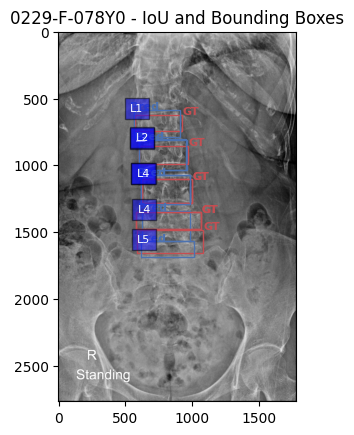

0238-F-067Y0의 클래스 L3에 대한 IOU: 0.45 (Confidence: 0.93)
0238-F-067Y0의 클래스 L4에 대한 IOU: 0.41 (Confidence: 0.92)
0238-F-067Y0의 클래스 L2에 대한 IOU: 0.84 (Confidence: 0.90)
0238-F-067Y0의 클래스 L5에 대한 IOU: 0.66 (Confidence: 0.88)
0238-F-067Y0의 클래스 L1에 대한 IOU: 0.75 (Confidence: 0.87)


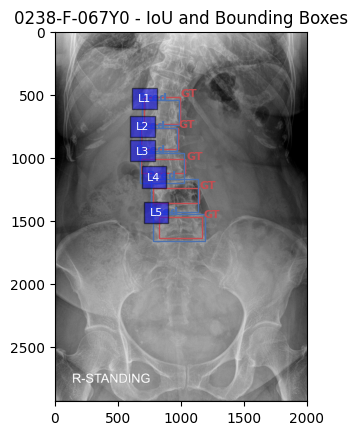

0247-F-063Y0의 클래스 L2에 대한 IOU: 0.88 (Confidence: 0.94)
0247-F-063Y0의 클래스 L4에 대한 IOU: 0.81 (Confidence: 0.93)
0247-F-063Y0의 클래스 L3에 대한 IOU: 0.87 (Confidence: 0.92)
0247-F-063Y0의 클래스 L1에 대한 IOU: 0.93 (Confidence: 0.91)
0247-F-063Y0의 클래스 L5에 대한 IOU: 0.76 (Confidence: 0.88)


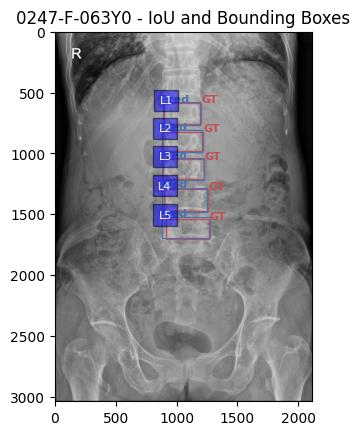

0248-F-058Y0의 클래스 L3에 대한 IOU: 0.80 (Confidence: 0.93)
0248-F-058Y0의 클래스 L4에 대한 IOU: 0.67 (Confidence: 0.92)
0248-F-058Y0의 클래스 L2에 대한 IOU: 0.90 (Confidence: 0.91)
0248-F-058Y0의 클래스 L1에 대한 IOU: 0.81 (Confidence: 0.90)
0248-F-058Y0의 클래스 L5에 대한 IOU: 0.61 (Confidence: 0.88)


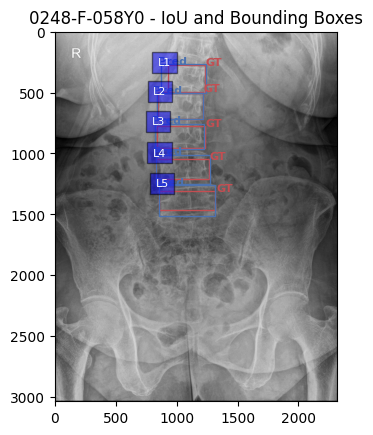

0255-F-053Y0의 클래스 L3에 대한 IOU: 0.86 (Confidence: 0.94)
0255-F-053Y0의 클래스 L2에 대한 IOU: 0.89 (Confidence: 0.93)
0255-F-053Y0의 클래스 L4에 대한 IOU: 0.86 (Confidence: 0.92)
0255-F-053Y0의 클래스 L1에 대한 IOU: 0.90 (Confidence: 0.92)
0255-F-053Y0의 클래스 L5에 대한 IOU: 0.77 (Confidence: 0.90)


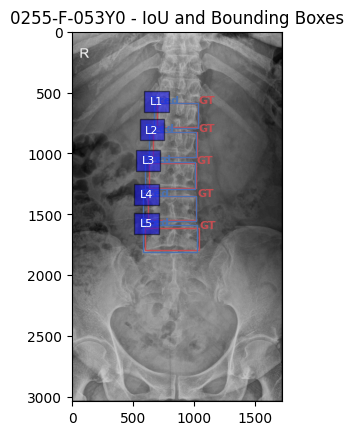

0272-M-035Y0의 클래스 L2에 대한 IOU: 0.74 (Confidence: 0.93)
0272-M-035Y0의 클래스 L4에 대한 IOU: 0.75 (Confidence: 0.93)
0272-M-035Y0의 클래스 L3에 대한 IOU: 0.70 (Confidence: 0.93)
0272-M-035Y0의 클래스 L1에 대한 IOU: 0.79 (Confidence: 0.92)
0272-M-035Y0의 클래스 L5에 대한 IOU: 0.66 (Confidence: 0.79)


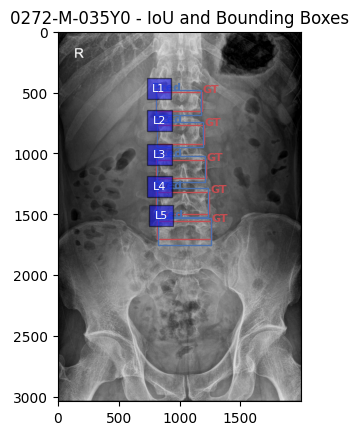

0279-M-043Y0의 클래스 L3에 대한 IOU: 0.86 (Confidence: 0.93)
0279-M-043Y0의 클래스 L4에 대한 IOU: 0.92 (Confidence: 0.93)
0279-M-043Y0의 클래스 L1에 대한 IOU: 0.92 (Confidence: 0.93)
0279-M-043Y0의 클래스 L2에 대한 IOU: 0.88 (Confidence: 0.92)
0279-M-043Y0의 클래스 L5에 대한 IOU: 0.90 (Confidence: 0.88)


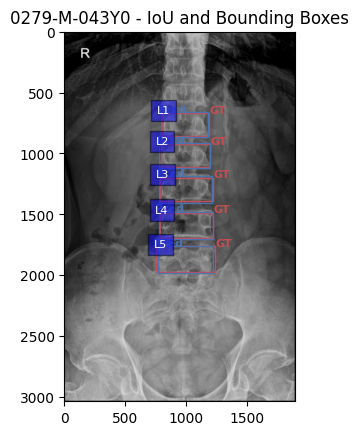

0379-M-040Y0의 클래스 L2에 대한 IOU: 0.90 (Confidence: 0.95)
0379-M-040Y0의 클래스 L4에 대한 IOU: 0.90 (Confidence: 0.93)
0379-M-040Y0의 클래스 L3에 대한 IOU: 0.92 (Confidence: 0.93)
0379-M-040Y0의 클래스 L1에 대한 IOU: 0.90 (Confidence: 0.90)
0379-M-040Y0의 클래스 L5에 대한 IOU: 0.88 (Confidence: 0.83)


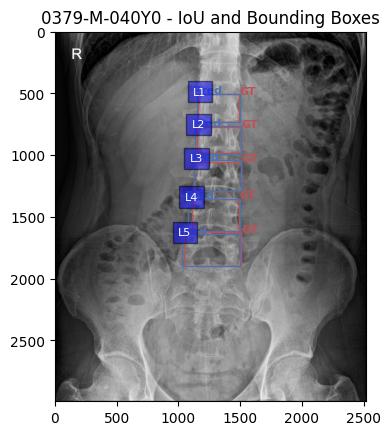

0391-M-046Y0의 클래스 L2에 대한 IOU: 0.86 (Confidence: 0.94)
0391-M-046Y0의 클래스 L3에 대한 IOU: 0.94 (Confidence: 0.93)
0391-M-046Y0의 클래스 L1에 대한 IOU: 0.62 (Confidence: 0.91)
0391-M-046Y0의 클래스 L4에 대한 IOU: 0.87 (Confidence: 0.76)
0391-M-046Y0의 클래스 L5에 대한 IOU: 0.02 (Confidence: 0.67)


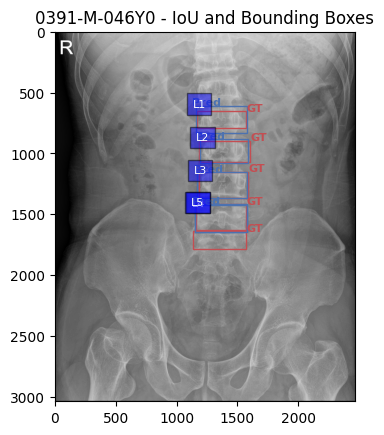

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image

# 클래스 이름 정의
class_labels = {0: 'L1', 1: 'L2', 2: 'L3', 3: 'L4', 4: 'L5'}

iou_threshold = 0.6  # 신뢰도 임계값 (confidence score)

for result in results:
    preds = result.boxes.xyxy.cpu().numpy()  # 예측된 바운딩 박스 좌표
    pred_classes_batch = result.boxes.cls.cpu().numpy()  # 예측된 클래스
    confidences_batch = result.boxes.conf.cpu().numpy()  # 예측된 confidence score
    image_path = result.path
    image_name = os.path.basename(image_path)
    image_name_no_ext = os.path.splitext(image_name)[0]

    # 이미지를 로드
    img = Image.open(image_path)

    gt_row = ap_df[ap_df['filename'] == image_name_no_ext]
    if not gt_row.empty:
        gt_boxes = {}
        for i in range(1, 6):  # 각 클래스의 실제 바운딩 박스 정보 가져오기
            gt_box = [
                gt_row[f'L{i}a_1c'].values[0],
                gt_row[f'L{i}a_1r'].values[0],
                gt_row[f'L{i}b_2c'].values[0],
                gt_row[f'L{i}b_2r'].values[0]
            ]
            gt_boxes[i - 1] = gt_box

        # 이미지 시각화 준비
        fig, ax = plt.subplots(1)
        ax.imshow(img, cmap='gray')  # 이미지를 흑백으로 표시

        # 예측된 바운딩 박스와 ground truth 바운딩 박스를 그려줌
        for pred_box, pred_class, conf in zip(preds, pred_classes_batch, confidences_batch):
            if conf >= iou_threshold:  # 신뢰도 임계값 0.6 이상인 경우만 처리
                if pred_class in gt_boxes:
                    gt_box = gt_boxes[pred_class]
                    iou_value = calculate_iou(gt_box, pred_box)

                    # Ground truth 박스 그리기 (빨간색) 및 'GT' 레이블 추가
                    gt_rect = patches.Rectangle((gt_box[0], gt_box[1]), gt_box[2] - gt_box[0], gt_box[3] - gt_box[1],
                                                linewidth=1, edgecolor='r', facecolor='none')  # 선 굵기를 1로 줄임
                    ax.add_patch(gt_rect)
                    ax.text(gt_box[2] + 5, gt_box[1], 'GT', color='r', fontsize=8, fontweight='bold')  # GT 글씨를 박스 우측으로 이동

                    # 예측 박스 그리기 (파란색) 및 'Pred' 레이블 추가
                    pred_rect = patches.Rectangle((pred_box[0], pred_box[1]), pred_box[2] - pred_box[0], pred_box[3] - pred_box[1],
                                                  linewidth=1, edgecolor='b', facecolor='none')  # 선 굵기를 1로 줄임
                    ax.add_patch(pred_rect)
                    ax.text(pred_box[0] - 30, pred_box[1], 'Pred', color='b', fontsize=8, fontweight='bold')  # Pred 글씨를 박스 좌측으로 이동

                    # 클래스 이름 추가 (예: L1, L2 등)
                    class_label = class_labels.get(int(pred_class), 'Unknown')
                    ax.text(pred_box[0] - 30, pred_box[1] + 10, class_label, color='white', fontsize=8, bbox=dict(facecolor='blue', alpha=0.5))

                    # IoU 값을 출력
                    print(f"{image_name_no_ext}의 클래스 {class_label}에 대한 IOU: {iou_value:.2f} (Confidence: {conf:.2f})")

        # 이미지 출력
        plt.title(f"{image_name_no_ext} - IoU and Bounding Boxes")
        plt.show()


In [ ]:
from collections import defaultdict
import numpy as np

iou_threshold = 0.6  # 신뢰도 임계값 (confidence score)

iou_dict = defaultdict(list)  # 클래스별 IoU 값을 저장할 딕셔너리

for result in results:
    preds = result.boxes.xyxy.cpu().numpy()  # 예측된 바운딩 박스 좌표
    pred_classes_batch = result.boxes.cls.cpu().numpy()  # 예측된 클래스
    confidences_batch = result.boxes.conf.cpu().numpy()  # 예측된 confidence score
    image_path = result.path
    image_name = os.path.basename(image_path)
    image_name_no_ext = os.path.splitext(image_name)[0]

    gt_row = ap_df[ap_df['filename'] == image_name_no_ext]
    if not gt_row.empty:
        gt_boxes = {}
        for i in range(1, 6):  # 각 클래스의 실제 바운딩 박스 정보 가져오기
            gt_box = [
                gt_row[f'L{i}a_1c'].values[0],
                gt_row[f'L{i}a_1r'].values[0],
                gt_row[f'L{i}b_2c'].values[0],
                gt_row[f'L{i}b_2r'].values[0]
            ]
            gt_boxes[i - 1] = gt_box

        for pred_box, pred_class, conf in zip(preds, pred_classes_batch, confidences_batch):
            if conf >= iou_threshold:  # 신뢰도 임계값 0.6 이상인 경우만 처리
                if pred_class in gt_boxes:
                    gt_box = gt_boxes[pred_class]
                    iou_value = calculate_iou(gt_box, pred_box)
                    iou_dict[pred_class].append(iou_value)  # 클래스별로 IoU 값을 저장

# 각 클래스별로 IoU 값의 평균을 계산
for class_id, iou_list in iou_dict.items():
    if iou_list:  # IoU 리스트가 비어있지 않다면 평균을 계산
        mean_iou = np.mean(iou_list)
        print(f"클래스 {class_id}에 대한 평균 IOU: {mean_iou:.4f}")


클래스 2.0에 대한 평균 IOU: 0.7200
클래스 3.0에 대한 평균 IOU: 0.7192
클래스 1.0에 대한 평균 IOU: 0.7455
클래스 0.0에 대한 평균 IOU: 0.7291
클래스 4.0에 대한 평균 IOU: 0.7365


In [ ]:
import pandas as pd

iou_threshold = 0.6  # 원하는 신뢰도 임계값

# 결과를 저장할 리스트
image_data = []

for result in results:
    preds = result.boxes.xyxy.cpu().numpy()  # 예측된 바운딩 박스 좌표
    pred_classes_batch = result.boxes.cls.cpu().numpy()  # 예측 클래스
    confidences_batch = result.boxes.conf.cpu().numpy()  # confidence score
    image_path = result.path
    image_name = os.path.basename(image_path)
    image_name_no_ext = os.path.splitext(image_name)[0]

    # Ground truth 데이터 가져오기
    gt_row = ap_df[ap_df['filename'] == image_name_no_ext]
    if not gt_row.empty:
        gt_boxes = {}
        for i in range(1, 6):  # 클래스 번호 0~4로 저장
            gt_box = [
                gt_row[f'L{i}a_1c'].values[0],
                gt_row[f'L{i}a_1r'].values[0],
                gt_row[f'L{i}b_2c'].values[0],
                gt_row[f'L{i}b_2r'].values[0]
            ]
            gt_boxes[i - 1] = gt_box

        # 클래스별로 최대 IOU에 해당하는 confidence 저장
        class_confidences = {i: (-1, -1) for i in range(5)}  # 클래스별 (최대 iou, confidence)

        for pred_box, pred_class, conf in zip(preds, pred_classes_batch, confidences_batch):
            if conf >= iou_threshold:  # confidence가 0.6 이상일 경우에만 처리
                if pred_class in gt_boxes:
                    gt_box = gt_boxes[pred_class]
                    iou_value = calculate_iou(gt_box, pred_box)

                    # 더 큰 IOU 값을 가진 경우에만 confidence를 업데이트
                    if iou_value > class_confidences[pred_class][0]:
                        class_confidences[pred_class] = (iou_value, conf)

        # 각 이미지에 대한 결과 저장
        image_data.append([image_name_no_ext] + [class_confidences[i][1] for i in range(5)])

# DataFrame 생성
columns = ['image_name'] + [str(i) for i in range(5)]
confidence_df = pd.DataFrame(image_data, columns=columns)

# DataFrame을 CSV 파일로 저장
csv_file_path = '/content/drive/MyDrive/IOU_YOLO+RCNN/confidence_by_class.csv'
confidence_df.to_csv(csv_file_path, index=False)

print(f"CSV 파일이 {csv_file_path} 경로에 저장되었습니다.")


CSV 파일이 /content/drive/MyDrive/IOU_YOLO+RCNN/confidence_by_class.csv 경로에 저장되었습니다.


In [ ]:
# 블록 2: IOU 값의 히스토그램 시각화
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.hist(iou_values, bins=20, edgecolor='black', alpha=0.7)
plt.title('IOU Value Distribution')
plt.xlabel('IOU Value')
plt.ylabel('Frequency')
plt.axvline(x=0.6, color='red', linestyle='--', label='Threshold = 0.6')
plt.legend()
plt.grid()
plt.show()

In [ ]:
# 블록 3: 0.6보다 낮은 IOU 값 찾기
low_iou_results = [(image_name, pred_class, iou_value)
                   for (image_name, pred_class, iou_value)
                   in zip(image_names, pred_classes, iou_values)
                   if iou_value < 0.4]

# 낮은 IOU 값을 가진 결과 출력
if low_iou_results:
    print("IOU 값이 0.4보다 낮은 결과:")
    for image_name, pred_class, iou_value in low_iou_results:
        print(f"이미지: {image_name}, 클래스: {pred_class}, IOU: {iou_value}")
else:
    print("모든 IOU 값이 0.4 이상입니다.")